### Importing Libraries

In [1]:
%matplotlib inline

import numpy as np 
import pandas as pd
from IPython.display import display, HTML , Markdown
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter('ignore')
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from statsmodels.graphics.tsaplots import plot_acf , plot_pacf
import math 
from datetime import datetime
import calendar
from statsmodels.tsa.stattools import adfuller 
from statsmodels.tsa.stattools import kpss
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.vector_ar.vecm import coint_johansen

In [2]:
import matplotlib as mpl
from statsmodels.tsa.seasonal import seasonal_decompose
from pylab import rcParams
mpl.rcParams['agg.path.chunksize'] = 10000
rcParams['figure.figsize'] = 20, 15

In [3]:
store_df = pd.read_csv("store.csv")
train_df = pd.read_csv("train.csv")

In [4]:
store_train_df = pd.merge(store_df , train_df,on='Store' )
selected_store_ids = [1,3,8,9,13,25,29,31,46]
store_train_df = store_train_df.loc[store_train_df['Store'].isin(selected_store_ids)]

In [5]:
store_train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8110 entries, 0 to 42043
Data columns (total 18 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Store                      8110 non-null   int64  
 1   StoreType                  8110 non-null   object 
 2   Assortment                 8110 non-null   object 
 3   CompetitionDistance        8110 non-null   float64
 4   CompetitionOpenSinceMonth  6410 non-null   float64
 5   CompetitionOpenSinceYear   6410 non-null   float64
 6   Promo2                     8110 non-null   int64  
 7   Promo2SinceWeek            2458 non-null   float64
 8   Promo2SinceYear            2458 non-null   float64
 9   PromoInterval              2458 non-null   object 
 10  DayOfWeek                  8110 non-null   int64  
 11  Date                       8110 non-null   object 
 12  Sales                      8110 non-null   int64  
 13  Customers                  8110 non-null   int6

In [6]:
store_train_df.describe([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])

,Store,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday
count,8110.000000,8110.000000,6410.000000,6410.000000,8110.000000,2458.000000,2458.000000,8110.000000,8110.000000,8110.000000,8110.000000,8110.000000,8110.000000
mean,17.826634,4479.442663,8.412168,2006.910452,0.303083,23.559805,2010.383238,3.998520,5394.031566,590.330210,0.823798,0.381258,0.177435
std,13.989612,4714.857046,2.352367,4.603190,0.459619,14.319480,0.923837,1.997532,3455.976814,421.269874,0.381016,0.485726,0.382060
min,1.000000,310.000000,4.000000,2000.000000,0.000000,14.000000,2009.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10%,1.000000,430.000000,4.000000,2000.000000,0.000000,14.000000,2009.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
20%,3.000000,430.000000,7.000000,2003.000000,0.000000,14.000000,2009.000000,2.000000,3213.000000,313.000000,1.000000,0.000000,0.000000
30%,8.000000,1200.000000,8.000000,2005.000000,0.000000,14.000000,2009.000000,3.000000,4182.400000,471.000000,1.000000,0.000000,0.000000
40%,9.000000,1270.000000,8.000000,2005.000000,0.000000,14.000000,2011.000000,3.000000,4852.000000,527.000000,1.000000,0.000000,0.000000
50%,13.000000,2030.000000,9.000000,2006.000000,0.000000,14.000000,2011.000000,4.000000,5406.000000,573.000000,1.000000,0.000000,0.000000
60%,25.000000,2170.000000,9.000000,2008.000000,0.000000,14.000000,2011.000000,5.000000,5996.000000,625.000000,1.000000,0.000000,0.000000


In [7]:
train_df.tail()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
1017204,1111,2,2013-01-01,0,0,0,0,a,1
1017205,1112,2,2013-01-01,0,0,0,0,a,1
1017206,1113,2,2013-01-01,0,0,0,0,a,1
1017207,1114,2,2013-01-01,0,0,0,0,a,1
1017208,1115,2,2013-01-01,0,0,0,0,a,1


In [8]:
train_df.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1


In [9]:
train_df.describe([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday
count,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06,1.017209e+06
mean,5.584297e+02,3.998341e+00,5.773819e+03,6.331459e+02,8.301067e-01,3.815145e-01,1.786467e-01
std,3.219087e+02,1.997391e+00,3.849926e+03,4.644117e+02,3.755392e-01,4.857586e-01,3.830564e-01
min,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10%,1.120000e+02,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20%,2.250000e+02,2.000000e+00,2.937000e+03,3.250000e+02,1.000000e+00,0.000000e+00,0.000000e+00
30%,3.360000e+02,3.000000e+00,4.233000e+03,4.550000e+02,1.000000e+00,0.000000e+00,0.000000e+00
40%,4.462000e+02,3.000000e+00,5.028000e+03,5.360000e+02,1.000000e+00,0.000000e+00,0.000000e+00
50%,5.580000e+02,4.000000e+00,5.744000e+03,6.090000e+02,1.000000e+00,0.000000e+00,0.000000e+00
60%,6.700000e+02,5.000000e+00,6.486000e+03,6.880000e+02,1.000000e+00,0.000000e+00,0.000000e+00


In [10]:
print("Store DF : ")
print(store_df.isna().sum())
print("Train DF  : ")
print(train_df.isna().sum())

Store DF : 
Store                          0
StoreType                      0
Assortment                     0
CompetitionDistance            3
CompetitionOpenSinceMonth    354
CompetitionOpenSinceYear     354
Promo2                         0
Promo2SinceWeek              544
Promo2SinceYear              544
PromoInterval                544
dtype: int64
Train DF  : 
Store            0
DayOfWeek        0
Date             0
Sales            0
Customers        0
Open             0
Promo            0
StateHoliday     0
SchoolHoliday    0
dtype: int64


In [11]:
def add_month_properties(df):
    df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
    df['Month'] = df['Date'].dt.month
    return df

In [12]:
store_train_df

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN,5,2015-07-31,5263,555,1,1,0,1
1,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN,4,2015-07-30,5020,546,1,1,0,1
2,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN,3,2015-07-29,4782,523,1,1,0,1
3,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN,2,2015-07-28,5011,560,1,1,0,1
4,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN,1,2015-07-27,6102,612,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42039,46,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",6,2013-01-05,4848,651,1,0,0,0
42040,46,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",5,2013-01-04,4125,569,1,0,0,1
42041,46,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",4,2013-01-03,4177,553,1,0,0,1
42042,46,c,a,1200.0,9.0,2005.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",3,2013-01-02,4016,582,1,0,0,1


In [13]:
def add_missing_dates(df):
    idx = pd.date_range('2013-01-01','2015-07-31',freq='D')[::-1]
    dummy_df = df
    dummy_df['date_miss'] = 0
    series = dummy_df[['date_miss','Date']].squeeze()
    dummy_df.drop(['date_miss'],axis=1,inplace = True)
    series['missing_date'] = series[['Date']]
    series.index = pd.DatetimeIndex(series['Date'])
    series = series.reindex(idx, fill_value=1)
    series = series.drop(['Date'],axis=1)
    series.loc[series['missing_date'] == 1,'missing_date'] = series.loc[series['missing_date'] == 1,'missing_date'].index.date
    series = series.reset_index()
    series = series.drop(['index'],axis=1)
    dummy_df_1 = dummy_df.join(series,how="outer")
    dummy_df_1 = dummy_df_1[dummy_df_1['date_miss'] == 1]
    dummy_df = dummy_df.append(dummy_df_1)
    dummy_df['Date'] = dummy_df['Date'].fillna(value=dummy_df['missing_date'])
    dummy_df['Date'] = pd.to_datetime(dummy_df['Date'])
    dummy_df = dummy_df.sort_values(by='Date')
    dummy_df.loc[dummy_df['StateHoliday'] == '0','StateHoliday'] = dummy_df.loc[dummy_df['StateHoliday'] == 0,'StateHoliday']
    dummy_df.drop(['date_miss','missing_date'],axis=1,inplace=True)
    return dummy_df


def single_value_imputation(df , columns):
    for i in columns:
        values = df[i].dropna().unique()
        if(len(values) == 1):
            df[i] = df[i].fillna(value=values[0])
    return df
    
def linear_values_imputation(df , columns):
    for i in columns:
        series_dict = dict(zip(pd.to_datetime(df['Date']).dt.strftime("%Y-%m-%d"),df[i]))
        null_df = df[df[i].isnull()]
        for index, row in null_df.iterrows():
            row_date = pd.to_datetime(row['Date']).strftime("%Y-%m-%d")
            one_year_before_date =( pd.to_datetime(row['Date']) -  pd.DateOffset(years=1)).strftime("%Y-%m-%d")
            one_year_after_date = ( pd.to_datetime(row['Date']) -  pd.DateOffset(years=1)).strftime("%Y-%m-%d")
            default_date = 0
            value = 0
            if one_year_before_date in series_dict and math.isnan(series_dict.get(one_year_before_date)) == False:
                df.at[index,i] = series_dict.get(one_year_before_date)
            elif one_year_after_date in series_dict and math.isnan(series_dict.get(one_year_after_date)) == False:
                 df.at[index,i] = series_dict.get(one_year_after_date)
            else:
                df.at[index,i] =  np.nan    
        df[i]= df[i].interpolate(method='linear')
        df[i] = df[i].fillna(df[i].median())
    return df

def binary_value_imputation(df , columns):
     #= store_df_dict[46][store_df_dict[46]['Promo'].isnull()]
        #now.strftime("%Y-%m-%d)
        #(pd.to_datetime(series.Date) -  pd.DateOffset(years=1)).dt.strftime("%Y-%m-%d")
    for i in columns : 
        series_dict = dict(zip(pd.to_datetime(df['Date']).dt.strftime("%Y-%m-%d"),df[i]))
        null_df = df[df[i].isnull()]
        for index, row in null_df.iterrows():
            row_date = pd.to_datetime(row['Date']).strftime("%Y-%m-%d")
            one_year_before_date =( pd.to_datetime(row['Date']) -  pd.DateOffset(years=1)).strftime("%Y-%m-%d")
            one_year_after_date = ( pd.to_datetime(row['Date']) -  pd.DateOffset(years=1)).strftime("%Y-%m-%d")
            default_date = 0
            value = 0
            if one_year_before_date in series_dict and math.isnan(series_dict.get(one_year_before_date)) == False:
                df.at[index,i] = series_dict.get(one_year_before_date)
            elif one_year_after_date in series_dict and math.isnan(series_dict.get(one_year_after_date)) == False:
                 df.at[index,i] = series_dict.get(one_year_after_date)
            else:
                df.at[index,i] = 0       
    return df

def is_promo_month(df):
    month2str = {1:'Jan', 2:'Feb', 3:'Mar', 4:'Apr', 5:'May', 6:'Jun', 7:'Jul', 8:'Aug', 9:'Sept', 10:'Oct', 11:'Nov', 12:'Dec'}
    df['monthStr'] = df.Month.map(month2str)
    df['Is_Promo_Month'] = 0
    df.loc[df.PromoInterval == 0, 'PromoInterval'] = ''
    for interval in df.PromoInterval.unique():
        if interval != '' and type(interval) != float:
            for month in interval.split(','):
                df.loc[(df.monthStr == month) & (df.PromoInterval == interval), 'Is_Promo_Month'] = 1
    return df
    



def add_date_properties(df):
    df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
    df['index_date'] = pd.to_datetime(df['Date'], errors='coerce')
    df['Year'] = df['Date'].dt.year
    df['Month'] = df['Date'].dt.month
    df['Day'] = df['Date'].dt.day
    df['DayOfWeek'] = df['Date'].dt.dayofweek
    df['WeekOfYear'] = df['Date'].dt.weekofyear
    return df

    

    

Sales and Customer Values Intepolation For Store Id : 1


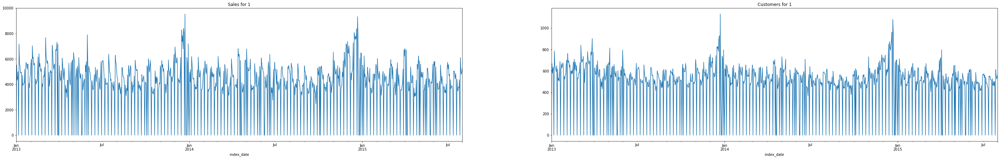

Sales and Customer Values Intepolation For Store Id : 3


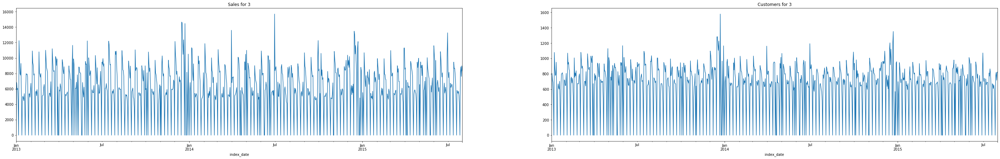

Sales and Customer Values Intepolation For Store Id : 8


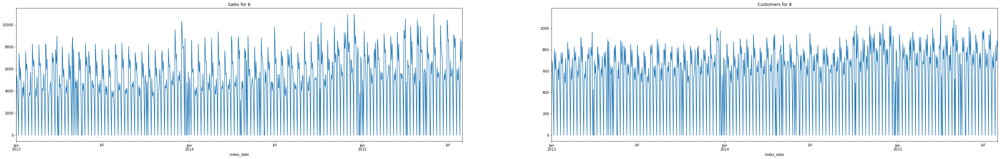

Sales and Customer Values Intepolation For Store Id : 9


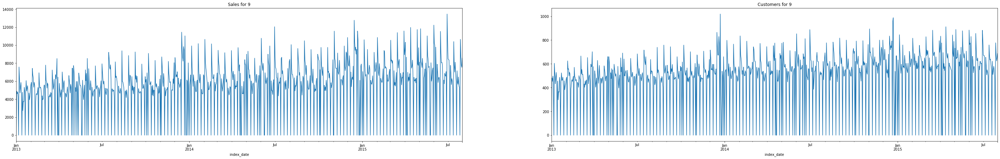

Sales and Customer Values Intepolation For Store Id : 13


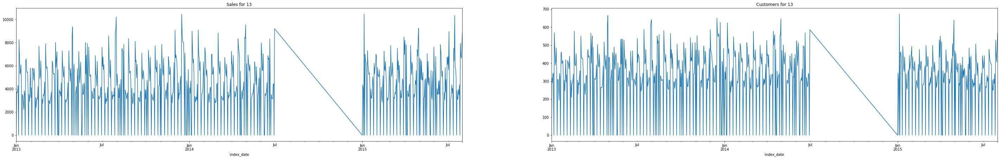

Sales and Customer Values Intepolation For Store Id : 25


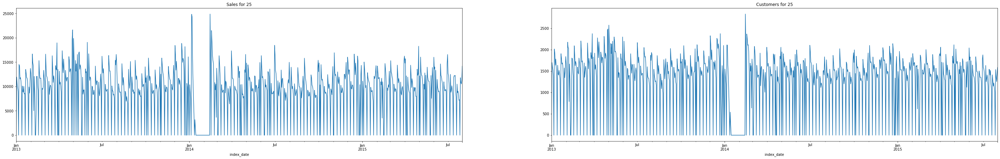

Sales and Customer Values Intepolation For Store Id : 29


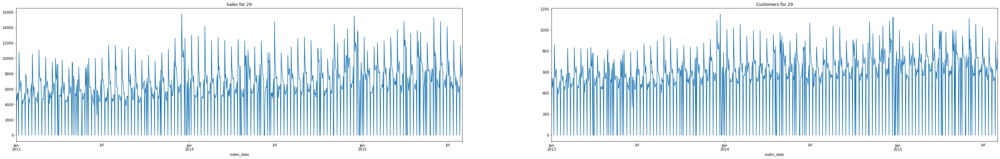

Sales and Customer Values Intepolation For Store Id : 31


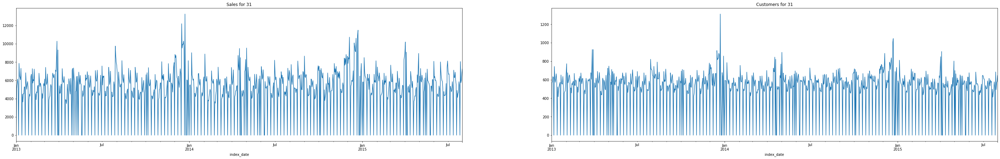

Sales and Customer Values Intepolation For Store Id : 46


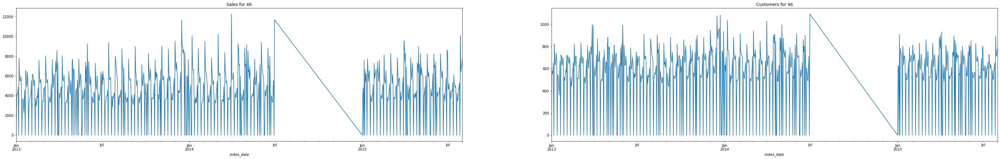

In [14]:
stores_df_arr_1 = [x for _, x in store_train_df.groupby('Store')]
for i in range(0,len(stores_df_arr_1)):
    store_df = stores_df_arr_1[i]
    key = store_df['Store'].unique()[0]
    print("Sales and Customer Values Intepolation For Store Id : %i"%key)
    store_df = add_missing_dates(store_df)
    store_df['Sales']= store_df['Sales'].interpolate(method='linear')
    store_df['Sales']= store_df['Sales'].fillna(store_df['Sales'].median())
    store_df['Customers']= store_df['Customers'].interpolate(method='linear')
    store_df['Customers']= store_df['Customers'].fillna(store_df['Customers'].median())
    store_df = add_date_properties(store_df)
    store_df.set_index('index_date',inplace=True)
    fig, (axis1,axis2) = plt.subplots(1,2, figsize=(50,7))
    store_df['Sales'].plot(ax=axis1)
    axis1.set_title('Sales for %i'%key)
    store_df['Customers'].plot(ax = axis2)
    axis2.set_title('Customers for %i'%key)
    plt.show(block=False)
    

### As we can see that intepolating Sales and Customers with the Linear Inteploation and then if any remaning with Median value results in uneven values for sales and customers , so we have intepolated it using ane year before and after value along with that we have also used linear interpolation and if any null values remain we replaced it with median value

In [15]:
stores_df_arr = [x for _, x in store_train_df.groupby('Store')]
store_df_dict = {}
for i in range(0,len(stores_df_arr)):
    key = stores_df_arr[i]['Store'].unique()[0]
    stores_df_arr[i] = stores_df_arr[i][stores_df_arr[i]['Sales'] > 0]
    stores_df_arr[i] = stores_df_arr[i][stores_df_arr[i]['Open'] == 1]
    store_df_dict[key] = add_missing_dates(stores_df_arr[i])
    store_df_dict[key] = single_value_imputation(store_df_dict[key] , ['Store','StoreType','Assortment','CompetitionDistance','CompetitionOpenSinceMonth','CompetitionOpenSinceYear','Promo2','Promo2SinceWeek','Promo2SinceYear','PromoInterval','Open','StateHoliday'])
    store_df_dict[key]['DayOfWeek'] = store_df_dict[key]['DayOfWeek'].fillna(value=store_df_dict[key]['Date'].dt.dayofweek)
    store_df_dict[key] = add_date_properties(store_df_dict[key])
    store_df_dict[key].set_index('index_date',inplace=True)
    store_df_dict[key] = store_df_dict[key].asfreq('d')
    store_df_dict[key] = store_df_dict[key].rename_axis(None)
    store_df_dict[key] = linear_values_imputation(store_df_dict[key] , ['Sales','Customers'])
    store_df_dict[key] = binary_value_imputation(store_df_dict[key] , ['Promo','SchoolHoliday'])
    store_df_dict[key] = is_promo_month(store_df_dict[key])


    


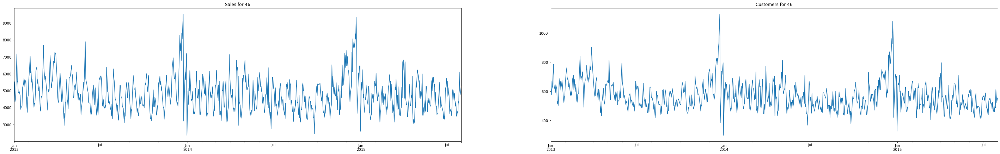

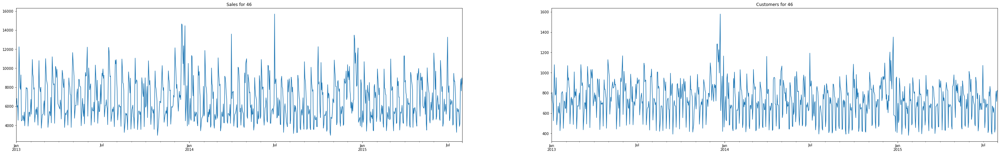

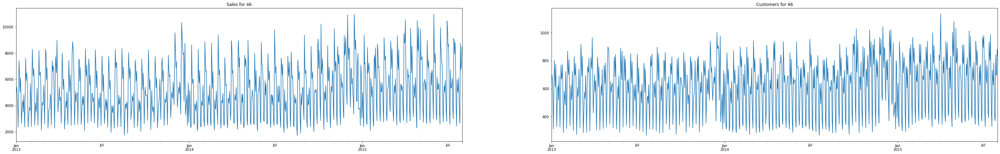

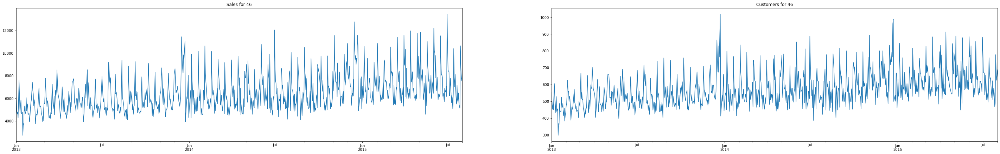

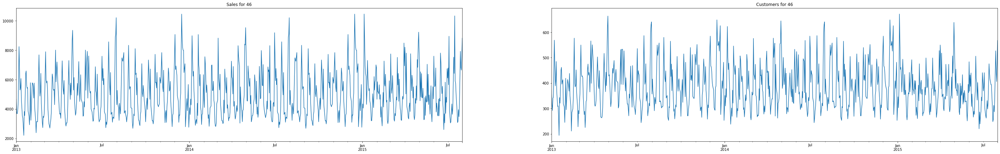

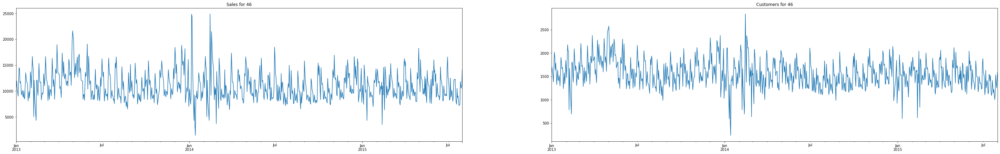

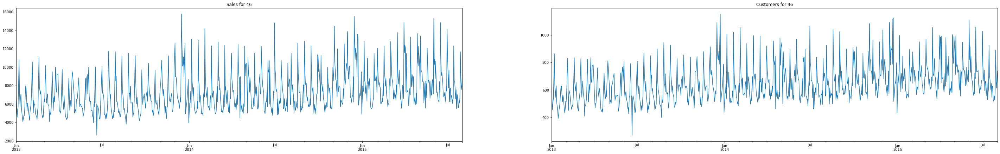

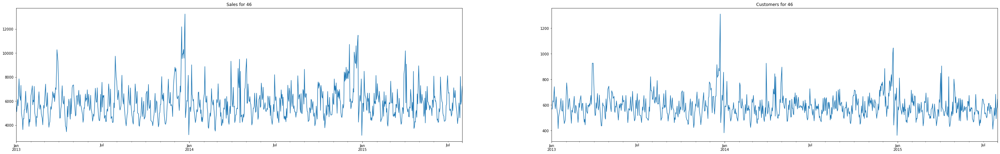

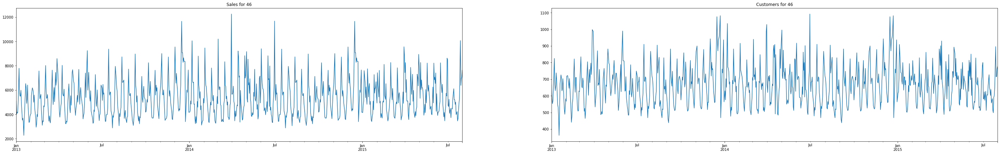

In [16]:
for i , j in store_df_dict.items() : 
    fig, (axis1,axis2) = plt.subplots(1,2, figsize=(50,7))
    j['Sales'].plot(ax=axis1)
    axis1.set_title('Sales for %i'%key)
    j['Customers'].plot(ax = axis2)
    axis2.set_title('Customers for %i'%key)
    plt.show(block=False)

### This clearly givens us some good result than the previous technique

### Now we will be dropping some feature which are common for all model (As we will be making different Models for different stores having feature that common for store is of no use

In [17]:
common_values_column = ['Store','StoreType','Assortment','CompetitionDistance','CompetitionOpenSinceMonth','CompetitionOpenSinceYear','Open','StateHoliday','monthStr']
common_value=[]
index_columns = []
for k,v in store_df_dict.items():
    values = {}
    for i in v.columns:
        if i in common_values_column:
            values[i] = v[i].unique()
    common_value.append(values)
    index_columns.append("Store_"+str(k))
columns_df = pd.DataFrame(common_value, index =index_columns) 
columns_df

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Open,StateHoliday,monthStr
Store_1,[1.0],[c],[a],[1270.0],[9.0],[2008.0],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_3,[3.0],[a],[a],[14130.0],[12.0],[2006.0],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_8,[8.0],[a],[a],[7520.0],[10.0],[2014.0],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_9,[9.0],[a],[c],[2030.0],[8.0],[2000.0],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_13,[13.0],[d],[a],[310.0],[nan],[nan],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_25,[25.0],[c],[a],[430.0],[4.0],[2003.0],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_29,[29.0],[d],[c],[2170.0],[nan],[nan],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_31,[31.0],[d],[c],[9800.0],[7.0],[2012.0],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."
Store_46,[46.0],[c],[a],[1200.0],[9.0],[2005.0],[1.0],[0],"[Jan, Feb, Mar, Apr, May, Jun, Jul, Aug, Sept,..."


### As we can see that almost all the feature have single value , which would have been useful for if we weould have created single model for all store , but as we are creating different models for each store these are not useful

In [18]:
for k,v in store_df_dict.items():
    v.drop(['Store','StoreType','Assortment','CompetitionDistance','CompetitionOpenSinceMonth','CompetitionOpenSinceYear','Open','StateHoliday','monthStr'],axis=1,inplace=True)
    v = v.dropna(axis=1, how='all')
    store_df_dict[k] = v

In [19]:
columns = ['Sales','Customers','Date']
for k,v in store_df_dict.items():
    print("Store: ",k)
    v_columns = [x for x in list(v.columns) if x not in columns]
    for i in v_columns:
        unique = v[i].unique()
        v[i] = v[i].replace(np.nan,0)
        print(i+" : ",unique , len(unique))
    print("\n\n")
    store_df_dict[k] = v


Store:  1
Promo2 :  [0.] 1
DayOfWeek :  [1 2 3 4 5 6 0] 7
Promo :  [0. 1.] 2
SchoolHoliday :  [0. 1.] 2
Year :  [2013 2014 2015] 3
Month :  [ 1  2  3  4  5  6  7  8  9 10 11 12] 12
Day :  [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31] 31
WeekOfYear :  [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52] 52
Is_Promo_Month :  [0] 1



Store:  3
Promo2 :  [1.] 1
Promo2SinceWeek :  [14.] 1
Promo2SinceYear :  [2011.] 1
PromoInterval :  ['Jan,Apr,Jul,Oct'] 1
DayOfWeek :  [1 2 3 4 5 6 0] 7
Promo :  [0. 1.] 2
SchoolHoliday :  [0. 1.] 2
Year :  [2013 2014 2015] 3
Month :  [ 1  2  3  4  5  6  7  8  9 10 11 12] 12
Day :  [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31] 31
WeekOfYear :  [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 

In [20]:
for j , k in store_df_dict.items():
    print("Store id : %i"%j)
    print(k.isna().sum())
    print("\n\n")

Store id : 1
Promo2            0
DayOfWeek         0
Date              0
Sales             0
Customers         0
Promo             0
SchoolHoliday     0
Year              0
Month             0
Day               0
WeekOfYear        0
Is_Promo_Month    0
dtype: int64



Store id : 3
Promo2             0
Promo2SinceWeek    0
Promo2SinceYear    0
PromoInterval      0
DayOfWeek          0
Date               0
Sales              0
Customers          0
Promo              0
SchoolHoliday      0
Year               0
Month              0
Day                0
WeekOfYear         0
Is_Promo_Month     0
dtype: int64



Store id : 8
Promo2            0
DayOfWeek         0
Date              0
Sales             0
Customers         0
Promo             0
SchoolHoliday     0
Year              0
Month             0
Day               0
WeekOfYear        0
Is_Promo_Month    0
dtype: int64



Store id : 9
Promo2            0
DayOfWeek         0
Date              0
Sales             0
Customers         0
Promo

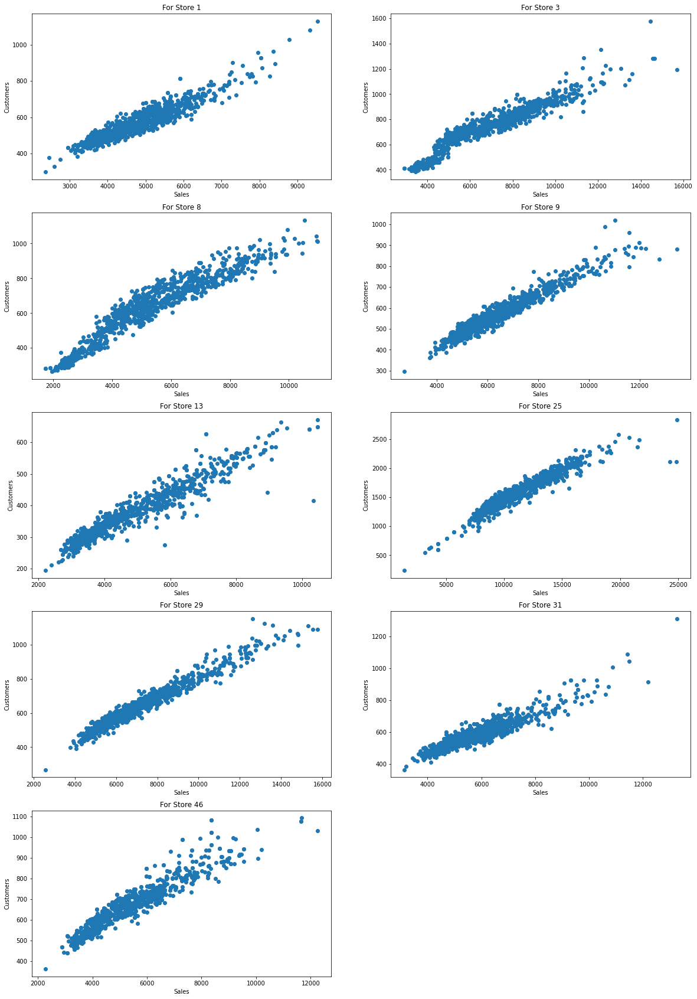

In [21]:
store_outlier_detection_columns = ['Sales','Customers']

plt.figure(figsize=(20,30))
counter=1
for k , v in store_df_dict.items():
    plt.subplot(5,2,counter)
    plt.scatter(v['Sales'],v['Customers'])
    plt.title("For Store %i"%k)
    plt.xlabel("Sales")
    plt.ylabel("Customers")
    counter=counter+1
plt.show()


Almost all stores have linear relation between Sales and Customers

In [22]:
# CompetitionDistance , Sales , Customers
scaler = StandardScaler()
for k , v  in store_df_dict.items():
    v['Sales'] = scaler.fit_transform(v[['Sales']])
    v['Customers'] = scaler.fit_transform(v[['Customers']])


In [23]:
for k , v  in store_df_dict.items():
    print("Store  : %i"%k)
    display(v.describe(percentiles=[0.05,0.25,0.5,0.75,0.95,0.99,1.00]))


Store  : 1


,Promo2,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.0
mean,0.0,2.997877,1.773764e-16,-4.200756e-16,0.375796,0.181529,2013.837580,5.961783,15.707006,24.098726,0.0
std,0.0,1.998404,1.000531e+00,1.000531e+00,0.484585,0.385660,0.766009,3.350357,8.794449,14.547508,0.0
min,0.0,0.000000,-2.457587e+00,-2.894471e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.0
5%,0.0,0.000000,-1.322713e+00,-1.296535e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.0
25%,0.0,1.000000,-7.568577e-01,-7.224423e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.0
50%,0.0,3.000000,-1.065937e-01,-1.536407e-01,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.0
75%,0.0,5.000000,5.632534e-01,5.342123e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,0.0
95%,0.0,6.000000,1.729962e+00,1.692716e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,0.0
99%,0.0,6.000000,3.136129e+00,3.250385e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,0.0


Store  : 3


,Promo2,Promo2SinceWeek,Promo2SinceYear,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.0,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000
mean,1.0,14.0,2011.0,2.997877,1.020651e-16,-1.806764e-16,0.375796,0.165605,2013.837580,5.961783,15.707006,24.098726,0.358811
std,0.0,0.0,0.0,1.998404,1.000531e+00,1.000531e+00,0.484585,0.371923,0.766009,3.350357,8.794449,14.547508,0.479906
min,1.0,14.0,2011.0,0.000000,-1.713663e+00,-1.956039e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.000000
5%,1.0,14.0,2011.0,0.000000,-1.322505e+00,-1.645021e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.000000
25%,1.0,14.0,2011.0,1.000000,-7.920215e-01,-5.578701e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.000000
50%,1.0,14.0,2011.0,3.000000,-2.033437e-01,-2.207024e-02,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.000000
75%,1.0,14.0,2011.0,5.000000,7.091696e-01,6.508604e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,1.000000
95%,1.0,14.0,2011.0,6.000000,1.813622e+00,1.552107e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,1.000000
99%,1.0,14.0,2011.0,6.000000,2.566845e+00,2.575442e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,1.000000


Store  : 8


,Promo2,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.0
mean,0.0,2.997877,1.261081e-16,-1.107866e-16,0.376858,0.153928,2013.837580,5.961783,15.707006,24.098726,0.0
std,0.0,1.998404,1.000531e+00,1.000531e+00,0.484856,0.361071,0.766009,3.350357,8.794449,14.547508,0.0
min,0.0,0.000000,-1.790696e+00,-1.904083e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.0
5%,0.0,0.000000,-1.453702e+00,-1.658237e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.0
25%,0.0,1.000000,-7.580439e-01,-6.855390e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.0
50%,0.0,3.000000,-9.085278e-02,6.803449e-02,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.0
75%,0.0,5.000000,7.103408e-01,7.507935e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,0.0
95%,0.0,6.000000,1.750584e+00,1.559148e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,0.0
99%,0.0,6.000000,2.409692e+00,2.033579e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,0.0


Store  : 9


,Promo2,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.0
mean,0.0,2.997877,4.789752e-16,-4.938253e-16,0.375796,0.165605,2013.837580,5.961783,15.707006,24.098726,0.0
std,0.0,1.998404,1.000531e+00,1.000531e+00,0.484585,0.371923,0.766009,3.350357,8.794449,14.547508,0.0
min,0.0,0.000000,-2.386231e+00,-2.746493e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.0
5%,0.0,0.000000,-1.206886e+00,-1.277809e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.0
25%,0.0,1.000000,-7.206348e-01,-7.382928e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.0
50%,0.0,3.000000,-2.169708e-01,-1.688031e-01,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.0
75%,0.0,5.000000,5.117177e-01,5.505523e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,0.0
95%,0.0,6.000000,1.969831e+00,1.937809e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,0.0
99%,0.0,6.000000,3.263308e+00,3.104164e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,0.0


Store  : 13


,Promo2,Promo2SinceWeek,Promo2SinceYear,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.0,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000
mean,1.0,45.0,2009.0,2.997877,1.371868e-16,9.145786e-17,0.363057,0.156051,2013.837580,5.961783,15.707006,24.098726,0.317410
std,0.0,0.0,0.0,1.998404,1.000531e+00,1.000531e+00,0.481137,0.363096,0.766009,3.350357,8.794449,14.547508,0.465716
min,1.0,45.0,2009.0,0.000000,-1.791957e+00,-2.227412e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.000000
5%,1.0,45.0,2009.0,0.000000,-1.240634e+00,-1.360829e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.000000
25%,1.0,45.0,2009.0,1.000000,-8.138363e-01,-7.715529e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.000000
50%,1.0,45.0,2009.0,3.000000,-2.297684e-01,-1.591679e-01,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.000000
75%,1.0,45.0,2009.0,5.000000,6.706730e-01,6.250894e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,1.000000
95%,1.0,45.0,2009.0,6.000000,1.885305e+00,1.908498e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,1.000000
99%,1.0,45.0,2009.0,6.000000,2.636717e+00,2.791373e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,1.000000


Store  : 25


,Promo2,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.0
mean,0.0,2.997877,1.690085e-16,-2.247553e-16,0.373673,0.165605,2013.837580,5.961783,15.707006,24.098726,0.0
std,0.0,1.998404,1.000531e+00,1.000531e+00,0.484035,0.371923,0.766009,3.350357,8.794449,14.547508,0.0
min,0.0,0.000000,-3.476588e+00,-4.421522e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.0
5%,0.0,0.000000,-1.221628e+00,-1.366772e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.0
25%,0.0,1.000000,-7.241294e-01,-6.852196e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.0
50%,0.0,3.000000,-1.414910e-01,-7.339796e-02,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.0
75%,0.0,5.000000,5.606584e-01,6.297779e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,0.0
95%,0.0,6.000000,1.804548e+00,1.729800e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,0.0
99%,0.0,6.000000,2.897283e+00,2.516938e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,0.0


Store  : 29


,Promo2,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.0
mean,0.0,2.997877,-1.506226e-16,-7.755061e-17,0.375796,0.165605,2013.837580,5.961783,15.707006,24.098726,0.0
std,0.0,1.998404,1.000531e+00,1.000531e+00,0.484585,0.371923,0.766009,3.350357,8.794449,14.547508,0.0
min,0.0,0.000000,-2.240157e+00,-2.900661e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.0
5%,0.0,0.000000,-1.208312e+00,-1.302760e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.0
25%,0.0,1.000000,-7.434710e-01,-7.166343e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.0
50%,0.0,3.000000,-2.073731e-01,-1.474945e-01,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.0
75%,0.0,5.000000,5.130085e-01,5.198821e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,0.0
95%,0.0,6.000000,2.039969e+00,2.056179e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,0.0
99%,0.0,6.000000,3.117130e+00,3.081696e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,0.0


Store  : 31


,Promo2,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.0
mean,0.0,2.997877,3.493313e-16,2.845094e-16,0.376858,0.153928,2013.837580,5.961783,15.707006,24.098726,0.0
std,0.0,1.998404,1.000531e+00,1.000531e+00,0.484856,0.361071,0.766009,3.350357,8.794449,14.547508,0.0
min,0.0,0.000000,-2.063437e+00,-2.494250e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.0
5%,0.0,0.000000,-1.247996e+00,-1.293000e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.0
25%,0.0,1.000000,-6.872707e-01,-6.334686e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.0
50%,0.0,3.000000,-1.463743e-01,-1.269836e-01,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.0
75%,0.0,5.000000,4.579712e-01,4.455646e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,0.0
95%,0.0,6.000000,1.945628e+00,1.733248e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,0.0
99%,0.0,6.000000,3.296353e+00,3.432835e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,0.0


Store  : 46


,Promo2,Promo2SinceWeek,Promo2SinceYear,DayOfWeek,Sales,Customers,Promo,SchoolHoliday,Year,Month,Day,WeekOfYear,Is_Promo_Month
count,942.0,942.0,942.0,942.000000,9.420000e+02,9.420000e+02,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000,942.000000
mean,1.0,14.0,2011.0,2.997877,9.145786e-17,4.212247e-16,0.363057,0.158174,2013.837580,5.961783,15.707006,24.098726,0.358811
std,0.0,0.0,0.0,1.998404,1.000531e+00,1.000531e+00,0.481137,0.365098,0.766009,3.350357,8.794449,14.547508,0.479906
min,1.0,14.0,2011.0,0.000000,-2.024465e+00,-2.572398e+00,0.000000,0.000000,2013.000000,1.000000,1.000000,1.000000,0.000000
5%,1.0,14.0,2011.0,0.000000,-1.261970e+00,-1.381695e+00,0.000000,0.000000,2013.000000,1.000000,2.000000,3.000000,0.000000
25%,1.0,14.0,2011.0,1.000000,-7.923085e-01,-7.785906e-01,0.000000,0.000000,2013.000000,3.000000,8.000000,12.000000,0.000000
50%,1.0,14.0,2011.0,3.000000,-1.755777e-01,-2.837694e-02,0.000000,0.000000,2014.000000,6.000000,16.000000,23.000000,0.000000
75%,1.0,14.0,2011.0,5.000000,5.852202e-01,5.416178e-01,1.000000,0.000000,2014.000000,9.000000,23.000000,36.000000,1.000000
95%,1.0,14.0,2011.0,6.000000,1.946760e+00,1.874400e+00,1.000000,1.000000,2015.000000,12.000000,29.000000,49.000000,1.000000
99%,1.0,14.0,2011.0,6.000000,2.700640e+00,2.751856e+00,1.000000,1.000000,2015.000000,12.000000,31.000000,52.000000,1.000000


### Remove Outlier


In [24]:
outlier_columns = ['Sales','Customers']
for k , v in store_df_dict.items():
    df  = v
    df = [df[(df[outlier] < np.percentile(df[outlier],99)) & (df[outlier] > np.percentile(df[outlier],5))] for outlier in outlier_columns]
    df = df[len(df) - 1]
    store_df_dict[k] = df

In [25]:
selected_store_ids

[1, 3, 8, 9, 13, 25, 29, 31, 46]

## Now that most of data has been converted to numeric values , we need to identify Features and visualize the same

<h4> These are features that will have impact on the sales of Store </h4>

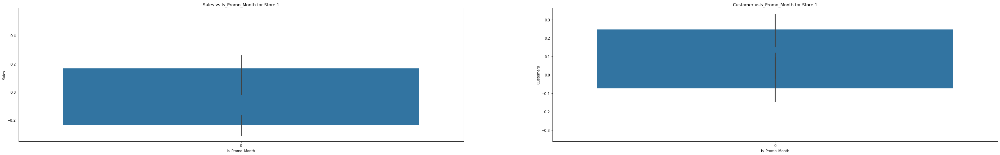

---

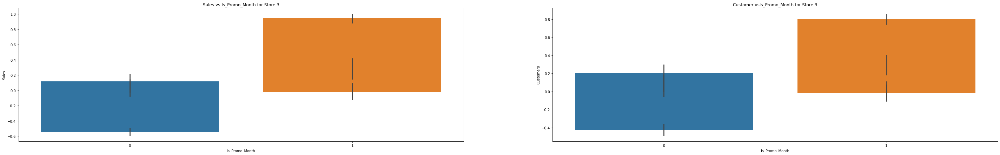

---

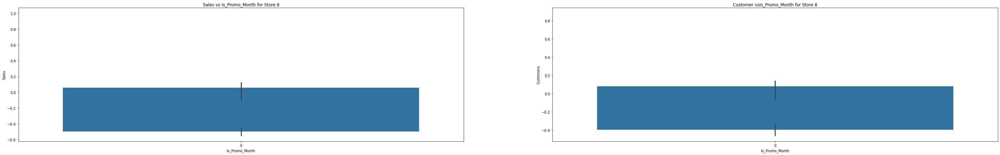

---

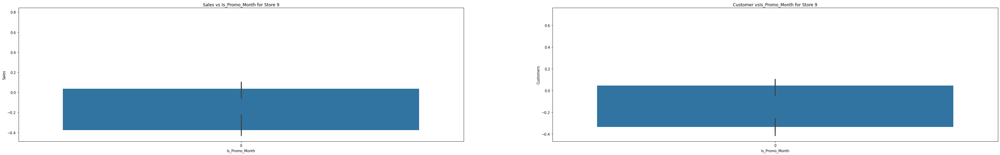

---

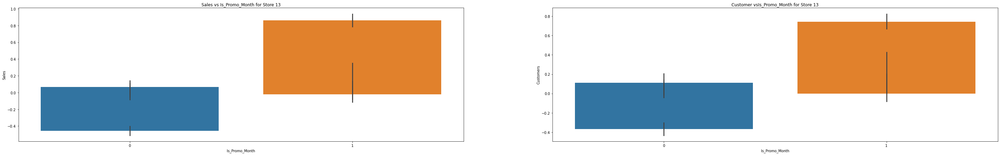

---

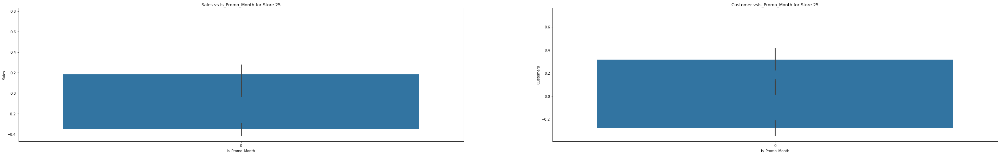

---

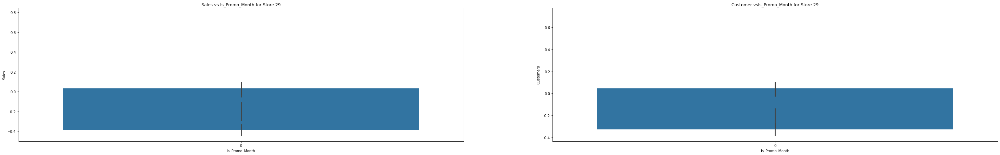

---

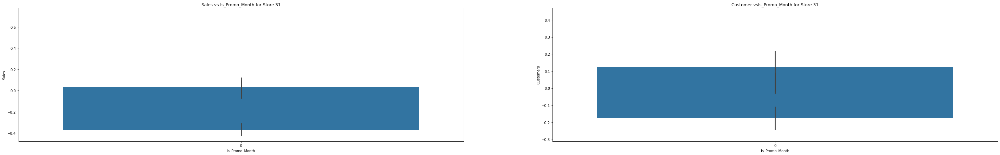

---

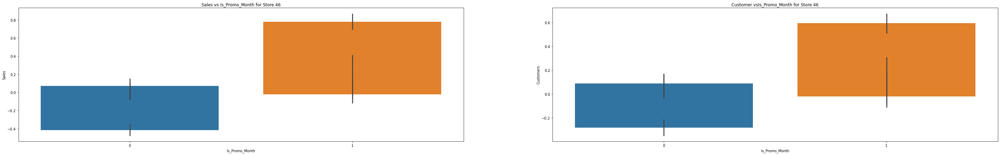

---

In [26]:
non_graph_columns = ["Date","Sales","Customers","Day","WeekOfYear","Day","DayOfWeek","Month"]
for k , v in store_df_dict.items():
    fig, (axis1,axis2) = plt.subplots(1,2, figsize=(50,7))
    counter=1
    for column in v.columns:
        if(column not in non_graph_columns):
            g1 = sns.barplot(x=column, y="Sales", data=v  , ax=axis1)
            axis1.set_title("Sales vs "+column+" for Store %i"%k)
            g2 = sns.barplot(x=column, y="Customers", data=v  , ax=axis2)
            axis2.set_title("Customer vs"+column+" for Store %i"%k)
    plt.show(block=False)
    display(Markdown('---'))


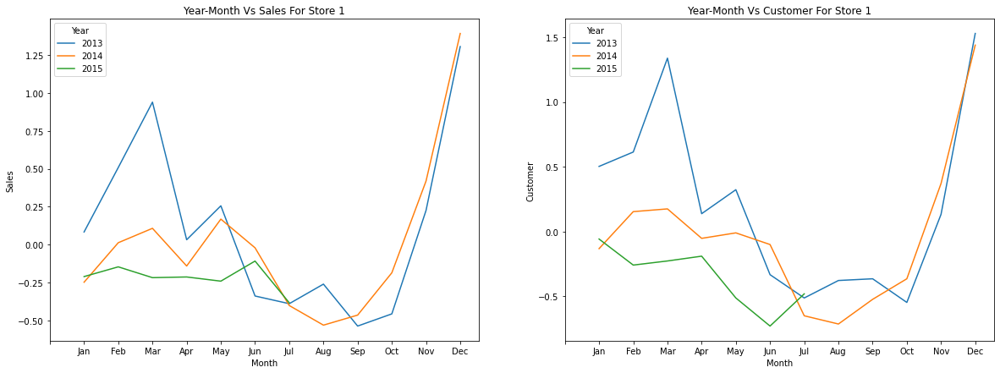

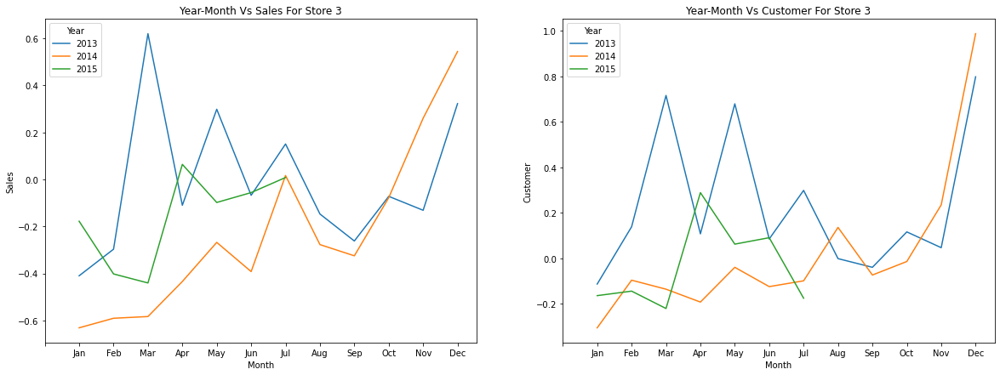

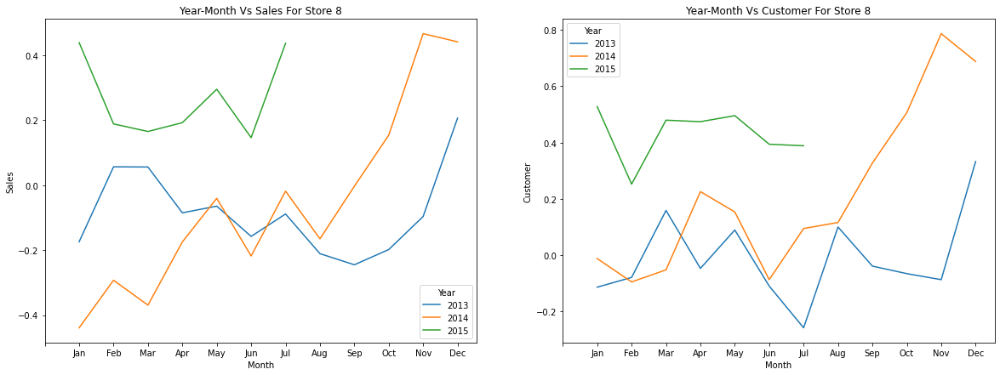

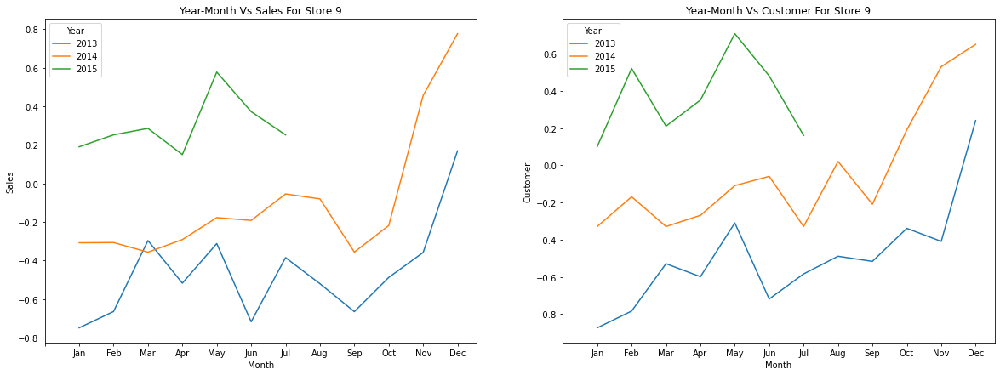

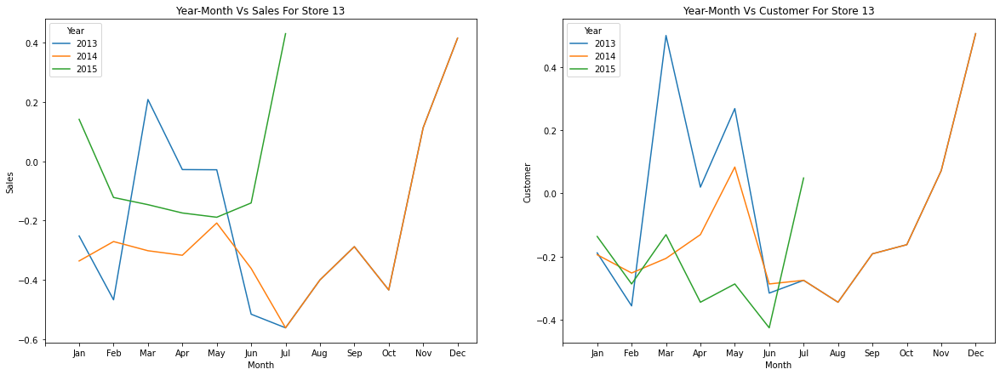

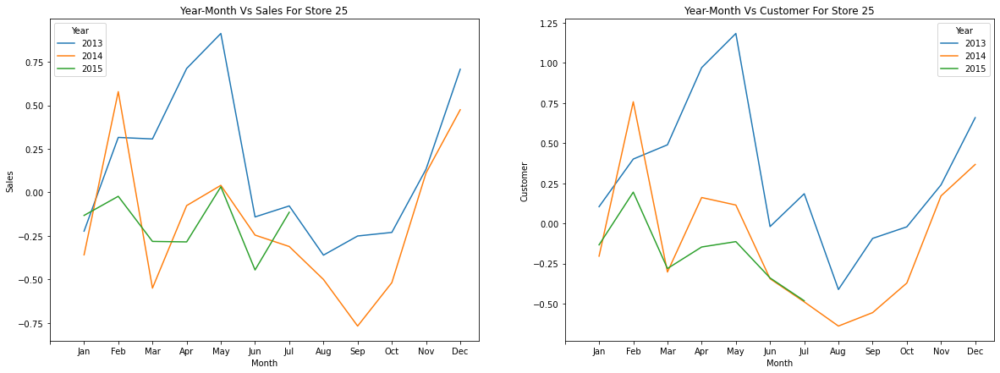

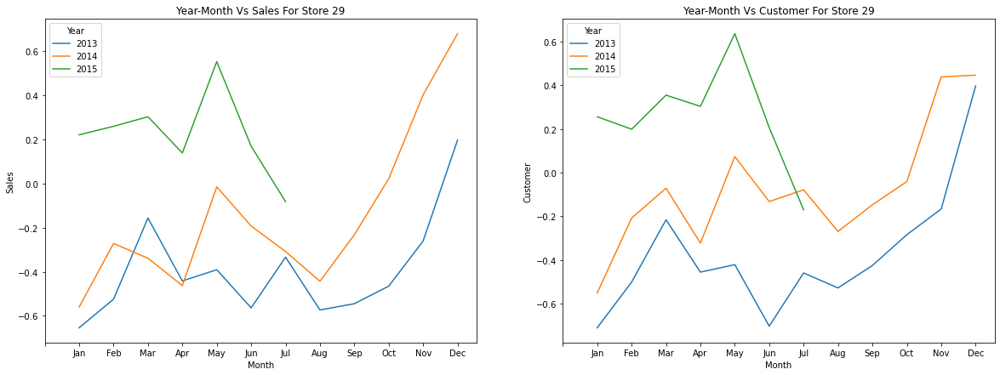

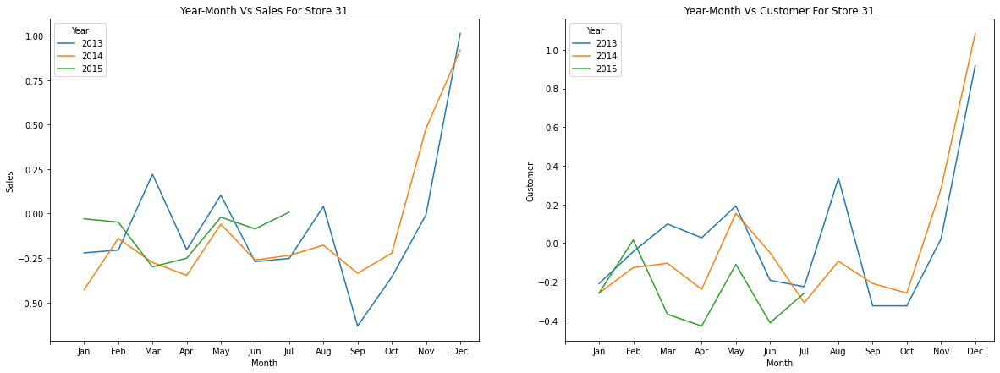

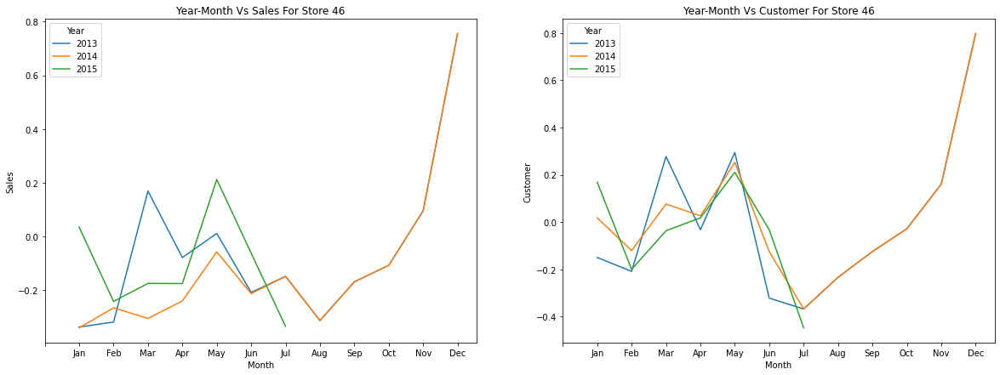

In [27]:
rcParams['figure.figsize'] = 20, 15
for k ,v  in store_df_dict.items():
    sales_df = v.groupby(['Year', 'Month'])['Sales'].median()
    customer_df = v.groupby(['Year', 'Month'])['Customers'].median()
    fig, (axis1,axis2) = plt.subplots(1,2, figsize=(20,7))
    sales_df.unstack().T.plot(ax=axis1)
    customer_df.unstack().T.plot(ax=axis2)
    tmp = axis1.set_title("Year-Month Vs Sales For Store %i"%k)
    tmp = axis1.set_ylabel("Sales")
    tmp = axis1.set_xticks(range(0,13))
    tmp = axis1.set_xticklabels(calendar.month_abbr)
    tmp1 = axis2.set_title("Year-Month Vs Customer For Store %i"%k)
    tmp1 = axis2.set_ylabel("Customer")
    tmp1 = axis2.set_xticks(range(0,13))
    tmp1 = axis2.set_xticklabels(calendar.month_abbr)


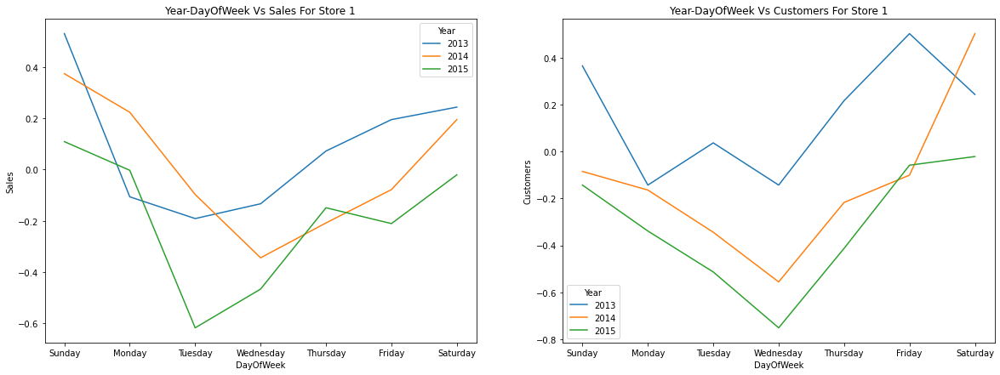

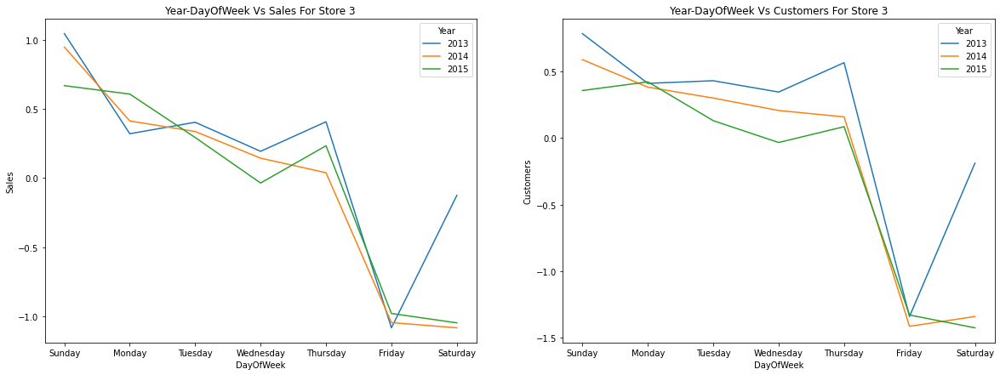

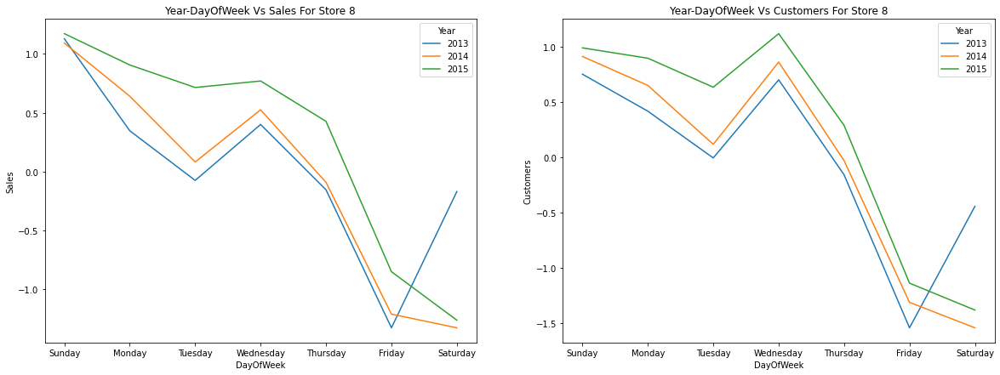

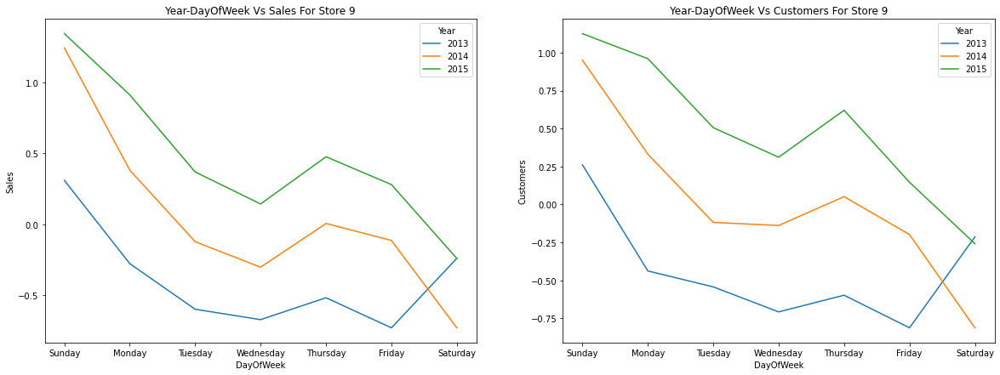

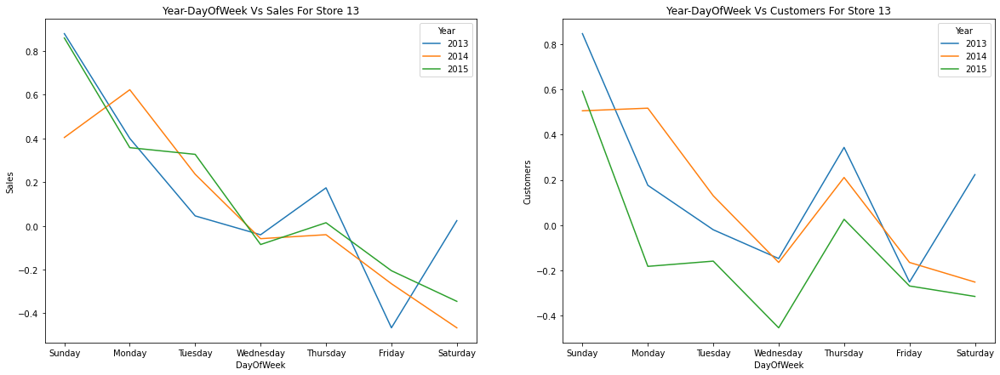

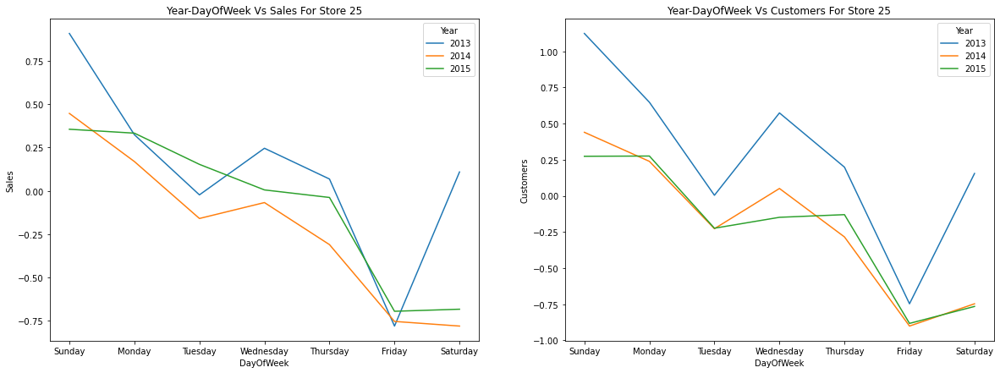

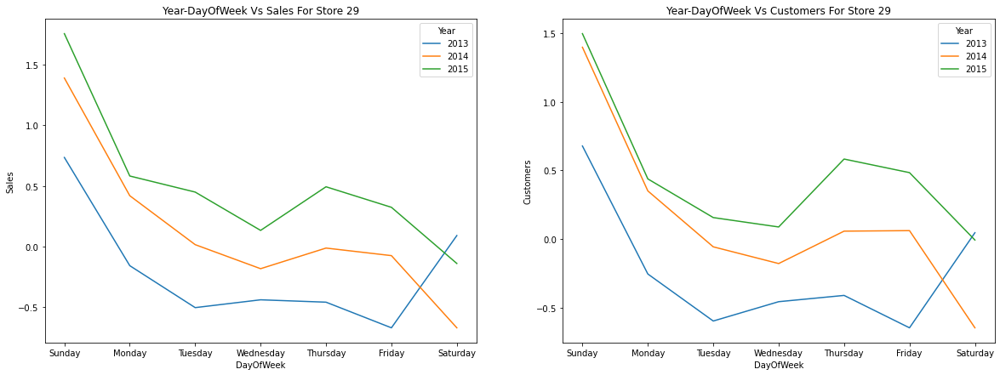

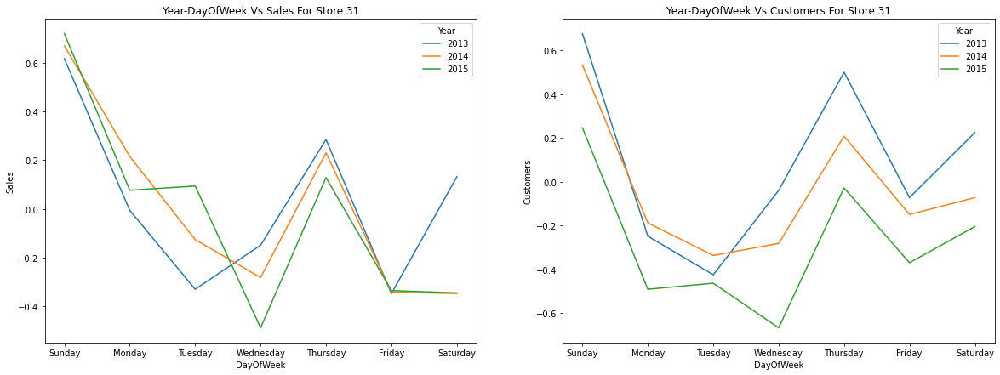

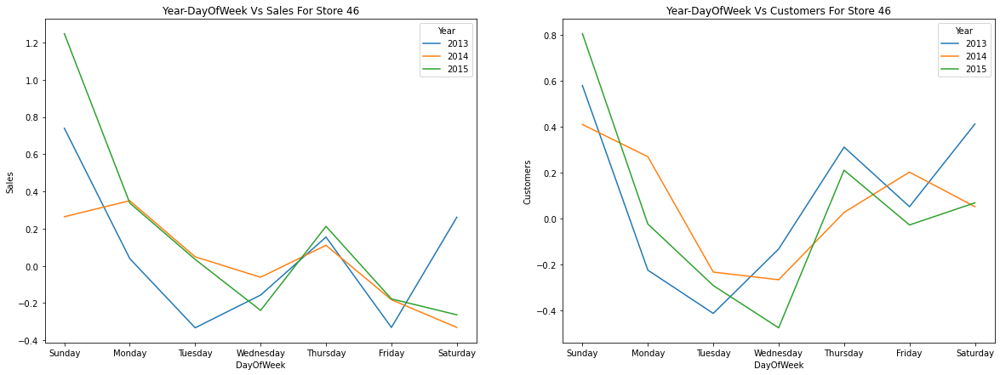

In [28]:
for k ,v  in store_df_dict.items():
    sales_df = v.groupby(['Year', 'DayOfWeek'])['Sales'].median()
    customers_df = v.groupby(['Year', 'DayOfWeek'])['Customers'].median()
    fig, (axis1,axis2) = plt.subplots(1,2, figsize=(20,7))
    sales_df.unstack().T.plot(ax=axis1)
    customers_df.unstack().T.plot(ax=axis2)
    tmp = axis1.set_title("Year-DayOfWeek Vs Sales For Store %i"%k)
    tmp = axis1.set_ylabel("Sales")
    tmp = axis1.set_xticks(range(0,7))
    tmp = axis1.set_xticklabels(['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'])
    tmp1 = axis2.set_title("Year-DayOfWeek Vs Customers For Store %i"%k)
    tmp1 = axis2.set_ylabel("Customers")
    tmp1 = axis2.set_xticks(range(0,7))
    tmp1 = axis2.set_xticklabels(['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'])


In [29]:
corelation_columns = []
for k , v in store_df_dict.items():
    corelation_columns.append(v.corr()[['Sales','Customers']].rename(columns={"Sales":"Store_"+str(k),"Customers":"Customers_"+str(k)}))
corelation_columns = pd.concat(corelation_columns,axis=1)
corelation_columns

,Store_1,Customers_1,Store_3,Customers_3,Store_8,Customers_8,Store_9,Customers_9,Store_13,Customers_13,Store_25,Customers_25,Store_29,Customers_29,Store_31,Customers_31,Store_46,Customers_46
Promo2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DayOfWeek,0.002523,0.130974,-0.451307,-0.511155,-0.593725,-0.658545,-0.304505,-0.343408,-0.216062,-0.151774,-0.353603,-0.399101,-0.282120,-0.244617,-0.159603,0.020025,-0.163226,0.006843
Sales,1.000000,0.912397,1.000000,0.940261,1.000000,0.945921,1.000000,0.959754,1.000000,0.940835,1.000000,0.942729,1.000000,0.972501,1.000000,0.899984,1.000000,0.937012
Customers,0.912397,1.000000,0.940261,1.000000,0.945921,1.000000,0.959754,1.000000,0.940835,1.000000,0.942729,1.000000,0.972501,1.000000,0.899984,1.000000,0.937012,1.000000
Promo,0.391226,0.164971,0.787638,0.678739,0.750925,0.650612,0.562537,0.510493,0.688917,0.589745,0.574714,0.523689,0.572786,0.518677,0.552308,0.308344,0.628328,0.472407
SchoolHoliday,-0.015166,-0.049676,0.117577,0.121735,0.123835,0.133358,0.084159,0.086933,0.061282,0.087010,0.048244,-0.032814,0.043777,0.026402,0.091878,0.032052,0.076402,0.031878
Year,-0.128484,-0.221108,-0.050160,-0.135030,0.104451,0.077733,0.333292,0.366102,0.030567,-0.093882,-0.101361,-0.217356,0.242317,0.255308,-0.002191,-0.130263,0.030086,-0.028616
Month,0.068735,-0.008782,0.087091,0.120103,0.059801,0.052657,0.074132,0.071800,0.058099,0.111367,-0.025507,-0.044121,0.049308,0.060300,0.207574,0.203856,0.086740,0.089105
Day,-0.111190,-0.139722,-0.122831,-0.121546,-0.061455,-0.059340,-0.091552,-0.099350,-0.043078,-0.021704,-0.112385,-0.132213,-0.089499,-0.094485,-0.097416,-0.110350,-0.051139,-0.069541
WeekOfYear,0.032402,-0.048944,0.075010,0.103079,0.070192,0.064251,0.066866,0.065384,0.056076,0.100000,-0.044393,-0.062557,0.040419,0.047220,0.183825,0.167395,0.075956,0.064620


In [30]:
for k , v in store_df_dict.items():
    if(k in [1,8,9,25,31,29]):
        v.drop(['Promo2','Is_Promo_Month'],axis=1,inplace=True)
    elif(k in [3,13,46]):
        v.drop(['Promo2','Promo2SinceWeek','Promo2SinceYear'],axis=1,inplace=True)
        

    

In [31]:
corelation_columns = []
for k , v in store_df_dict.items():
    corelation_columns.append(v.corr()[['Sales','Customers']].rename(columns={"Sales":"Store_"+str(k),"Customers":"Customers_"+str(k)}))
corelation_columns = pd.concat(corelation_columns,axis=1)
corelation_columns

,Store_1,Customers_1,Store_3,Customers_3,Store_8,Customers_8,Store_9,Customers_9,Store_13,Customers_13,Store_25,Customers_25,Store_29,Customers_29,Store_31,Customers_31,Store_46,Customers_46
DayOfWeek,0.002523,0.130974,-0.451307,-0.511155,-0.593725,-0.658545,-0.304505,-0.343408,-0.216062,-0.151774,-0.353603,-0.399101,-0.282120,-0.244617,-0.159603,0.020025,-0.163226,0.006843
Sales,1.000000,0.912397,1.000000,0.940261,1.000000,0.945921,1.000000,0.959754,1.000000,0.940835,1.000000,0.942729,1.000000,0.972501,1.000000,0.899984,1.000000,0.937012
Customers,0.912397,1.000000,0.940261,1.000000,0.945921,1.000000,0.959754,1.000000,0.940835,1.000000,0.942729,1.000000,0.972501,1.000000,0.899984,1.000000,0.937012,1.000000
Promo,0.391226,0.164971,0.787638,0.678739,0.750925,0.650612,0.562537,0.510493,0.688917,0.589745,0.574714,0.523689,0.572786,0.518677,0.552308,0.308344,0.628328,0.472407
SchoolHoliday,-0.015166,-0.049676,0.117577,0.121735,0.123835,0.133358,0.084159,0.086933,0.061282,0.087010,0.048244,-0.032814,0.043777,0.026402,0.091878,0.032052,0.076402,0.031878
Year,-0.128484,-0.221108,-0.050160,-0.135030,0.104451,0.077733,0.333292,0.366102,0.030567,-0.093882,-0.101361,-0.217356,0.242317,0.255308,-0.002191,-0.130263,0.030086,-0.028616
Month,0.068735,-0.008782,0.087091,0.120103,0.059801,0.052657,0.074132,0.071800,0.058099,0.111367,-0.025507,-0.044121,0.049308,0.060300,0.207574,0.203856,0.086740,0.089105
Day,-0.111190,-0.139722,-0.122831,-0.121546,-0.061455,-0.059340,-0.091552,-0.099350,-0.043078,-0.021704,-0.112385,-0.132213,-0.089499,-0.094485,-0.097416,-0.110350,-0.051139,-0.069541
WeekOfYear,0.032402,-0.048944,0.075010,0.103079,0.070192,0.064251,0.066866,0.065384,0.056076,0.100000,-0.044393,-0.062557,0.040419,0.047220,0.183825,0.167395,0.075956,0.064620
Is_Promo_Month,NaN,NaN,-0.034563,-0.065984,NaN,NaN,NaN,NaN,-0.044417,-0.024898,NaN,NaN,NaN,NaN,NaN,NaN,-0.047360,-0.057815


<h4> We will now test if series is stationary or not </h4>


In [32]:
def kpss_result(df_dict , column):
    kpss_result_arr = []
    kpss_index_columns = []
    for i , j in df_dict.items() : 
        result_dict = {}
        result = kpss(j[column].dropna())
        result_dict['KPSS_Statistic'] = result[0]
        result_dict['P_Value'] = result[1]
        result_dict.update(result[3])
        kpss_result_arr.append(result_dict)
        kpss_index_columns.append("Store_"+str(i))
    kpss_result = pd.DataFrame(kpss_result_arr, index =kpss_index_columns) 
    return kpss_result

def adfuller_result(df_dict , columns):
    adfuller_result_arr = []
    adfuller_index_columns = []
    adfuller_result_df = []
    for i , j in df_dict.items() : 
        result_dict = {}
        result = adfuller(j[column].dropna())
        result_dict['ADF Statistic'] = result[0]
        result_dict['P_Value'] = result[1]
        result_dict.update(result[4])
        adfuller_result_arr.append(result_dict)
        adfuller_index_columns.append("Store_"+str(i))
    adfuller_result = pd.DataFrame(adfuller_result_arr, index =adfuller_index_columns) 
    return adfuller_result

def create_diffrencing_boxcox(df_dict):
    for i , j in df_dict.items() : 
        j['lnSales'] = np.log(j['Sales'])
        j['lnCustomers'] = np.log(j['Customers'])
        j['dlnSales'] = np.log(j['Sales']).diff()
        j['dlnCustomers'] = np.log(j['Customers']).diff()
        df_dict[i] = j

def plotseasonal(res, axes , x_label):
    res.observed.plot(ax=axes[0], legend=False)
    axes[0].set_ylabel('Observed')
    axes[0].set_xlabel(x_label)
    res.trend.plot(ax=axes[1], legend=False)
    axes[1].set_ylabel('Trend')
    res.seasonal.plot(ax=axes[2], legend=False)
    axes[2].set_ylabel('Seasonal')
    res.resid.plot(ax=axes[3], legend=False)
    axes[3].set_ylabel('Residual')

In [33]:
stores_target_variables = ['Sales','Customers','lnSales','lnCustomers','dlnSales','dlnCustomers']

Decomposition Plot For : 1


<Figure size 1440x2160 with 0 Axes>

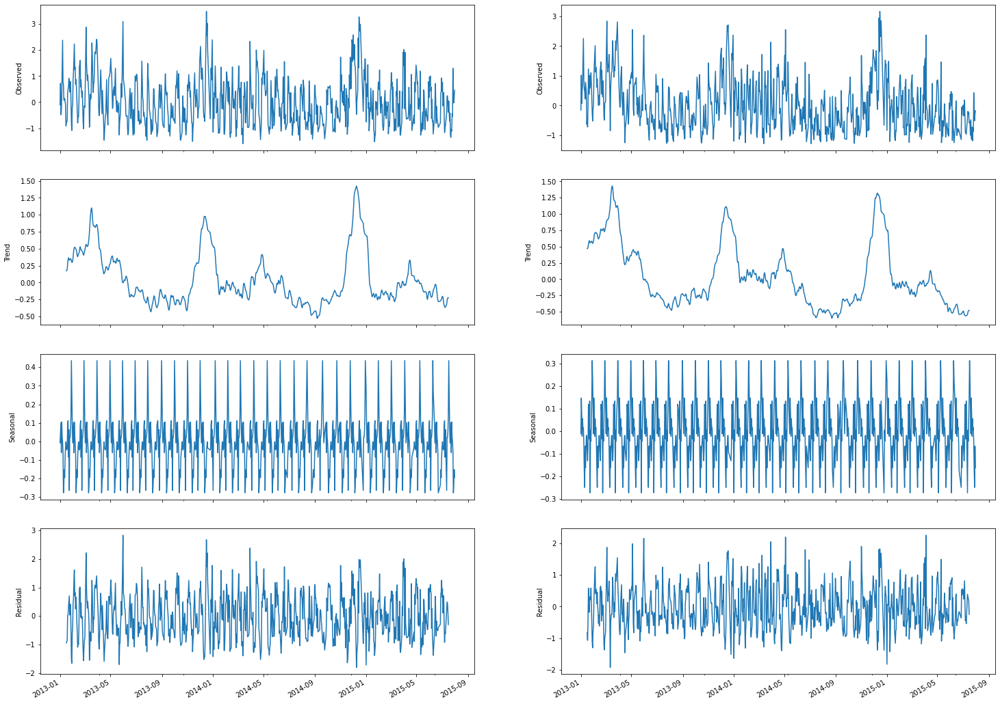

Decomposition Plot For : 3


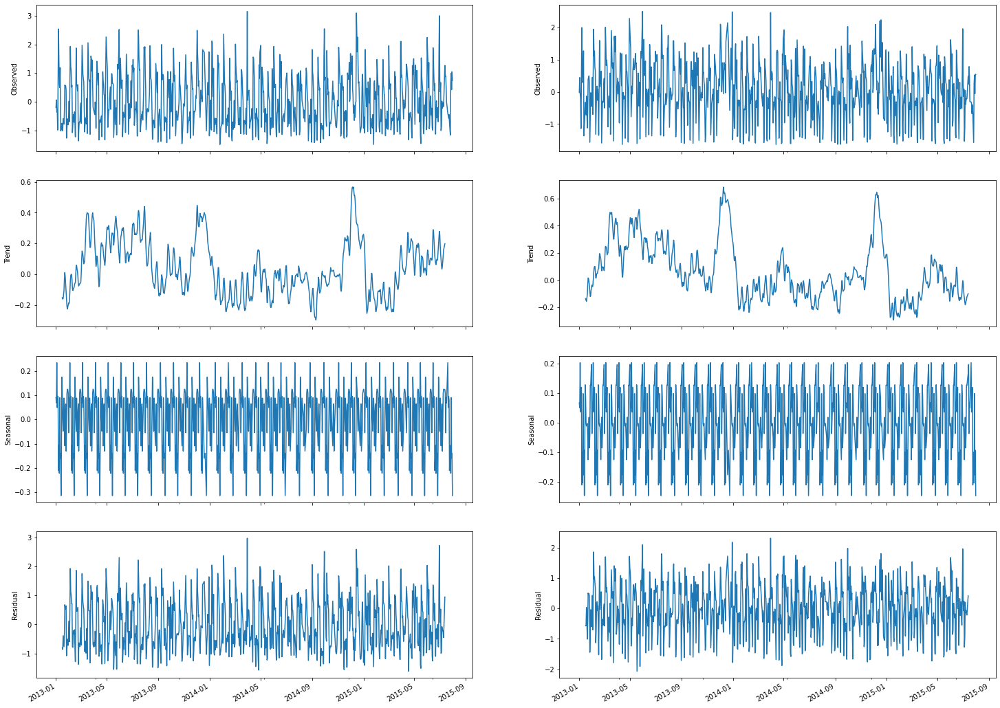

Decomposition Plot For : 8


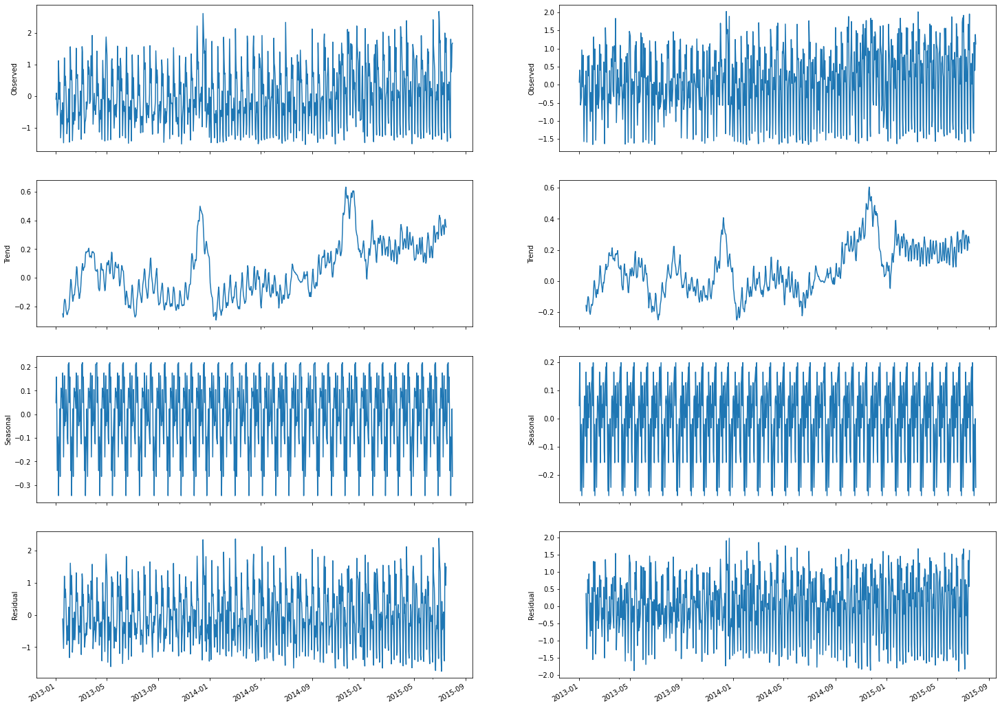

Decomposition Plot For : 9


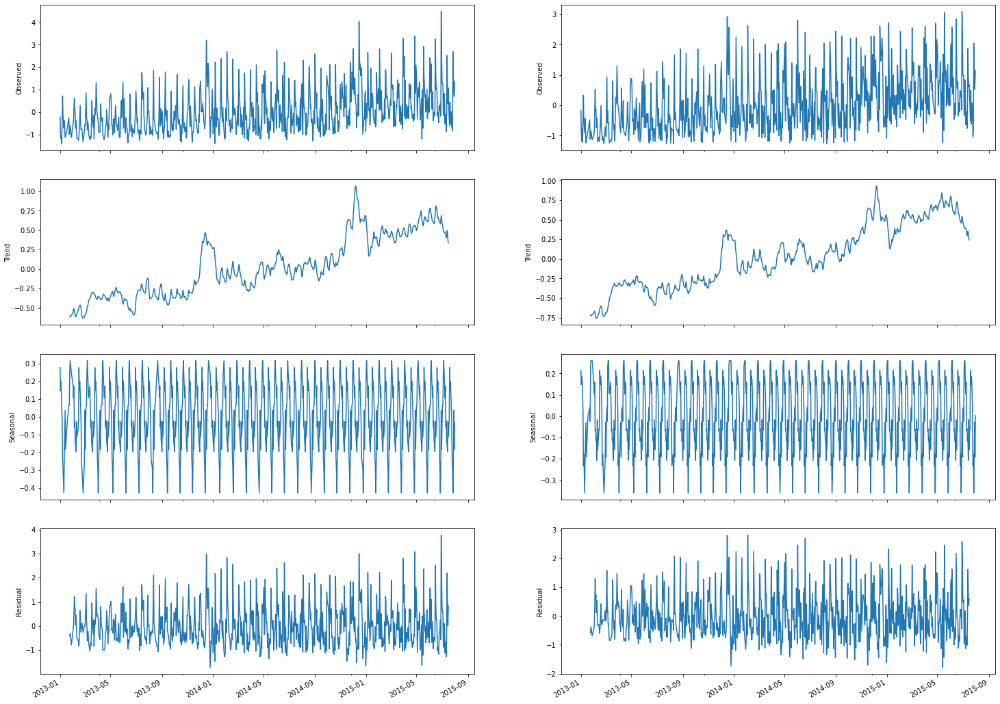

Decomposition Plot For : 13


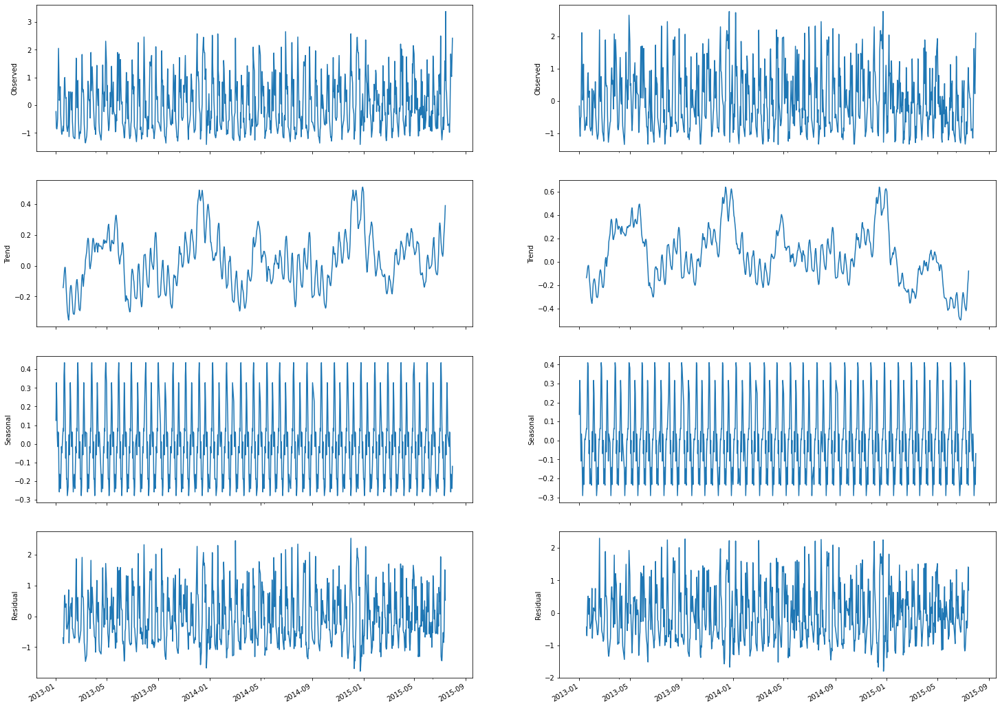

Decomposition Plot For : 25


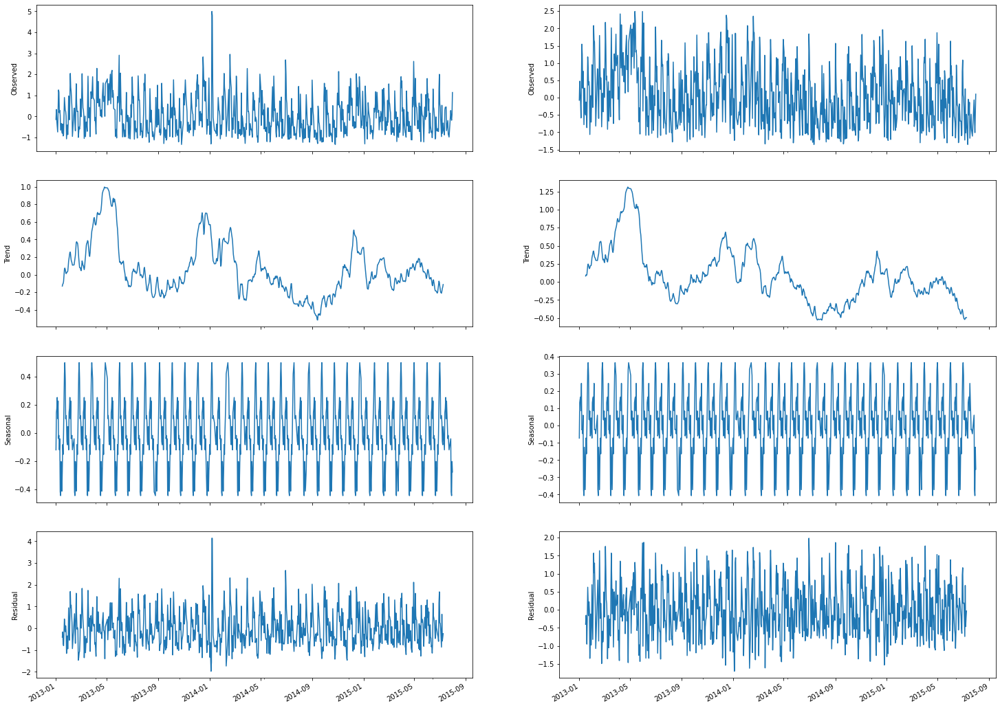

Decomposition Plot For : 29


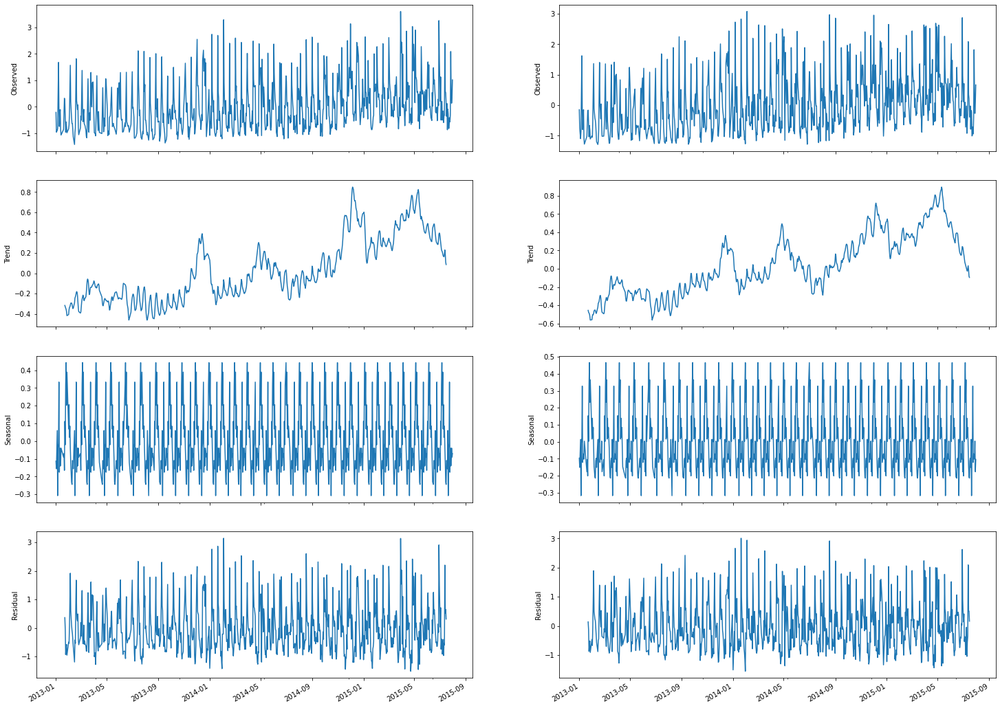

Decomposition Plot For : 31


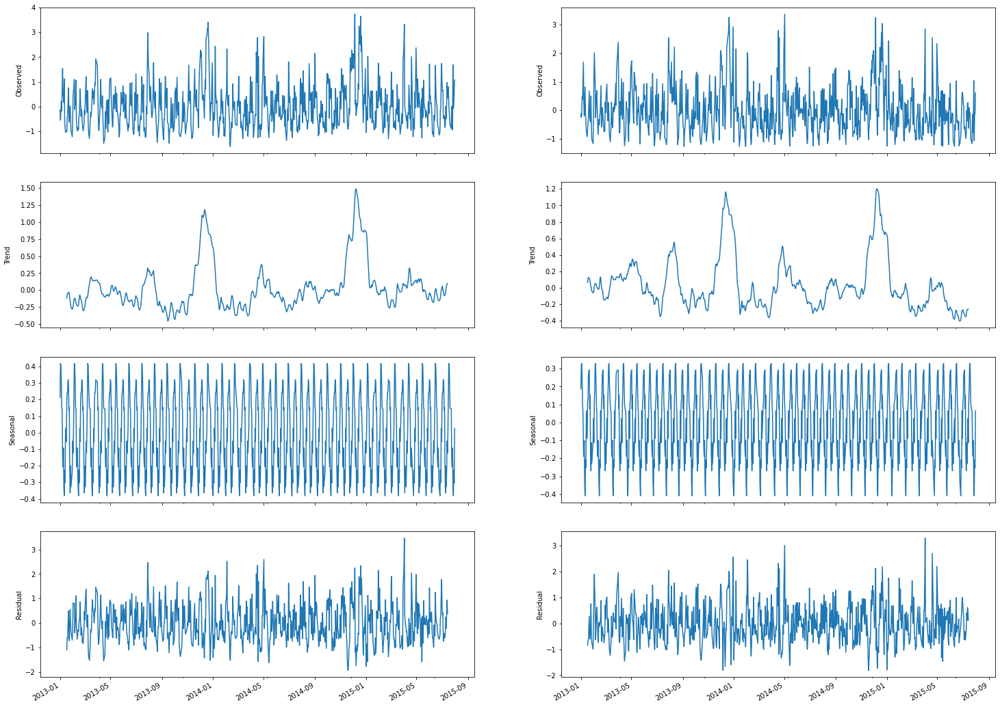

Decomposition Plot For : 46


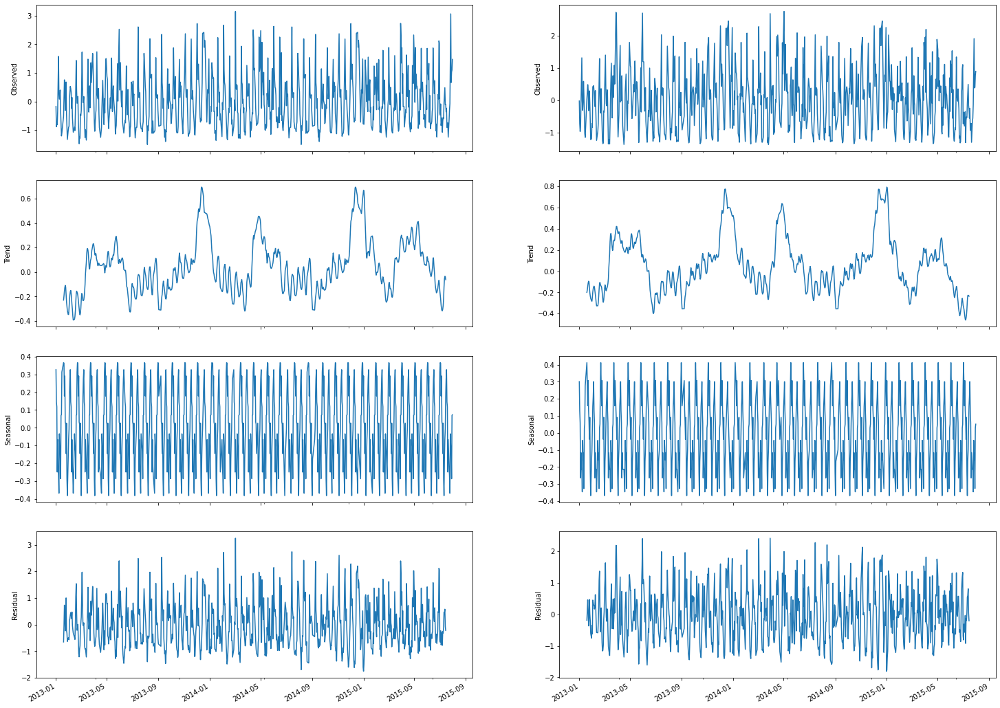

In [34]:
rcParams['figure.figsize'] = 12, 8
plt.figure(figsize=(20,30))
counter = 1
for i , j in store_df_dict.items():
        fig, axes = plt.subplots(ncols=2, nrows=4, sharex=True, figsize=(25,20))
        print("Decomposition Plot For : "+str(i))
        sales_decomposition = sm.tsa.seasonal_decompose(j['Sales'], model='additive',freq=30)
        customers_decomposition = sm.tsa.seasonal_decompose(j['Customers'], model='additive',freq=30)
        plotseasonal(sales_decomposition ,axes[:,0] , 'Sales')
        plotseasonal(customers_decomposition ,axes[:,1] , 'Customers')
        plt.show()


<h5 style='color:blue'> We will be using KPSS test </h5>
    <span style='color:blue'>Null Hypothesis (H0): The series is stationary <br/>
        p−value>0.05 <br/>
    Alternate Hypothesis (H1): The series is not stationary <br/>
        p−value≤0.05 <br/> </span>
<h5 style='color:red'> We will be using Adfuller test </h5>
    <span style='color:red'>   Null Hypothesis (H0): The series is not stationary <br/>
        p−value>0.05 <br/>
    Alternate Hypothesis (H1): The series is stationary <br/>
        p−value≤0.05</span>

In [35]:
create_diffrencing_boxcox(store_df_dict)

In [36]:
display(kpss_result(store_df_dict,'Sales'))
display(kpss_result(store_df_dict,'Customers'))

,KPSS_Statistic,P_Value,10%,5%,2.5%,1%
Store_1,0.275226,0.100000,0.347,0.463,0.574,0.739
Store_3,0.174964,0.100000,0.347,0.463,0.574,0.739
Store_8,1.301472,0.010000,0.347,0.463,0.574,0.739
Store_9,2.964877,0.010000,0.347,0.463,0.574,0.739
Store_13,0.201832,0.100000,0.347,0.463,0.574,0.739
Store_25,0.534886,0.033809,0.347,0.463,0.574,0.739
Store_29,2.396679,0.010000,0.347,0.463,0.574,0.739
Store_31,0.189130,0.100000,0.347,0.463,0.574,0.739
Store_46,0.217372,0.100000,0.347,0.463,0.574,0.739


,KPSS_Statistic,P_Value,10%,5%,2.5%,1%
Store_1,0.654430,0.017688,0.347,0.463,0.574,0.739
Store_3,0.629685,0.019938,0.347,0.463,0.574,0.739
Store_8,1.141707,0.010000,0.347,0.463,0.574,0.739
Store_9,3.147980,0.010000,0.347,0.463,0.574,0.739
Store_13,0.240845,0.100000,0.347,0.463,0.574,0.739
Store_25,1.238041,0.010000,0.347,0.463,0.574,0.739
Store_29,2.384404,0.010000,0.347,0.463,0.574,0.739
Store_31,0.124357,0.100000,0.347,0.463,0.574,0.739
Store_46,0.066607,0.100000,0.347,0.463,0.574,0.739


In [37]:
display(kpss_result(store_df_dict,'lnSales'))
display(kpss_result(store_df_dict,'lnCustomers'))

,KPSS_Statistic,P_Value,10%,5%,2.5%,1%
Store_1,0.073697,0.100000,0.347,0.463,0.574,0.739
Store_3,0.182392,0.100000,0.347,0.463,0.574,0.739
Store_8,0.795965,0.010000,0.347,0.463,0.574,0.739
Store_9,0.809979,0.010000,0.347,0.463,0.574,0.739
Store_13,0.116810,0.100000,0.347,0.463,0.574,0.739
Store_25,0.140439,0.100000,0.347,0.463,0.574,0.739
Store_29,0.047127,0.100000,0.347,0.463,0.574,0.739
Store_31,0.127693,0.100000,0.347,0.463,0.574,0.739
Store_46,0.404870,0.075056,0.347,0.463,0.574,0.739


,KPSS_Statistic,P_Value,10%,5%,2.5%,1%
Store_1,0.109339,0.100000,0.347,0.463,0.574,0.739
Store_3,0.118739,0.100000,0.347,0.463,0.574,0.739
Store_8,1.000992,0.010000,0.347,0.463,0.574,0.739
Store_9,0.472134,0.047943,0.347,0.463,0.574,0.739
Store_13,0.273294,0.100000,0.347,0.463,0.574,0.739
Store_25,0.382600,0.084655,0.347,0.463,0.574,0.739
Store_29,0.170879,0.100000,0.347,0.463,0.574,0.739
Store_31,0.038173,0.100000,0.347,0.463,0.574,0.739
Store_46,0.029781,0.100000,0.347,0.463,0.574,0.739


In [38]:
display(kpss_result(store_df_dict,'dlnSales'))
display(kpss_result(store_df_dict,'dlnCustomers'))

,KPSS_Statistic,P_Value,10%,5%,2.5%,1%
Store_1,0.087532,0.10000,0.347,0.463,0.574,0.739
Store_3,1.039838,0.01000,0.347,0.463,0.574,0.739
Store_8,0.309396,0.10000,0.347,0.463,0.574,0.739
Store_9,0.140589,0.10000,0.347,0.463,0.574,0.739
Store_13,0.031572,0.10000,0.347,0.463,0.574,0.739
Store_25,0.140089,0.10000,0.347,0.463,0.574,0.739
Store_29,0.142133,0.10000,0.347,0.463,0.574,0.739
Store_31,0.528134,0.03533,0.347,0.463,0.574,0.739
Store_46,0.036059,0.10000,0.347,0.463,0.574,0.739


,KPSS_Statistic,P_Value,10%,5%,2.5%,1%
Store_1,0.083982,0.100000,0.347,0.463,0.574,0.739
Store_3,0.707681,0.012847,0.347,0.463,0.574,0.739
Store_8,0.114130,0.100000,0.347,0.463,0.574,0.739
Store_9,0.366768,0.091479,0.347,0.463,0.574,0.739
Store_13,0.091501,0.100000,0.347,0.463,0.574,0.739
Store_25,0.445079,0.057724,0.347,0.463,0.574,0.739
Store_29,0.229441,0.100000,0.347,0.463,0.574,0.739
Store_31,0.248826,0.100000,0.347,0.463,0.574,0.739
Store_46,0.074345,0.100000,0.347,0.463,0.574,0.739


#### As we can see that P-Value has increased significantly and dlnSales , dlnCustomers are are stationary series

In [39]:
rcParams['figure.figsize'] = 20, 15

def create_plot(series, label , counter):
    plt.figure(figsize=(20,4))
    plt.plot(series, label=label)
    plt.legend(loc='best')
    plt.title(label)
    plt.show()



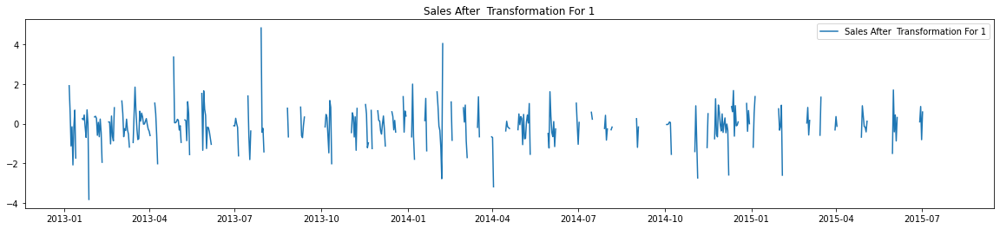

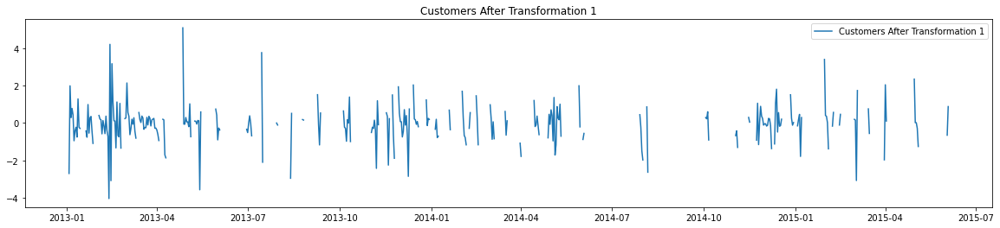

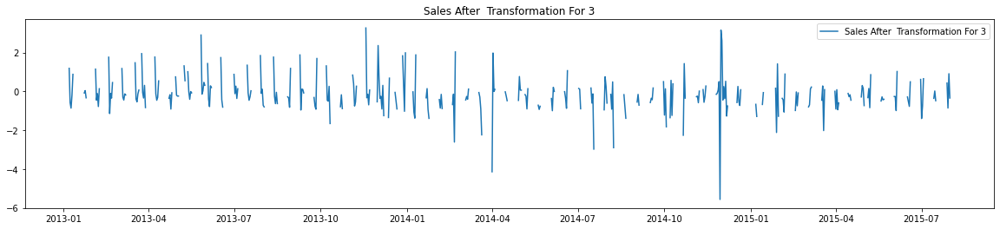

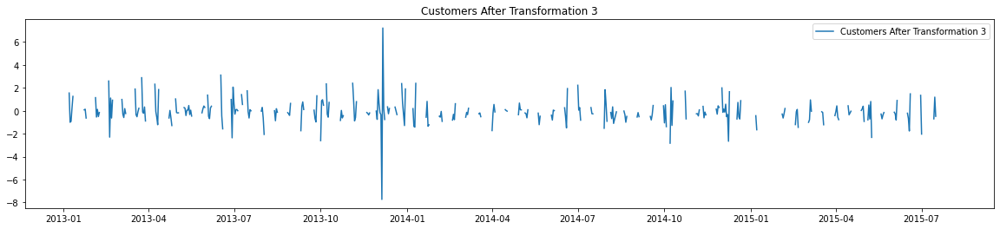

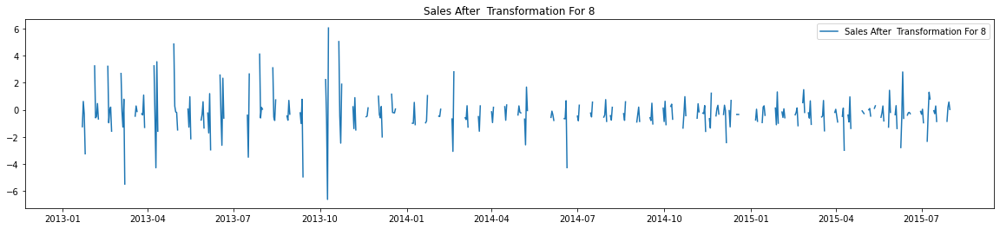

...

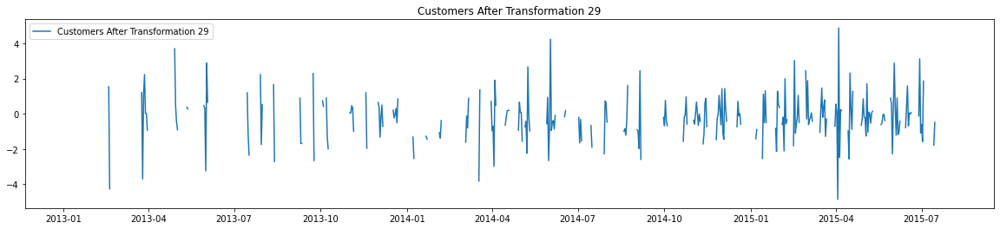

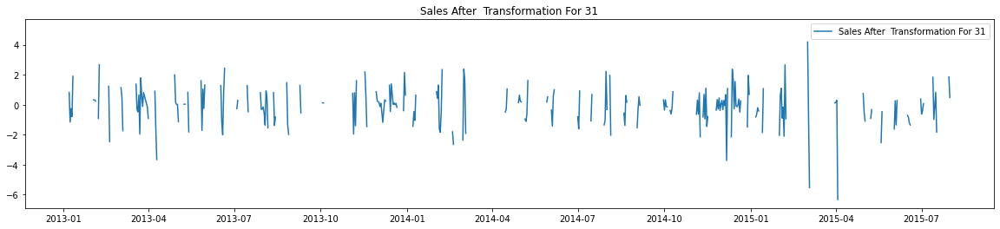

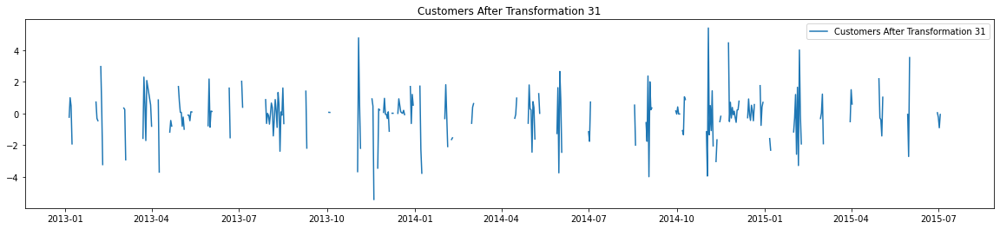

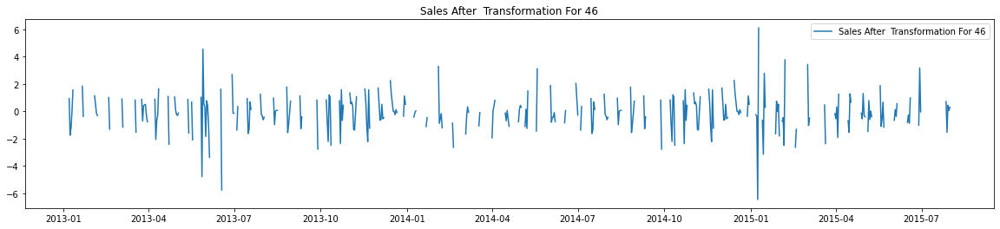

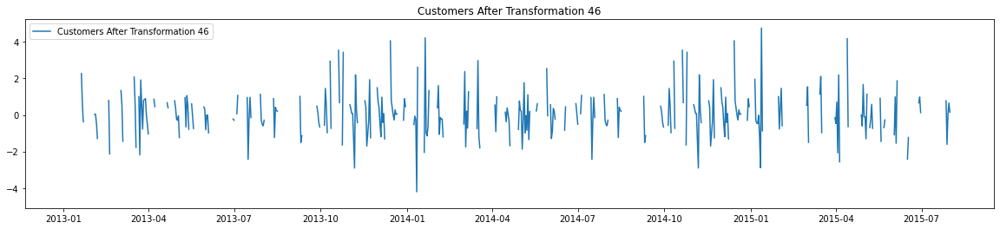

In [40]:
for k , v in store_df_dict.items():
    create_plot(v['dlnSales'],"Sales After  Transformation For %i"%k,k)
    create_plot(v['dlnCustomers'],"Customers After Transformation %i"%k,k)


In [41]:
#from scipy.stats import boxcox
#i = 1
#for k , v in store_data_for_diff.items():
#    sales_data_boxcox = pd.Series(boxcox(v.df['Sales'], lmbda=0), index = v.df.index)
#    create_plot(sales_data_boxcox,"Sales After Box Cox Transformation For %i"%k,k)
#    i+=1
#    v.df['sales_box_cox'] = sales_data_boxcox
#    sales_data_boxcox_diff = pd.Series(sales_data_boxcox - sales_data_boxcox.shift(), v.df.index)
#    create_plot(sales_data_boxcox_diff,"Sales After Box Cox Transformation And Diffrencing For %i"%k,k)
#   sales_data_boxcox_diff[sales_data_boxcox_diff.iloc[:1].index] = sales_data_boxcox.head(1).item()
#    i+=1
#    v.df['sales_box_cox_diff'] = sales_data_boxcox_diff


In [42]:
#for k , v in store_data_for_diff.items():
#    customer_data_boxcox = pd.Series(boxcox(v.df['Customers'], lmbda=0), index = v.df.index)
#    create_plot(sales_data_boxcox,"Sales After Box Cox Transformation For %i"%k,k)
#    i+=1
#    v.df['customers_box_cox'] = customer_data_boxcox
#    customer_data_boxcox_diff = pd.Series(sales_data_boxcox - sales_data_boxcox.shift(), v.df.index)
#    create_plot(sales_data_boxcox_diff,"Sales After Box Cox Transformation And Diffrencing For %i"%k,k)
#    sales_data_boxcox_diff[sales_data_boxcox_diff.iloc[:1].index] = sales_data_boxcox.head(1).item()
#    i+=1
#    v.df['customers_box_cox_diff'] = customer_data_boxcox_diff


<h4> Now we can see that P-Value is more than 0.05 thus making sales time series stationary (For KPSS) </h4>

# Now for each we will be performing test train split

In [43]:
store_model_dict = {}

In [44]:
class StoreModel():
    
    def __init__(self , model , performace_matrix):
        self.model = model
        self.performace_matrix = performace_matrix
        

In [45]:
def get_train_test_data(df , train):
    total = len(df.index)
    train_size = train
    train_index = int((total * train_size) /100)
    store_id_1_train = df[:train_index]
    store_id_1_test = df[train_index:]
    return store_id_1_train , store_id_1_test , (0,train_index) , (train_index,total-1)

def reset_index(df):
    #df.set_index("index_date",inplace=True)
    df = df.asfreq('d')
    df[stores_target_variables] = df[stores_target_variables].replace(np.nan,df[stores_target_variables].median())
    return df

def declare_var_model_without_exogeneous_variable(train_df , test_df , target_variables , trend):
    mod = sm.tsa.VARMAX(train_df[target_variables], order=(1,0) , trend=trend)
    res = mod.fit(maxiter=1000, disp=False)
    print(res.summary())
    predictions = mod.fit().predict(start=test_df.index.min(), end=test_df.index.max())
    #display(predictions)
    #plot_graph(train_df , test_df ,predictions, target_variables, 'VAR Model (Without Exogeneous)')
    return mod , res , predictions

def get_high_corelation_variables(df , target_variables):
    features = list()
    for i in range(0,len(target_variables)):
        cor = df.corr()
        cor_target = abs(cor[target_variables[i]])
        relevant_features = cor_target[cor_target>0.3]
        features.append(set(relevant_features.index.tolist()).difference(target_variables))
    return [y for x in features for y in x]
    
    
def plot_graph(train_df , test_df , pred_df , target_variable , title):
    plt.figure(figsize=(25,20))
    counter = 1
    for i in range(0,len(target_variable)):
        plt.subplot(2,1,counter)
        plt.plot( train_df[target_variable[i]], label='Train')
        plt.plot(test_df[target_variable[i]], label='Test')
        plt.plot(pred_df[target_variable[i]], label='VAR')
        plt.legend(loc='best')
        plt.title(label=title+" - "+target_variable[i])
        counter = counter +1
    plt.show()
        

def varmax_model(train_df , test_df , target_variables , exog_variables , trend):
    if(len(exog_variables) == 1): 
        train_exog = train_df[exog_variables[0]]
        test_exog = test_df[exog_variables[0]]
    else:
        train_exog = train_df[exog_variables]
        test_exog = test_df[exog_variables]
    mod = sm.tsa.VARMAX(train_df[target_variables], order=(1,1) ,exog=train_exog ,trend=trend)
    res = mod.fit(maxiter=1000, disp=False)
    print(res.summary())
    predictions = mod.fit().predict(start=test_df.index.min(), end=test_df.index.max() , exog=test_exog)
    return mod , res , predictions

def map_performace_matrix(test_df , pred_df , columns , model_type , store_id):
    performace_matrix = []
    for i in range(0,len(columns)) :
        column =  columns[i]
        rmse = np.sqrt(mean_squared_error(test_df[column], pred_df[column])).round(2)
        abs_error = np.abs(test_df[column]-pred_df[column])
        actual = test_df[column]
        mape = np.round(np.mean(abs_error/actual)*100, 2)
        performace_matrix.append({'model':model_type , 'variable':column,'rmse':rmse,'mape':mape , 'store_id':store_id})
    return performace_matrix

def predict_next_six_weeks(start_index , end_index , model , exog):
    if(exog == -1):
        predictions = model.fit().predict(start=start_index, end=end_index)
    else:
        predictions = model.fit().predict(start=start_index, end=end_index, exog=test_exog)
    return predictions

def joh_output(res):
    output = pd.DataFrame([res.lr2,res.lr1],
                          index=['max_eig_stat',"trace_stat"])
    print(output.T,'\n')
    print("Critical values(90%, 95%, 99%) of max_eig_stat\n",res.cvm,'\n')
    print("Critical values(90%, 95%, 99%) of trace_stat\n",res.cvt,'\n')
    
    
def add_prediction_values(pred_df,train_df, test_df,sales_index,customer_index):
    for i in range(pred_df.shape[0]):
        if i==0:
            pred_df.loc[pred_df.index==test_df.index.min(),'laglnSales']=train_df.iloc[sales_index[0],sales_index[1]]
            pred_df.loc[pred_df.index==test_df.index.min(),'laglnCustomers']=train_df.iloc[customer_index[0],customer_index[1]]
        else:
            pred_df.iloc[i,2]=pred_df.iloc[i-1,4]
            pred_df.iloc[i,3]=pred_df.iloc[i-1,5]

        pred_df['lnSales']=(pred_df['laglnSales']+pred_df['dlnSales'])
        pred_df['lnCustomers']=(pred_df['laglnCustomers']+pred_df['dlnCustomers'])
        pred_df['Sales']=np.exp(pred_df['lnSales'])
        pred_df['Customers']=np.exp(pred_df['lnCustomers'])
    return pred_df

def add_prediction_values_future(pred_df, six_weeks, test_df, sales_index , customer_index):
    for i in range(store_1_next_six_weeks_prediction.shape[0]):
        if i==0:
            pred_df.loc[pred_df.index==six_weeks.min(),'laglnSales']=test_df.iloc[sales_index[0],sales_index[1]]
            pred_df.loc[pred_df.index==six_weeks.min(),'laglnCustomers']=test_df.iloc[customer_index[0],customer_index[1]]
        else:
            pred_df.iloc[i,2]=pred_df.iloc[i-1,4]
            pred_df.iloc[i,3]=pred_df.iloc[i-1,5]
        pred_df['lnSales']=(pred_df['laglnSales']+pred_df['dlnSales'])
        pred_df['lnCustomers']=(pred_df['laglnCustomers']+pred_df['dlnCustomers'])

        pred_df['Sales']=np.exp(pred_df['lnSales'])
        pred_df['Customers']=np.exp(pred_df['lnCustomers'])
    return pred_df



In [46]:
###store_id_1['index_date'] = store_id_1['index_date'].apply(lambda x : datetime.strptime(str(x), '%Y-%m-%d %H:%M:%S'))


###  Create Model For Store 1

In [47]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [48]:
store_id_1 = store_df_dict.get(1)

In [49]:
store_id_1 = reset_index(store_id_1)
store_id_1_train , store_id_1_test , store_id_1_train_index , store_id_1_test_index   = get_train_test_data(store_id_1,80)
store_id_1_without_exog_model , store_id_1_without_exog_res , store_id_1_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_1_train , store_id_1_test  , ['dlnSales','dlnCustomers'],'n')
store_id_1_without_exog_pred = add_prediction_values(store_id_1_without_exog_pred,store_id_1_train,store_id_1_test,(752,10),(752,11))

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1361.675
Date:                          Sun, 18 Apr 2021   AIC                           2737.350
Time:                                  13:36:17   BIC                           2769.719
Sample:                              01-01-2013   HQIC                          2749.820
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.54, 0.11   Jarque-Bera (JB):     6834.98, 6725.47
Prob(Q):                        0.46, 0.74   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         0.48, 0.29   Skew:                      0.64, -0.29
Prob(H) (two-sided):            0.00

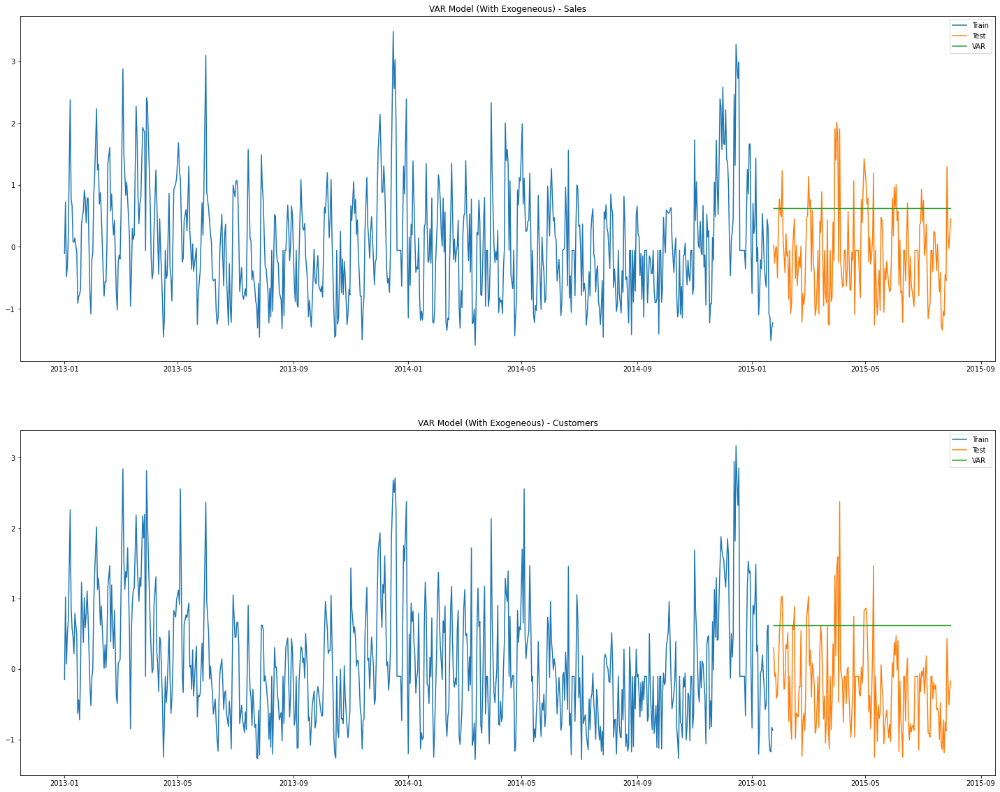

In [50]:
plot_graph(store_id_1_train , store_id_1_test , store_id_1_without_exog_pred , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [51]:
store_id_1_var_model_performace_matrix = map_performace_matrix(store_id_1_test , store_id_1_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 1")
display(store_id_1_var_model_performace_matrix)
store_model_dict['Store_1_VAR_Without_Exog'] = StoreModel(store_id_1_without_exog_model , store_id_1_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 1.0,
  'mape': -438.92,
  'store_id': 'Store 1'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.05,
  'mape': -256.96,
  'store_id': 'Store 1'}]

### Now lets predict sales for next six weeks 

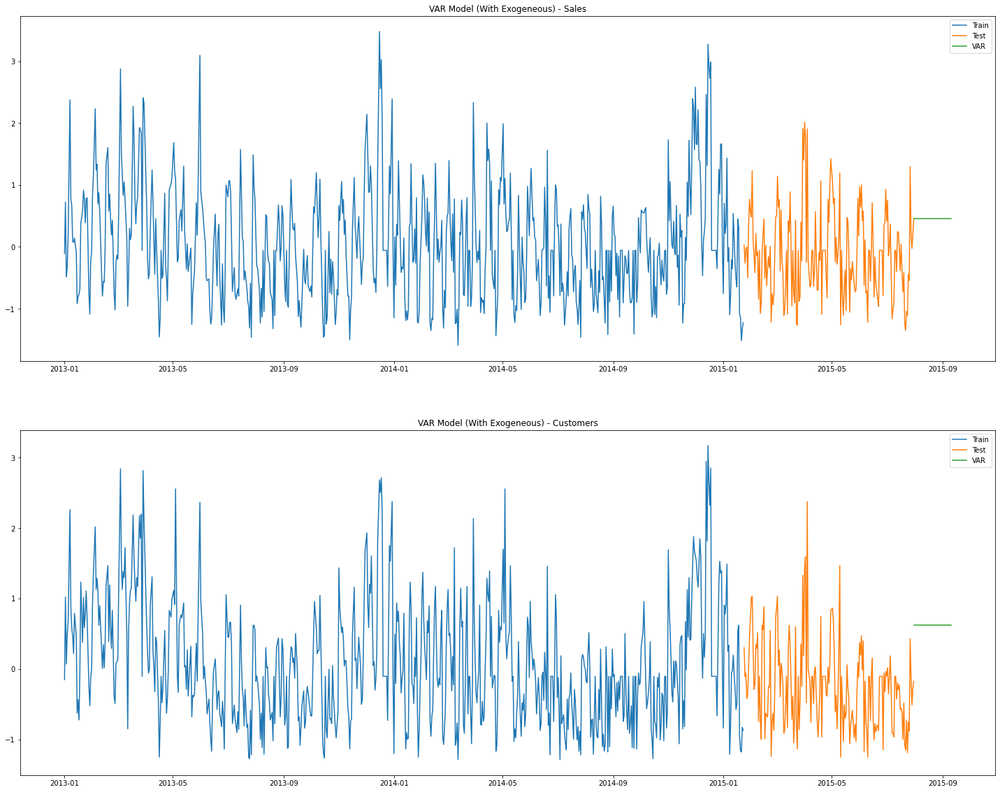

In [52]:
store_1_next_six_weeks = pd.date_range(store_id_1_test.index.max(), periods=42)
store_1_next_six_weeks_prediction = store_id_1_without_exog_model.fit().predict(start=store_1_next_six_weeks.min(), end=store_1_next_six_weeks.max())
store_1_next_six_weeks_prediction = add_prediction_values_future(store_1_next_six_weeks_prediction , store_1_next_six_weeks , store_id_1_test , (188,10),(188,11))
plot_graph(store_id_1_train , store_id_1_test , store_1_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [53]:
joh_model_store_1_var = coint_johansen(store_id_1_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_1_var)

   max_eig_stat  trace_stat
0    266.860579  346.038076
1     79.177497   79.177497 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



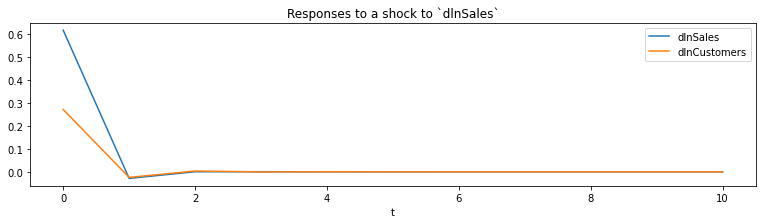

In [54]:
ax = store_id_1_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 1

### Now lets prepare using VARMAX model

In [55]:
store_id_1_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,0.033664,0.120409
Sales,0.179877,0.087066
Customers,0.169353,0.129277
Promo,-0.073068,-0.108303
SchoolHoliday,0.008568,-0.026905
Year,-0.019628,-0.018975
Month,-0.001018,-0.000685
Day,0.093470,0.102498
WeekOfYear,-0.003628,0.004402
lnSales,0.513236,0.164684


In [56]:
#store_id_1_train['Day'] = store_id_1_train.index.day
store_id_1_train['DayOfWeek'] = store_id_1_train.index.dayofweek

#store_id_1_test['Day'] = store_id_1_test.index.day
store_id_1_test['DayOfWeek'] = store_id_1_test.index.dayofweek

In [57]:
store_id_1_varmax_model , store_id_1_varmax_res , store_id_1_varmax_pred  = varmax_model(store_id_1_train , store_id_1_test  , ['dlnSales','dlnCustomers'],['DayOfWeek'],'c')
store_id_1_varmax_pred = add_prediction_values(store_id_1_varmax_pred , store_id_1_train , store_id_1_test , (752,10) , (752,11))

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1329.754
                                    + intercept   AIC                           2689.508
Date:                          Sun, 18 Apr 2021   BIC                           2758.869
Time:                                  13:36:36   HQIC                          2716.230
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.02, 0.30   Jarque-Bera (JB):     6807.36, 6567.68
Prob(Q):                        0.88, 0.59   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

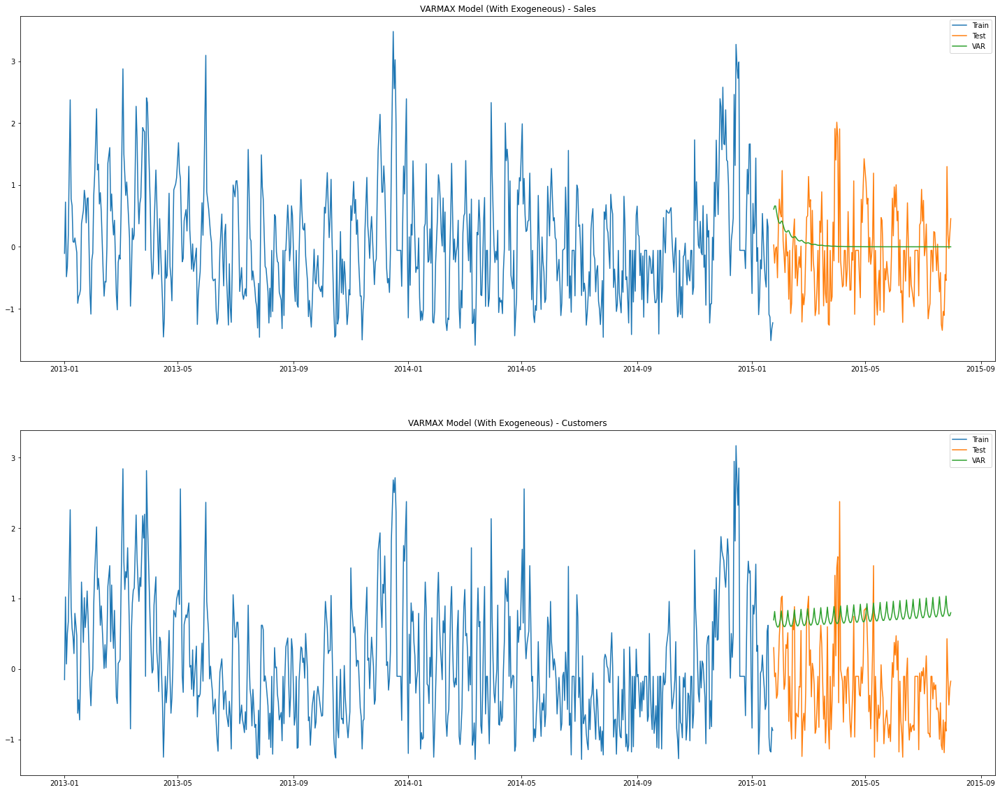

In [58]:
plot_graph(store_id_1_train , store_id_1_test , store_id_1_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [59]:
store_id_1_performace_matrix = map_performace_matrix(store_id_1_test , store_id_1_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)' , "Store 1")
display(store_id_1_performace_matrix)
store_model_dict['Store_1_VARMAX_With_Exog'] = StoreModel(store_id_1_varmax_pred , store_id_1_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.72,
  'mape': -139.91,
  'store_id': 'Store 1'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.16,
  'mape': -318.2,
  'store_id': 'Store 1'}]

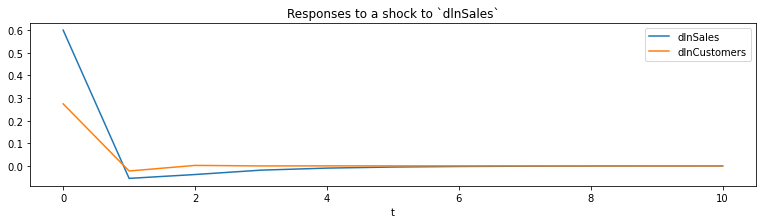

In [60]:
ax = store_id_1_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 3

In [61]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [62]:
store_id_3 = store_df_dict.get(3)
store_id_3 = reset_index(store_id_3)
store_id_3_train , store_id_3_test , store_id_3_train_index , store_id_3_test_index   = get_train_test_data(store_id_3,80)

In [63]:
print("store_id_3_train : ",store_id_3_train.shape)
print("store_id_3_test : ",store_id_3_test.shape)
print("Column List : ",store_id_3_train.columns)

store_id_3_train :  (753, 16)
store_id_3_test :  (189, 16)
Column List :  Index(['PromoInterval', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo',
       'SchoolHoliday', 'Year', 'Month', 'Day', 'WeekOfYear', 'Is_Promo_Month',
       'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1447.293
Date:                          Sun, 18 Apr 2021   AIC                           2908.585
Time:                                  13:36:45   BIC                           2940.954
Sample:                              01-01-2013   HQIC                          2921.055
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):            12.97, 0.56   Jarque-Bera (JB):   12232.91, 63330.77
Prob(Q):                        0.00, 0.45   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         1.68, 1.19   Skew:                     -0.08, -2.75
Prob(H) (two-sided):            0.00

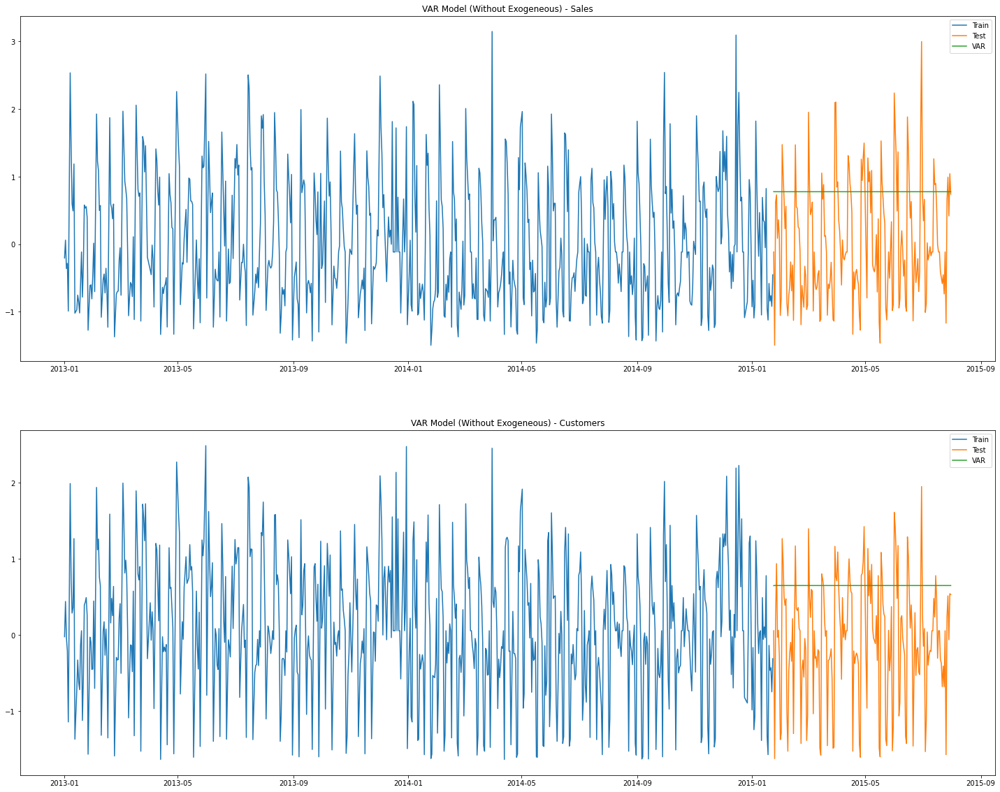

In [64]:
store_id_3_without_exog_model , store_id_3_without_exog_res , store_id_3_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_3_train , store_id_3_test  , ['dlnSales','dlnCustomers'],'n')
store_id_3_without_exog_pred = add_prediction_values(store_id_3_without_exog_pred,store_id_3_train , store_id_3_test,(752,12),(752,13))
plot_graph(store_id_3_train , store_id_3_test , store_id_3_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [65]:
store_id_3_var_model_performace_matrix = map_performace_matrix(store_id_3_test , store_id_3_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 3")
display(store_id_3_var_model_performace_matrix)
store_model_dict['Store_3_VAR_Without_Exog'] = StoreModel(store_id_3_without_exog_model , store_id_3_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 1.13,
  'mape': -214.91,
  'store_id': 'Store 3'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.05,
  'mape': -72.85,
  'store_id': 'Store 3'}]

### Now lets predict sales for next six weeks 

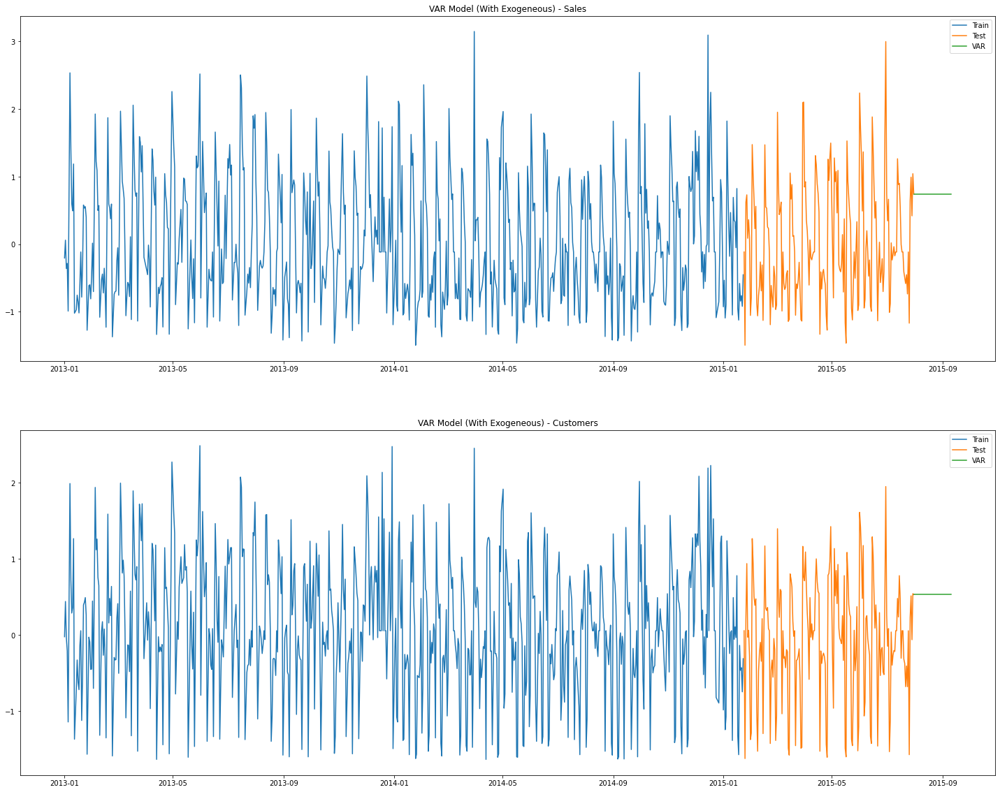

In [66]:
store_3_next_six_weeks = pd.date_range(store_id_3_test.index.max(), periods=42)
store_3_next_six_weeks_prediction = store_id_3_without_exog_model.fit().predict(start=store_3_next_six_weeks.min(), end=store_3_next_six_weeks.max())
store_3_next_six_weeks_prediction = add_prediction_values_future(store_3_next_six_weeks_prediction , store_3_next_six_weeks , store_id_3_test , (188,12),(188,13))
plot_graph(store_id_3_train , store_id_3_test , store_3_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [67]:
joh_model_store_3_var = coint_johansen(store_id_3_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_3_var)

   max_eig_stat  trace_stat
0    322.265902  452.871151
1    130.605249  130.605249 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



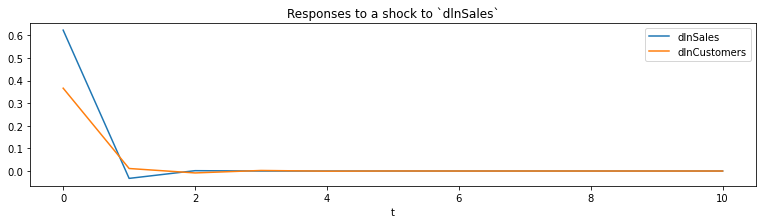

In [68]:
ax = store_id_3_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 3

### Now lets prepare using VARMAX model

In [69]:
store_id_3_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,-0.108008,-0.050862
Sales,0.245393,0.176202
Customers,0.232937,0.194694
Promo,0.072351,0.056096
SchoolHoliday,-0.004512,-0.003114
Year,-0.141511,-0.082248
Month,0.020196,0.019406
Day,0.012690,0.024743
WeekOfYear,0.005760,0.008359
Is_Promo_Month,-0.032931,0.018219


In [70]:
store_id_3_train['Promo'] = store_id_3_train['Promo'].replace(np.nan , 0)
store_id_3_test['Promo'] = store_id_3_test['Promo'].replace(np.nan , 0)
store_id_3_train['DayOfWeek'] = store_id_3_train.index.dayofweek
store_id_3_test['DayOfWeek'] = store_id_3_test.index.dayofweek

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1373.697
                                    + intercept   AIC                           2781.394
Date:                          Sun, 18 Apr 2021   BIC                           2860.003
Time:                                  13:37:23   HQIC                          2811.678
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):            11.43, 0.02   Jarque-Bera (JB):   10430.13, 63220.37
Prob(Q):                        0.00, 0.89   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

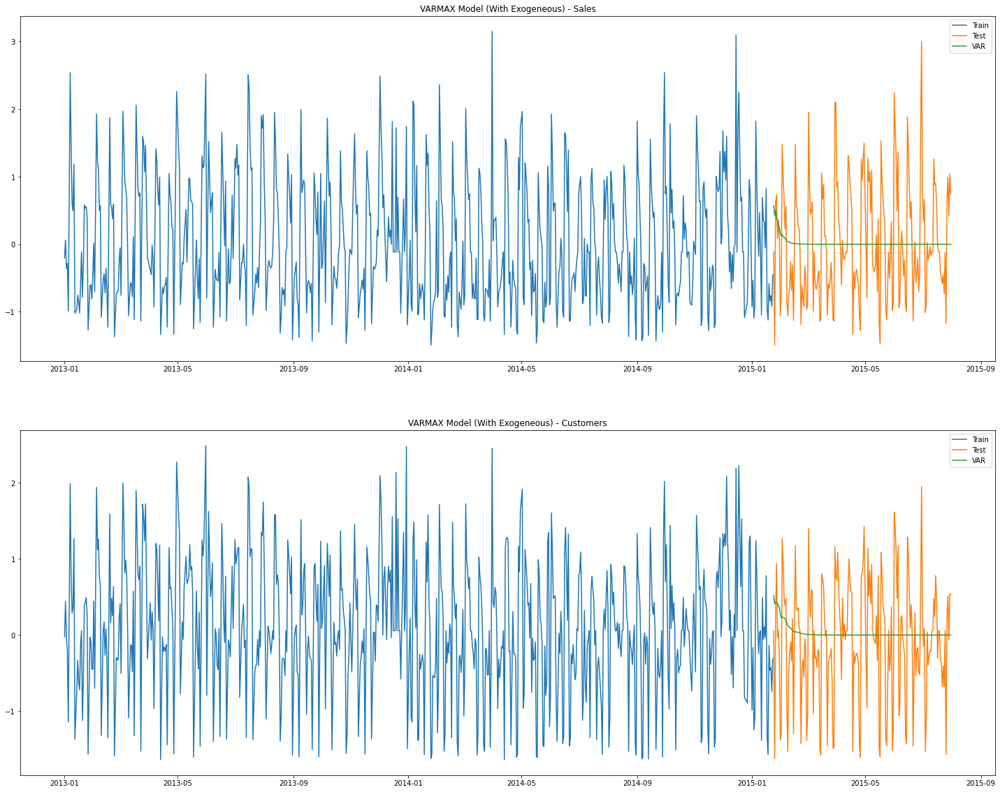

In [71]:
store_id_3_varmax_model , store_id_3_varmax_res , store_id_3_varmax_pred  = varmax_model(store_id_3_train , store_id_3_test  , ['dlnSales','dlnCustomers'],['Promo','DayOfWeek'],'c')
store_id_3_varmax_pred = add_prediction_values(store_id_3_varmax_pred,store_id_3_train , store_id_3_test,(752,12),(752,13))
plot_graph(store_id_3_train , store_id_3_test , store_id_3_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [72]:
store_id_3_performace_matrix = map_performace_matrix(store_id_3_test , store_id_3_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 3")
display(store_id_1_performace_matrix)
store_model_dict['Store_3_VARMAX_With_Exog'] = StoreModel(store_id_3_varmax_model , store_id_3_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.72,
  'mape': -139.91,
  'store_id': 'Store 1'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.16,
  'mape': -318.2,
  'store_id': 'Store 1'}]

In [73]:
joh_model_store_3_var = coint_johansen(store_id_3_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_3_var)

   max_eig_stat  trace_stat
0    322.265902  452.871151
1    130.605249  130.605249 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



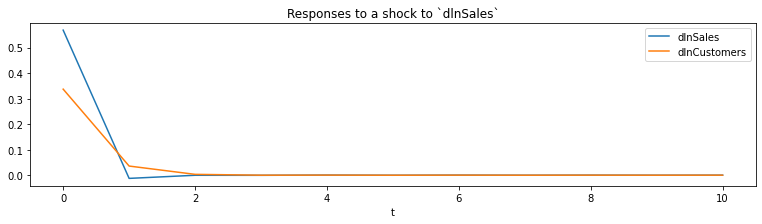

In [74]:
ax = store_id_3_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 8

In [75]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [76]:
store_id_8 = store_df_dict.get(8)
store_id_8 = reset_index(store_id_8)
store_id_8_train , store_id_8_test , store_id_8_train_index , store_id_8_test_index   = get_train_test_data(store_id_8,80)

In [77]:
print("store_id_8_train : ",store_id_8_train.shape)
print("store_id_8_test : ",store_id_8_test.shape)
print("Column List : ",store_id_8_train.columns)

store_id_8_train :  (753, 14)
store_id_8_test :  (189, 14)
Column List :  Index(['DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo', 'SchoolHoliday',
       'Year', 'Month', 'Day', 'WeekOfYear', 'lnSales', 'lnCustomers',
       'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1563.085
                                    + intercept   AIC                           3144.170
Date:                          Sun, 18 Apr 2021   BIC                           3185.787
Time:                                  13:37:32   HQIC                          3160.203
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             2.33, 1.02   Jarque-Bera (JB):    15868.09, 3421.57
Prob(Q):                        0.13, 0.31   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

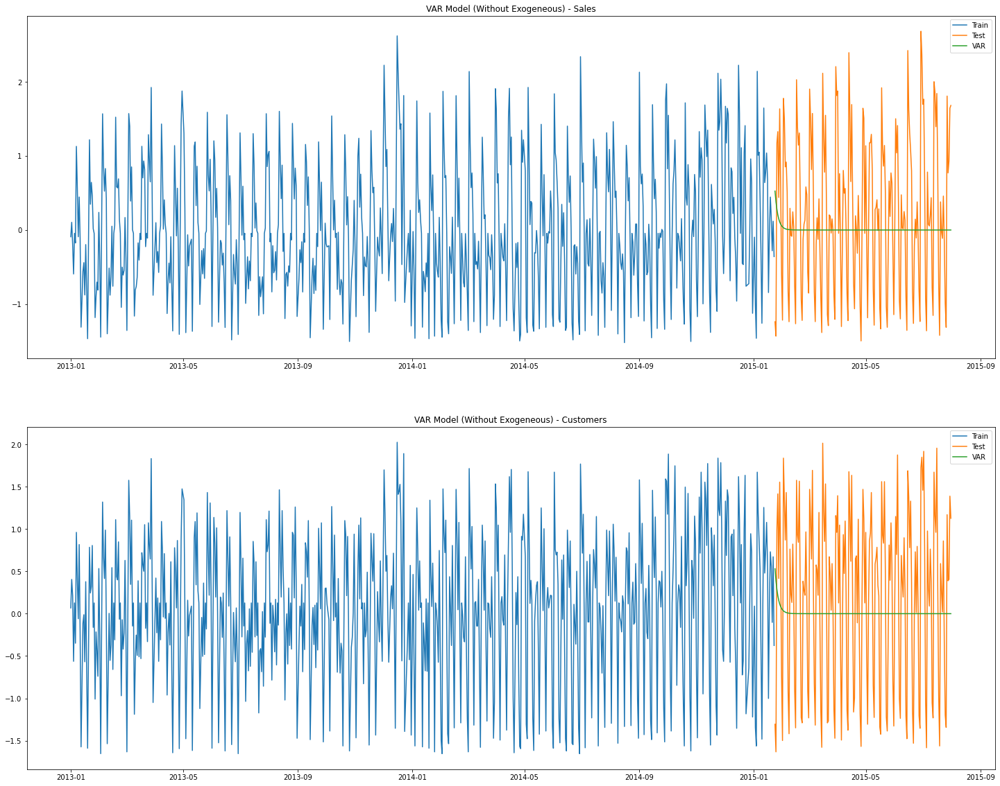

In [78]:
store_id_8_without_exog_model , store_id_8_without_exog_res , store_id_8_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_8_train , store_id_8_test  , ['dlnSales','dlnCustomers'],'c')
store_id_8_without_exog_pred = add_prediction_values(store_id_8_without_exog_pred,store_id_8_train , store_id_8_test,(752,12),(752,13))
plot_graph(store_id_8_train , store_id_8_test , store_id_8_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [79]:
store_id_8_var_model_performace_matrix = map_performace_matrix(store_id_8_test , store_id_8_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 8")
display(store_id_8_var_model_performace_matrix)
store_model_dict['Store_8_VAR_Without_Exog'] = StoreModel(store_id_8_without_exog_model , store_id_8_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 1.06,
  'mape': 16.43,
  'store_id': 'Store 8'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.05,
  'mape': 35.49,
  'store_id': 'Store 8'}]

### Now lets predict sales for next six weeks 

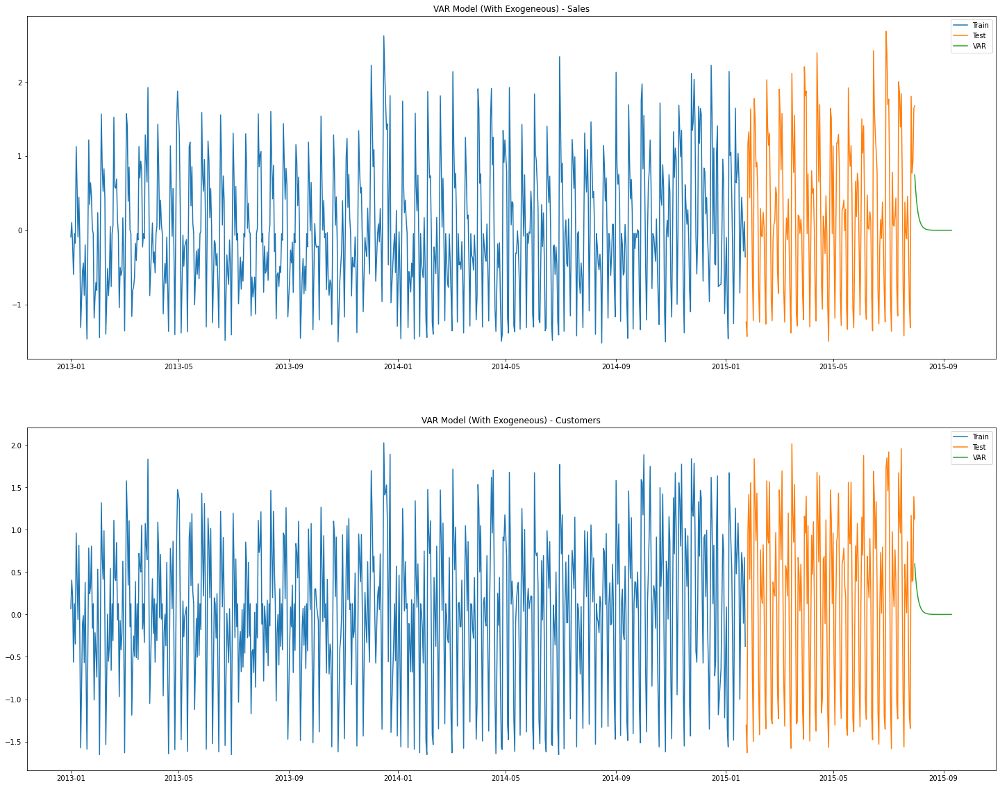

In [80]:
store_8_next_six_weeks = pd.date_range(store_id_8_test.index.max(), periods=42)
store_8_next_six_weeks_prediction = store_id_8_without_exog_model.fit().predict(start=store_8_next_six_weeks.min(), end=store_8_next_six_weeks.max())
store_8_next_six_weeks_prediction = add_prediction_values_future(store_8_next_six_weeks_prediction , store_8_next_six_weeks , store_id_8_test , (188,12),(188,13))
plot_graph(store_id_8_train , store_id_8_test , store_8_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [81]:
joh_model_store_8_var = coint_johansen(store_id_8_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_8_var)

   max_eig_stat  trace_stat
0    285.027121  405.910910
1    120.883789  120.883789 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



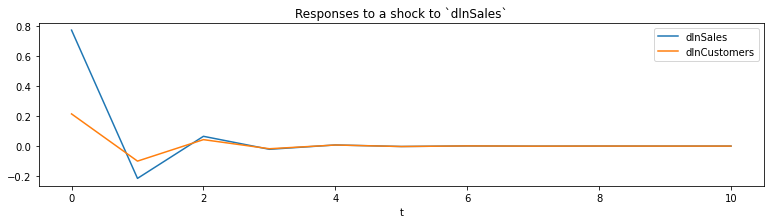

In [82]:
ax = store_id_8_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 3

### Now lets prepare using VARMAX model

In [83]:
store_id_8_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,-0.097361,-0.010404
Sales,0.194301,0.160194
Customers,0.209469,0.224834
Promo,0.048422,0.037167
SchoolHoliday,0.053856,0.024643
Year,-0.045597,-0.021394
Month,0.021792,0.018864
Day,0.039838,0.061639
WeekOfYear,0.027733,0.024585
lnSales,0.517146,0.154122


In [84]:
store_id_8_train['Promo'] = store_id_8_train['Promo'].replace(np.nan , 0)
store_id_8_test['Promo'] = store_id_8_test['Promo'].replace(np.nan , 0)
store_id_8_train['DayOfWeek'] = store_id_8_train.index.dayofweek
store_id_8_test['DayOfWeek'] = store_id_8_test.index.dayofweek

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1542.053
                                    + intercept   AIC                           3118.106
Date:                          Sun, 18 Apr 2021   BIC                           3196.716
Time:                                  13:37:48   HQIC                          3148.391
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.04, 0.00   Jarque-Bera (JB):    14992.63, 3615.16
Prob(Q):                        0.84, 0.95   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

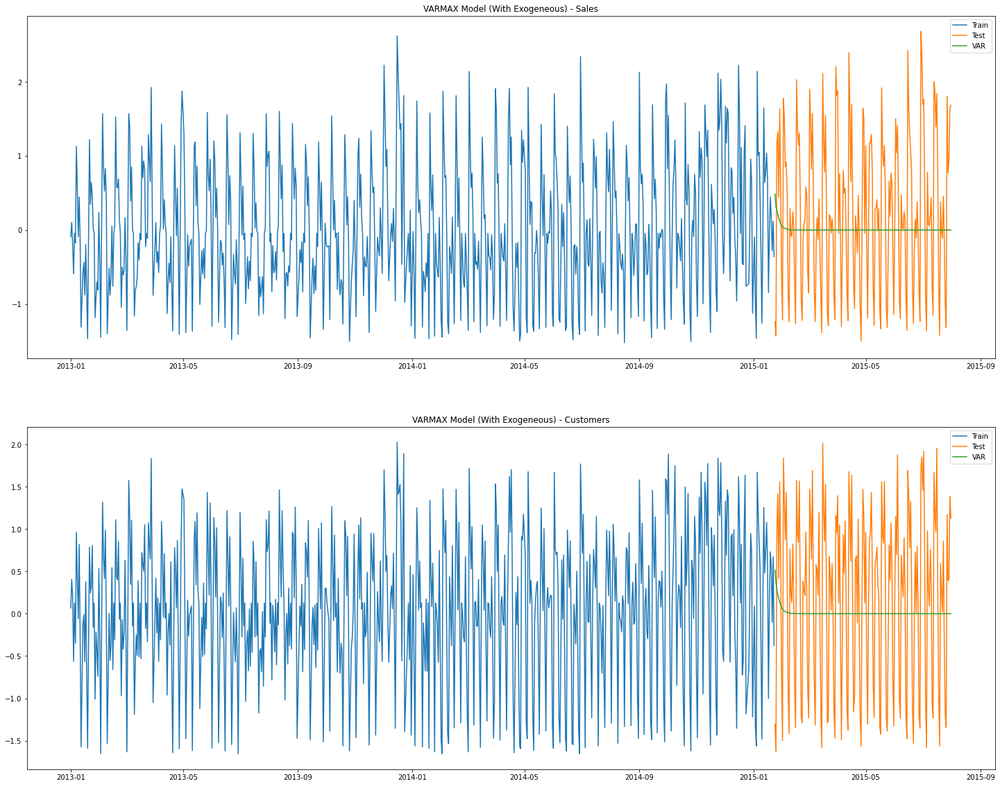

In [85]:
store_id_8_varmax_model , store_id_8_varmax_res , store_id_8_varmax_pred  = varmax_model(store_id_8_train , store_id_8_test  , ['dlnSales','dlnCustomers'],['Promo','DayOfWeek'],'c')
store_id_8_varmax_pred = add_prediction_values(store_id_8_varmax_pred,store_id_8_train , store_id_8_test,(752,12),(752,13))
plot_graph(store_id_8_train , store_id_8_test , store_id_8_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [86]:
store_id_8_performace_matrix = map_performace_matrix(store_id_8_test , store_id_8_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 8")
display(store_id_8_performace_matrix)
store_model_dict['Store_8_VARMAX_With_Exog'] = StoreModel(store_id_8_varmax_model , store_id_8_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 1.06,
  'mape': 16.43,
  'store_id': 'Store 8'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.05,
  'mape': 35.41,
  'store_id': 'Store 8'}]

In [87]:
joh_model_store_3_var = coint_johansen(store_id_3_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_3_var)

   max_eig_stat  trace_stat
0    322.265902  452.871151
1    130.605249  130.605249 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



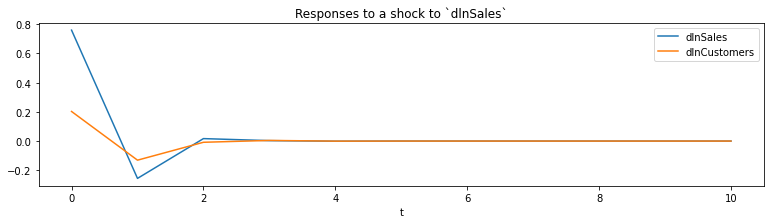

In [88]:
ax = store_id_8_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 9

In [89]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [90]:
store_id_9 = store_df_dict.get(9)
store_id_9 = reset_index(store_id_9)
store_id_9_train , store_id_9_test , store_id_9_train_index , store_id_9_test_index   = get_train_test_data(store_id_9,80)

In [91]:
print("store_id_9_train : ",store_id_9_train.shape)
print("store_id_9_test : ",store_id_9_test.shape)
print("Column List : ",store_id_9_train.columns)

store_id_9_train :  (753, 14)
store_id_9_test :  (189, 14)
Column List :  Index(['DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo', 'SchoolHoliday',
       'Year', 'Month', 'Day', 'WeekOfYear', 'lnSales', 'lnCustomers',
       'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1588.642
                                    + intercept   AIC                           3195.285
Date:                          Sun, 18 Apr 2021   BIC                           3236.902
Time:                                  13:37:56   HQIC                          3211.318
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.02, 0.87   Jarque-Bera (JB):   32341.84, 25233.43
Prob(Q):                        0.88, 0.35   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

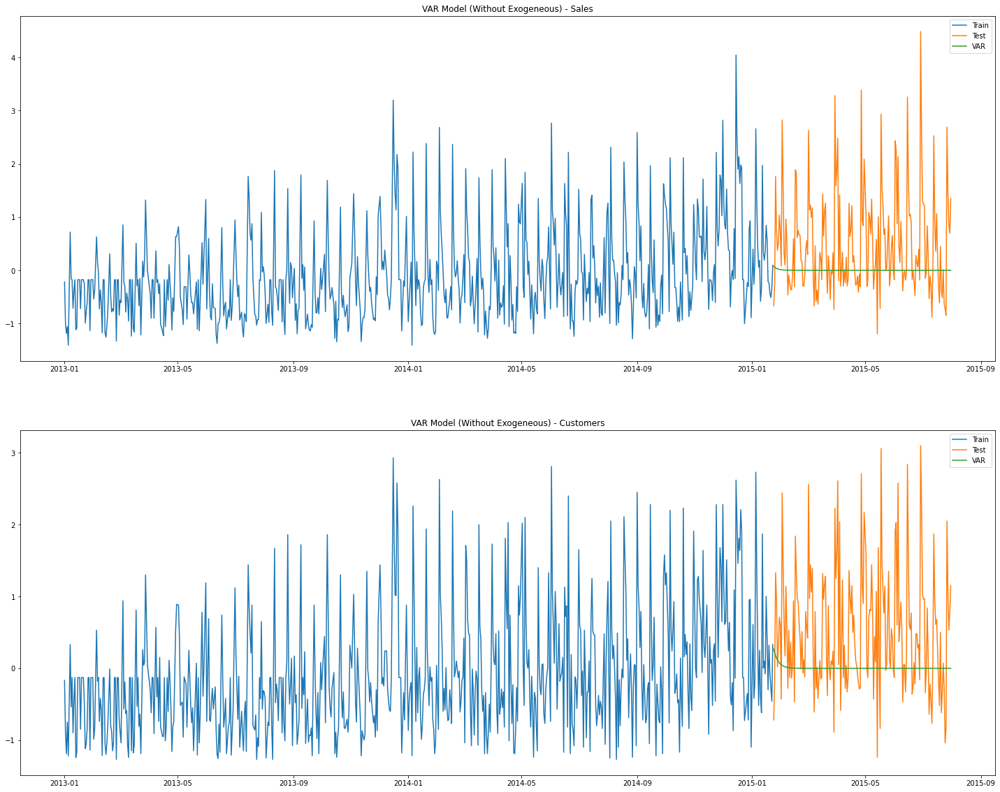

In [92]:
store_id_9_without_exog_model , store_id_9_without_exog_res , store_id_9_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_9_train , store_id_9_test  , ['dlnSales','dlnCustomers'],'c')
store_id_9_without_exog_pred = add_prediction_values(store_id_9_without_exog_pred,store_id_9_train , store_id_9_test,(752,10),(752,11))
plot_graph(store_id_9_train , store_id_9_test , store_id_9_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [93]:
store_id_9_var_model_performace_matrix = map_performace_matrix(store_id_9_test , store_id_9_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 9")
display(store_id_9_var_model_performace_matrix)
store_model_dict['Store_9_VAR_Without_Exog'] = StoreModel(store_id_9_without_exog_model , store_id_9_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 1.07,
  'mape': 23.38,
  'store_id': 'Store 9'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.0,
  'mape': 41.96,
  'store_id': 'Store 9'}]

### Now lets predict sales for next six weeks 

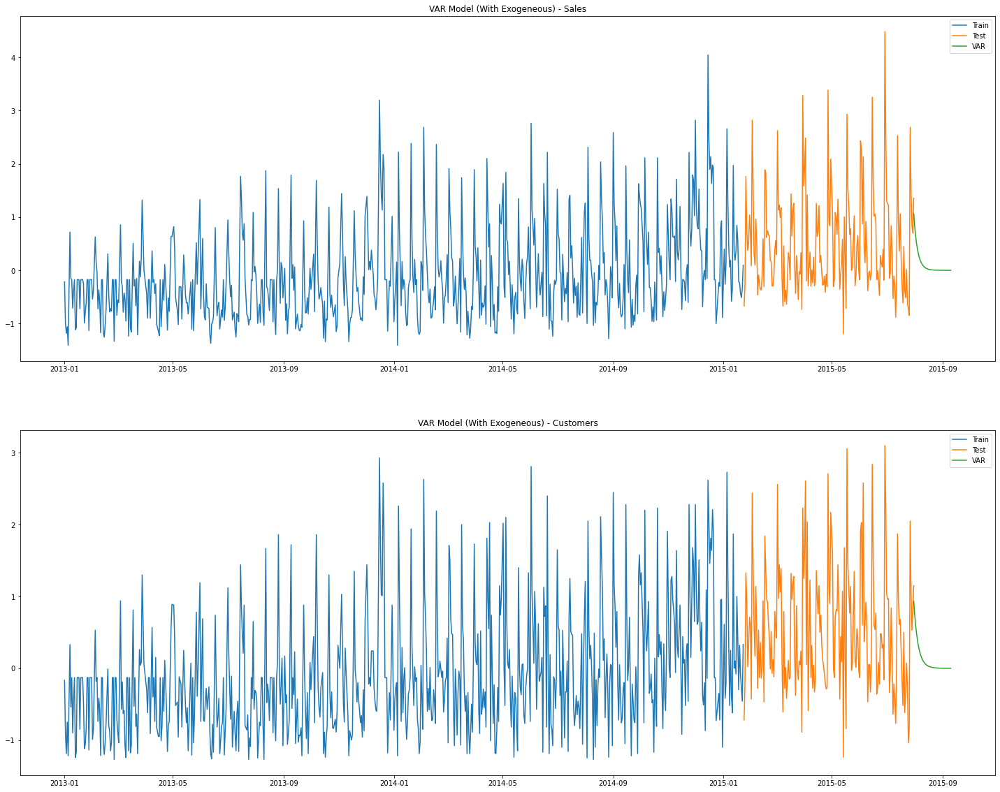

In [94]:
store_9_next_six_weeks = pd.date_range(store_id_9_test.index.max(), periods=42)
store_9_next_six_weeks_prediction = store_id_9_without_exog_model.fit().predict(start=store_9_next_six_weeks.min(), end=store_9_next_six_weeks.max())
store_9_next_six_weeks_prediction = add_prediction_values_future(store_9_next_six_weeks_prediction , store_9_next_six_weeks , store_id_9_test , (188,10),(188,11))
plot_graph(store_id_9_train , store_id_9_test , store_9_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [95]:
joh_model_store_9_var = coint_johansen(store_id_9_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_9_var)

   max_eig_stat  trace_stat
0    276.804726  408.518439
1    131.713713  131.713713 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



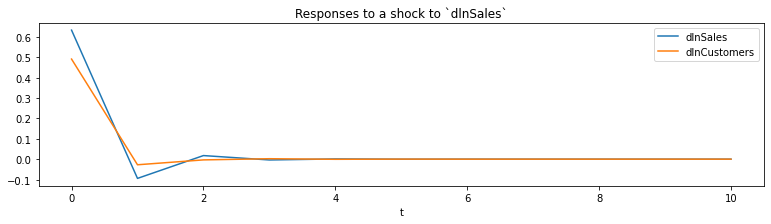

In [96]:
ax = store_id_9_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 9

### Now lets prepare using VARMAX model

In [97]:
store_id_9_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,-0.066034,-0.022625
Sales,0.217159,0.170070
Customers,0.225654,0.197964
Promo,0.045854,0.033399
SchoolHoliday,0.069853,0.044201
Year,-0.052596,-0.053376
Month,0.065964,0.057875
Day,0.039263,0.089053
WeekOfYear,0.057700,0.050912
lnSales,0.414099,0.160371


In [98]:
store_id_9_train['Promo'] = store_id_9_train['Promo'].replace(np.nan , 0)
store_id_9_test['Promo'] = store_id_9_test['Promo'].replace(np.nan , 0)
store_id_9_train['DayOfWeek'] = store_id_9_train.index.dayofweek
store_id_9_test['DayOfWeek'] = store_id_9_test.index.dayofweek
store_id_9_train['SchoolHoliday'] = store_id_9_train['SchoolHoliday'].replace(np.nan , 0)
store_id_9_test['SchoolHoliday'] = store_id_9_test['SchoolHoliday'].replace(np.nan , 0)

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1567.994
                                    + intercept   AIC                           3169.988
Date:                          Sun, 18 Apr 2021   BIC                           3248.597
Time:                                  13:38:27   HQIC                          3200.272
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.16, 0.10   Jarque-Bera (JB):   27361.96, 24974.81
Prob(Q):                        0.69, 0.76   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

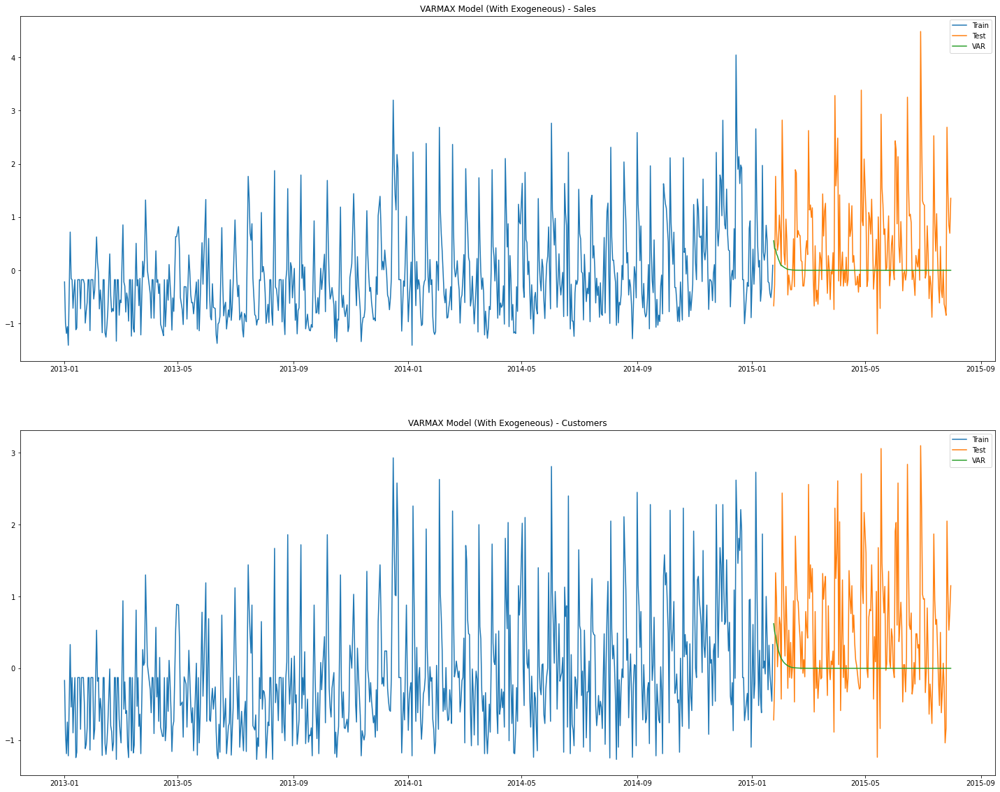

In [99]:
store_id_9_varmax_model , store_id_9_varmax_res , store_id_9_varmax_pred  = varmax_model(store_id_9_train , store_id_9_test  , ['dlnSales','dlnCustomers'],['DayOfWeek','Promo'],'c')
store_id_9_varmax_pred = add_prediction_values(store_id_9_varmax_pred,store_id_9_train , store_id_9_test,(752,12),(752,13))
plot_graph(store_id_9_train , store_id_9_test , store_id_9_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [100]:
store_id_9_performace_matrix = map_performace_matrix(store_id_9_test , store_id_9_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 9")
display(store_id_9_performace_matrix)
store_model_dict['Store_9_VARMAX_With_Exog'] = StoreModel(store_id_9_varmax_model , store_id_9_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 1.06,
  'mape': 20.31,
  'store_id': 'Store 9'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 0.99,
  'mape': 44.01,
  'store_id': 'Store 9'}]

In [101]:
joh_model_store_9_var = coint_johansen(store_id_9_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_9_var)

   max_eig_stat  trace_stat
0    276.804726  408.518439
1    131.713713  131.713713 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



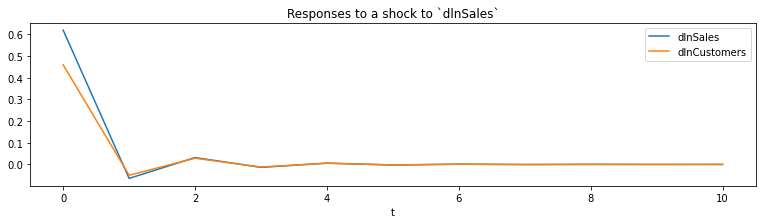

In [102]:
ax = store_id_9_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 13

In [103]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [104]:
store_id_13 = store_df_dict.get(13)
store_id_13 = reset_index(store_id_13)
store_id_13_train , store_id_13_test , store_id_13_train_index , store_id_13_test_index   = get_train_test_data(store_id_13,80)

In [105]:
print("store_id_13_train : ",store_id_13_train.shape)
print("store_id_13_test : ",store_id_13_test.shape)
print("Column List : ",store_id_13_train.columns)

store_id_13_train :  (753, 16)
store_id_13_test :  (189, 16)
Column List :  Index(['PromoInterval', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo',
       'SchoolHoliday', 'Year', 'Month', 'Day', 'WeekOfYear', 'Is_Promo_Month',
       'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1653.720
                                    + intercept   AIC                           3325.440
Date:                          Sun, 18 Apr 2021   BIC                           3367.057
Time:                                  13:38:35   HQIC                          3341.473
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             1.93, 0.59   Jarque-Bera (JB):    8726.35, 13719.77
Prob(Q):                        0.16, 0.44   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

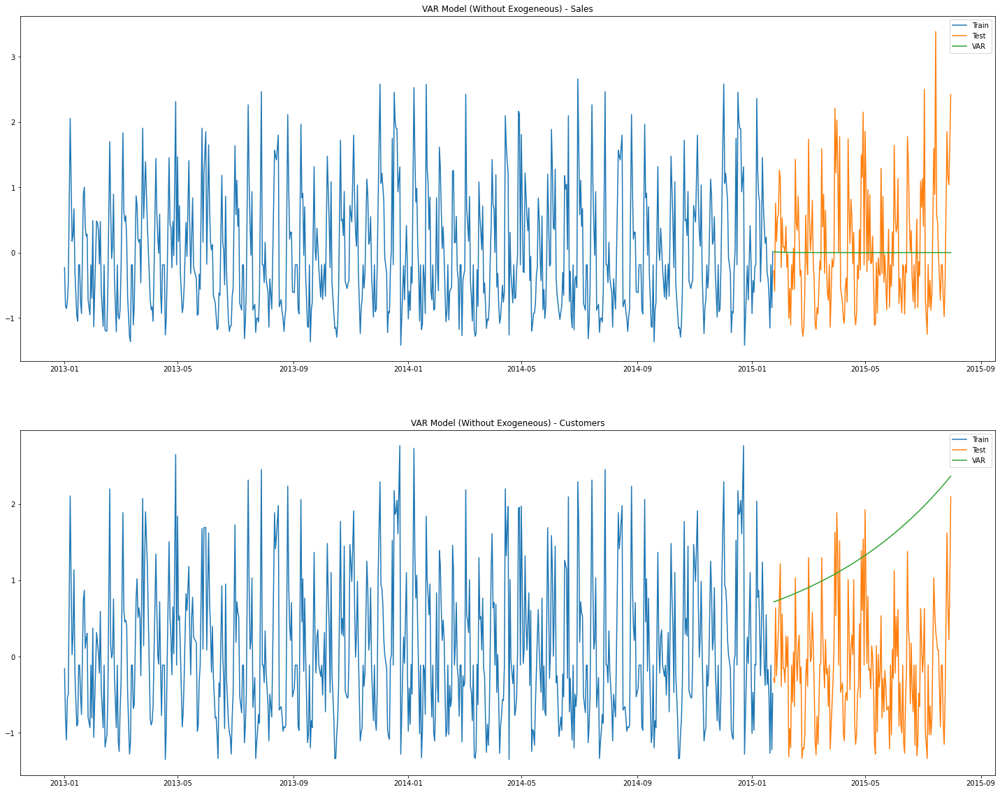

In [106]:
store_id_13_without_exog_model , store_id_13_without_exog_res , store_id_13_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_13_train , store_id_13_test  , ['dlnSales','dlnCustomers'],'c')
store_id_13_without_exog_pred = add_prediction_values(store_id_13_without_exog_pred,store_id_13_train , store_id_13_test,(752,12),(752,13))
plot_graph(store_id_13_train , store_id_13_test , store_id_13_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [107]:
store_id_13_var_model_performace_matrix = map_performace_matrix(store_id_13_test , store_id_13_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 13")
display(store_id_13_var_model_performace_matrix)
store_model_dict['Store_13_VAR_Without_Exog'] = StoreModel(store_id_13_without_exog_model , store_id_13_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.88,
  'mape': -17.8,
  'store_id': 'Store 13'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.76,
  'mape': 423.89,
  'store_id': 'Store 13'}]

### Now lets predict sales for next six weeks 

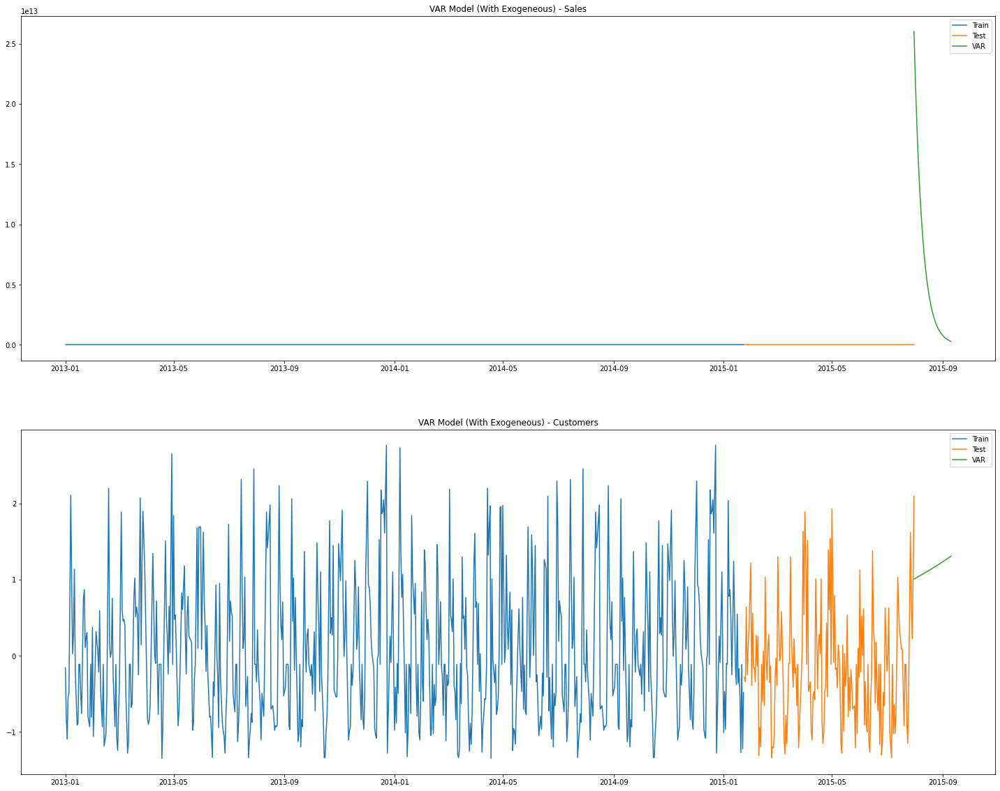

In [108]:
store_13_next_six_weeks = pd.date_range(store_id_13_test.index.max(), periods=42)
store_13_next_six_weeks_prediction = store_id_13_without_exog_model.fit().predict(start=store_13_next_six_weeks.min(), end=store_13_next_six_weeks.max())
store_13_next_six_weeks_prediction = add_prediction_values_future(store_13_next_six_weeks_prediction , store_13_next_six_weeks , store_id_13_test , (188,10),(188,11))
plot_graph(store_id_13_train , store_id_13_test , store_13_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [109]:
joh_model_store_13_var = coint_johansen(store_id_13_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_13_var)

   max_eig_stat  trace_stat
0    271.213498  422.569441
1    151.355943  151.355943 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



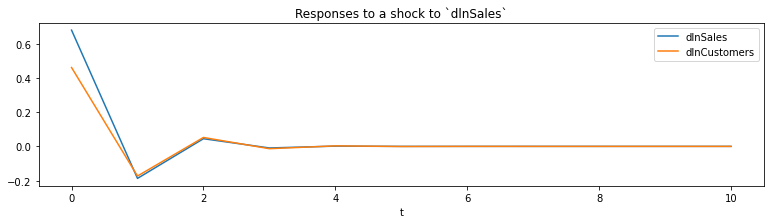

In [110]:
ax = store_id_13_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 9

### Now lets prepare using VARMAX model

In [111]:
store_id_13_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,-0.034358,-0.016483
Sales,0.252175,0.178750
Customers,0.257869,0.215561
Promo,0.031641,-0.009075
SchoolHoliday,0.040484,0.022580
Year,-0.010383,0.015220
Month,0.050324,0.015001
Day,0.002591,0.058913
WeekOfYear,0.051494,0.012169
Is_Promo_Month,0.010117,0.013468


In [112]:
store_id_13_train['Promo'] = store_id_13_train['Promo'].replace(np.nan , 0)
store_id_13_test['Promo'] = store_id_13_test['Promo'].replace(np.nan , 0)
store_id_13_train['Day'] = store_id_13_train.index.day
store_id_13_test['Day'] = store_id_13_test.index.day
store_id_13_train['SchoolHoliday'] = store_id_13_train['SchoolHoliday'].replace(np.nan , 0)
store_id_13_test['SchoolHoliday'] = store_id_13_test['SchoolHoliday'].replace(np.nan , 0)

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1649.392
                                    + intercept   AIC                           3332.784
Date:                          Sun, 18 Apr 2021   BIC                           3411.394
Time:                                  13:38:41   HQIC                          3363.069
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.06, 0.01   Jarque-Bera (JB):    8157.50, 13577.37
Prob(Q):                        0.81, 0.92   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

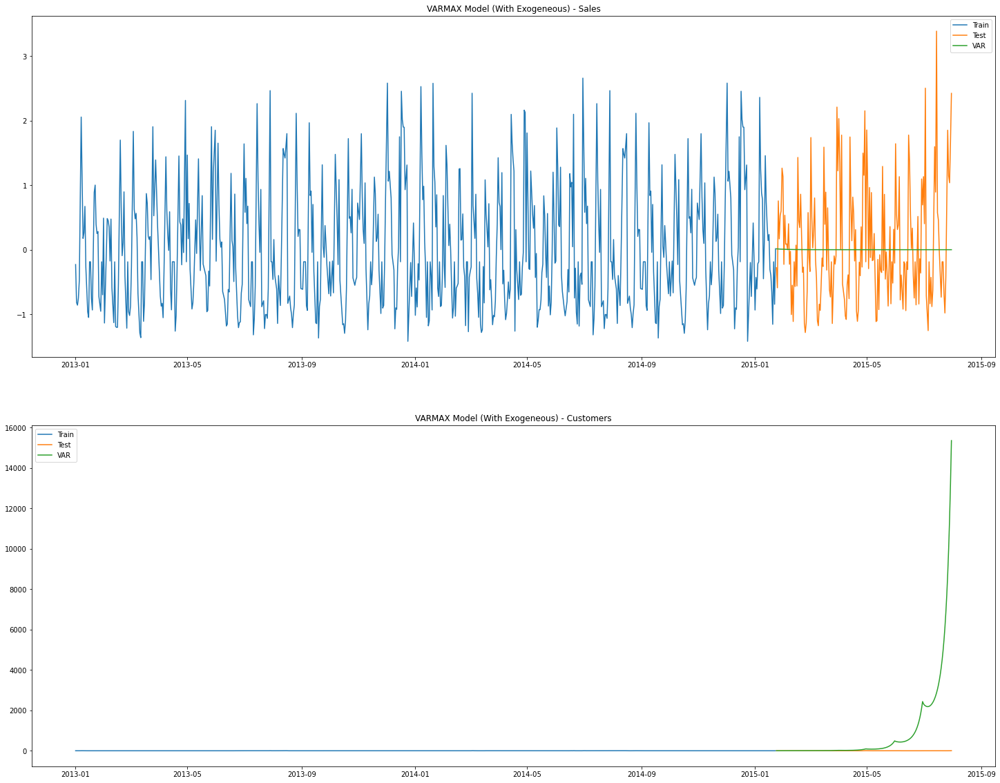

In [113]:
store_id_13_varmax_model , store_id_13_varmax_res , store_id_13_varmax_pred  = varmax_model(store_id_13_train , store_id_13_test  , ['dlnSales','dlnCustomers'],['Day'],'ct')
store_id_13_varmax_pred = add_prediction_values(store_id_13_varmax_pred,store_id_13_train , store_id_13_test,(752,12),(752,13))
plot_graph(store_id_13_train , store_id_13_test , store_id_13_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [114]:
store_id_13_performace_matrix = map_performace_matrix(store_id_13_test , store_id_13_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 13")
display(store_id_13_performace_matrix)
store_model_dict['Store_13_VARMAX_With_Exog'] = StoreModel(store_id_13_varmax_model , store_id_13_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.88,
  'mape': -18.21,
  'store_id': 'Store 13'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 2427.89,
  'mape': 203812.94,
  'store_id': 'Store 13'}]

In [115]:
joh_model_store_13_var = coint_johansen(store_id_13_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_13_var)

   max_eig_stat  trace_stat
0    271.213498  422.569441
1    151.355943  151.355943 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



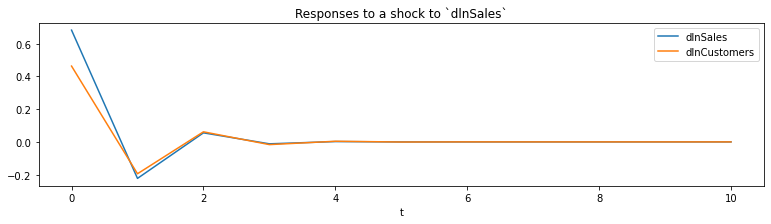

In [116]:
ax = store_id_13_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 25

In [117]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [118]:
store_id_25 = store_df_dict.get(25)
store_id_25 = reset_index(store_id_25)
store_id_25_train , store_id_25_test , store_id_25_train_index , store_id_25_test_index   = get_train_test_data(store_id_25,80)

In [119]:
print("store_id_25_train : ",store_id_25_train.shape)
print("store_id_25_test : ",store_id_25_test.shape)
print("Column List : ",store_id_25_train.columns)

store_id_25_train :  (753, 14)
store_id_25_test :  (189, 14)
Column List :  Index(['DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo', 'SchoolHoliday',
       'Year', 'Month', 'Day', 'WeekOfYear', 'lnSales', 'lnCustomers',
       'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1437.673
Date:                          Sun, 18 Apr 2021   AIC                           2889.346
Time:                                  13:38:47   BIC                           2921.715
Sample:                              01-01-2013   HQIC                          2901.816
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):            10.45, 0.30   Jarque-Bera (JB):    6311.99, 21282.94
Prob(Q):                        0.00, 0.58   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         0.58, 0.49   Skew:                       0.74, 1.32
Prob(H) (two-sided):            0.00

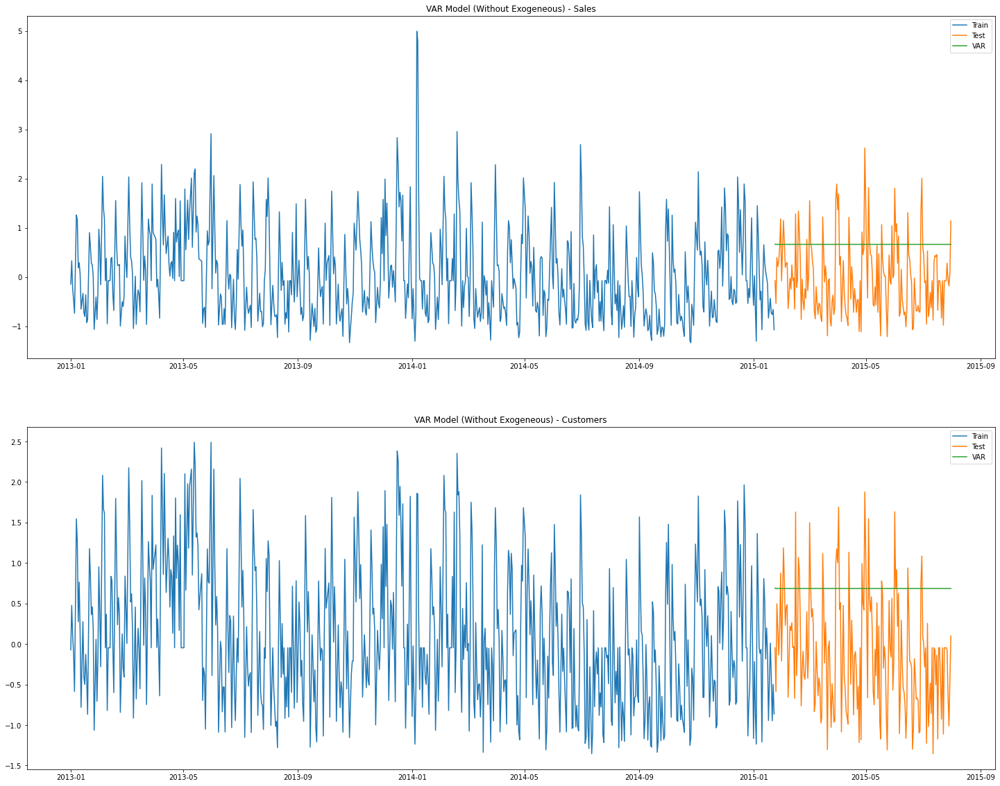

In [120]:
store_id_25_without_exog_model , store_id_25_without_exog_res , store_id_25_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_25_train , store_id_25_test  , ['dlnSales','dlnCustomers'],'n')
store_id_25_without_exog_pred = add_prediction_values(store_id_25_without_exog_pred,store_id_25_train , store_id_25_test,(752,10),(752,11))
plot_graph(store_id_25_train , store_id_25_test , store_id_25_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [121]:
store_id_25_var_model_performace_matrix = map_performace_matrix(store_id_25_test , store_id_25_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 25")
display(store_id_25_var_model_performace_matrix)
store_model_dict['Store_25_VAR_Without_Exog'] = StoreModel(store_id_25_without_exog_model , store_id_25_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.99,
  'mape': -211.78,
  'store_id': 'Store 25'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 1.06,
  'mape': -285.71,
  'store_id': 'Store 25'}]

### Now lets predict sales for next six weeks 

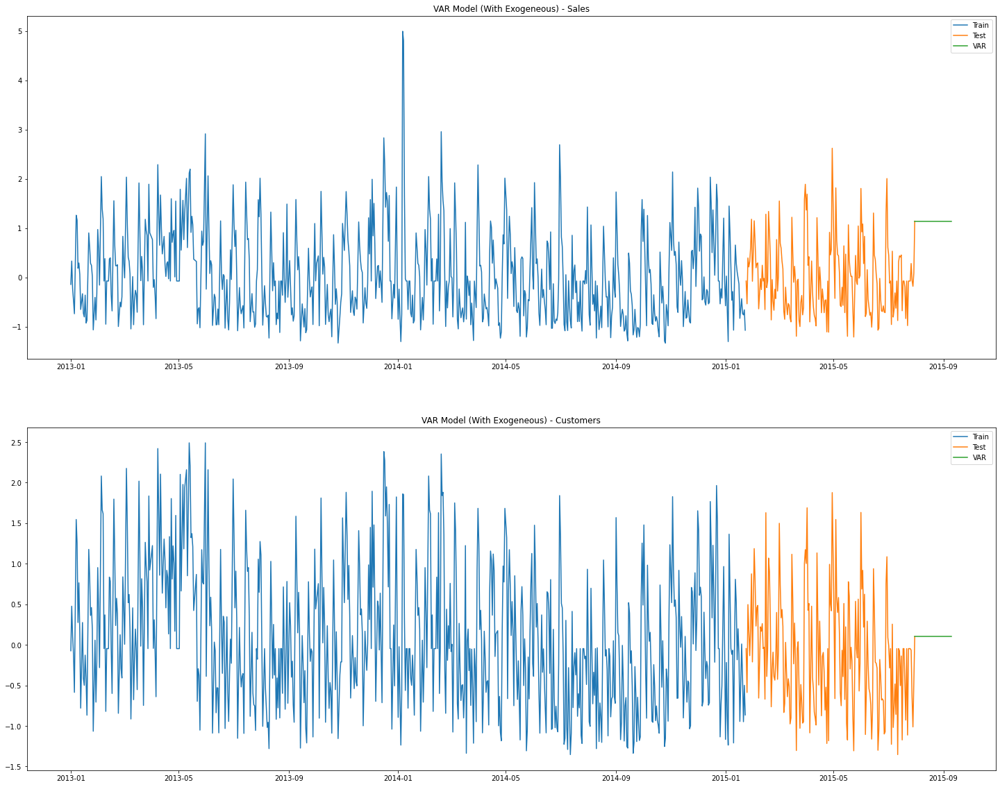

In [122]:
store_25_next_six_weeks = pd.date_range(store_id_25_test.index.max(), periods=42)
store_25_next_six_weeks_prediction = store_id_25_without_exog_model.fit().predict(start=store_25_next_six_weeks.min(), end=store_25_next_six_weeks.max())
store_25_next_six_weeks_prediction = add_prediction_values_future(store_25_next_six_weeks_prediction , store_25_next_six_weeks , store_id_25_test , (188,10),(188,11))
plot_graph(store_id_25_train , store_id_25_test , store_25_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [123]:
joh_model_store_25_var = coint_johansen(store_id_25_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_25_var)

   max_eig_stat  trace_stat
0    277.654458  392.408046
1    114.753588  114.753588 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



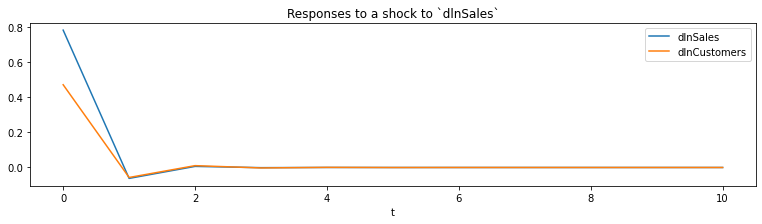

In [124]:
ax = store_id_25_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 25

### Now lets prepare using VARMAX model

In [125]:
store_id_25_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,-0.126289,-0.076090
Sales,0.252802,0.254787
Customers,0.268767,0.284013
Promo,0.004964,0.001137
SchoolHoliday,0.011684,-0.015727
Year,-0.057976,-0.053755
Month,0.012261,0.007083
Day,0.118743,0.108950
WeekOfYear,0.009154,-0.001777
lnSales,0.537623,0.337737


In [126]:
store_id_25_train['Promo'] = store_id_25_train['Promo'].replace(np.nan , 0)
store_id_25_test['Promo'] = store_id_25_test['Promo'].replace(np.nan , 0)
store_id_25_train['Day'] = store_id_25_train.index.day
store_id_25_test['Day'] = store_id_25_test.index.day
store_id_25_train['SchoolHoliday'] = store_id_25_train['SchoolHoliday'].replace(np.nan , 0)
store_id_25_test['SchoolHoliday'] = store_id_25_test['SchoolHoliday'].replace(np.nan , 0)

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1373.154
                                    + intercept   AIC                           2776.308
Date:                          Sun, 18 Apr 2021   BIC                           2845.669
Time:                                  13:39:15   HQIC                          2803.029
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.05, 0.00   Jarque-Bera (JB):    5095.91, 20254.80
Prob(Q):                        0.82, 1.00   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

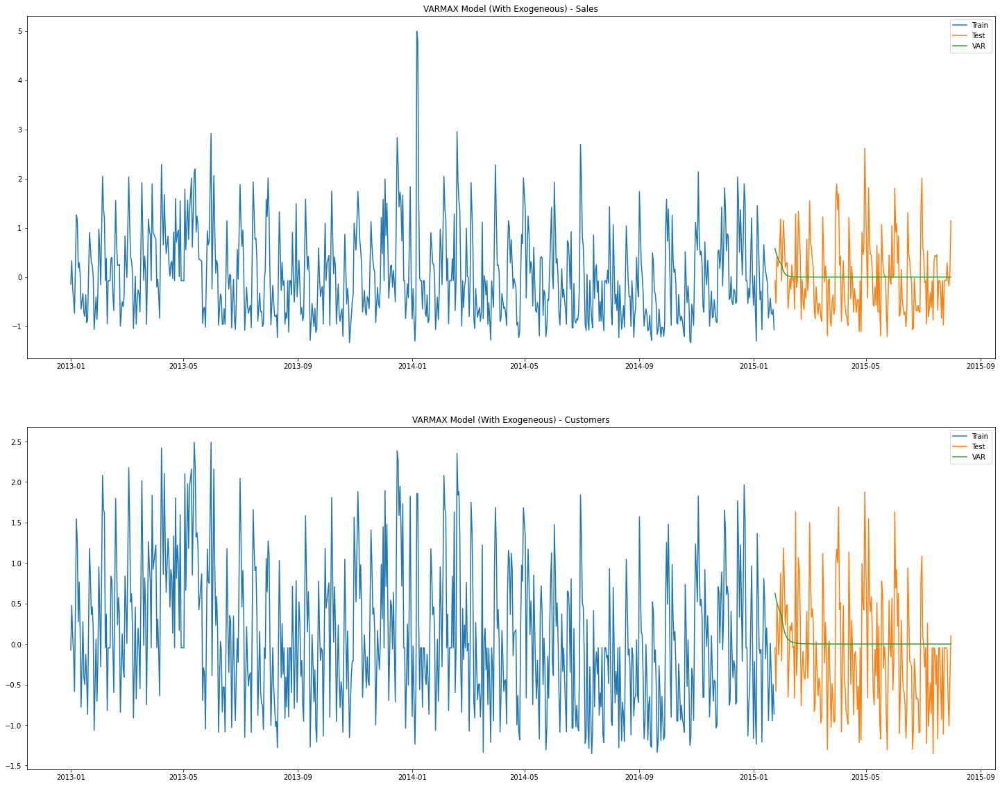

In [127]:
store_id_25_varmax_model , store_id_25_varmax_res , store_id_25_varmax_pred  = varmax_model(store_id_25_train , store_id_25_test  , ['dlnSales','dlnCustomers'],['Day'],'c')
store_id_25_varmax_pred = add_prediction_values(store_id_25_varmax_pred,store_id_25_train , store_id_25_test,(752,10),(752,11))
plot_graph(store_id_25_train , store_id_25_test , store_id_25_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [128]:
store_id_25_performace_matrix = map_performace_matrix(store_id_25_test , store_id_25_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 25")
display(store_id_25_performace_matrix)
store_model_dict['Store_25_VARMAX_With_Exog'] = StoreModel(store_id_25_varmax_model , store_id_25_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.73,
  'mape': -25.49,
  'store_id': 'Store 25'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 0.7,
  'mape': -40.89,
  'store_id': 'Store 25'}]

In [129]:
joh_model_store_25_var = coint_johansen(store_id_25_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_25_var)

   max_eig_stat  trace_stat
0    277.654458  392.408046
1    114.753588  114.753588 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



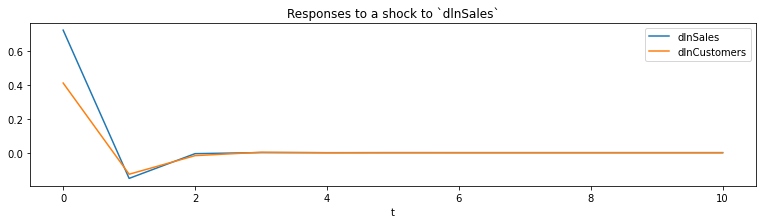

In [130]:
ax = store_id_25_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 29

In [131]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [132]:
store_id_29 = store_df_dict.get(29)
store_id_29 = reset_index(store_id_29)
store_id_29_train , store_id_29_test , store_id_29_train_index , store_id_29_test_index   = get_train_test_data(store_id_29,80)

In [133]:
print("store_id_29_train : ",store_id_29_train.shape)
print("store_id_29_test : ",store_id_29_test.shape)
print("Column List : ",store_id_29_train.columns)

store_id_29_train :  (753, 14)
store_id_29_test :  (189, 14)
Column List :  Index(['DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo', 'SchoolHoliday',
       'Year', 'Month', 'Day', 'WeekOfYear', 'lnSales', 'lnCustomers',
       'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1412.732
Date:                          Sun, 18 Apr 2021   AIC                           2839.463
Time:                                  13:39:23   BIC                           2871.832
Sample:                              01-01-2013   HQIC                          2851.933
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):            28.76, 0.37   Jarque-Bera (JB):     7964.78, 9059.48
Prob(Q):                        0.00, 0.54   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         2.19, 1.66   Skew:                      1.33, -0.21
Prob(H) (two-sided):            0.00

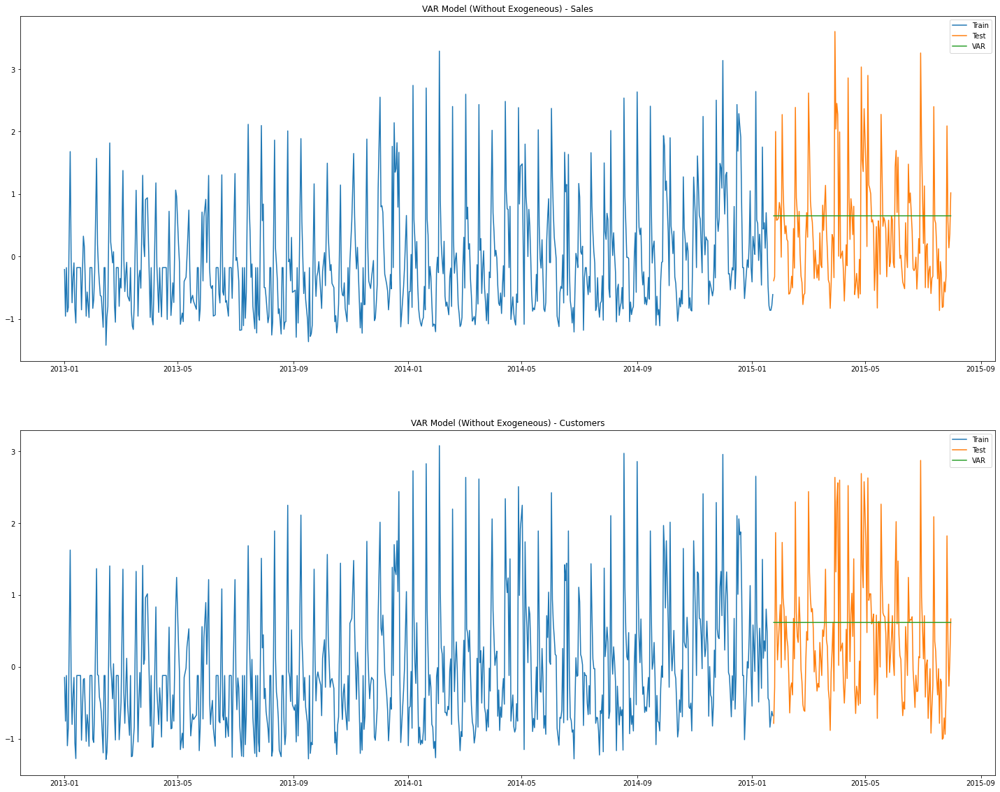

In [134]:
store_id_29_without_exog_model , store_id_29_without_exog_res , store_id_29_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_29_train , store_id_29_test  , ['dlnSales','dlnCustomers'],'n')
store_id_29_without_exog_pred = add_prediction_values(store_id_29_without_exog_pred,store_id_29_train , store_id_29_test,(752,10),(752,11))
plot_graph(store_id_29_train , store_id_29_test , store_id_29_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [135]:
store_id_29_var_model_performace_matrix = map_performace_matrix(store_id_29_test , store_id_29_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 29")
display(store_id_29_var_model_performace_matrix)
store_model_dict['Store_29_VAR_Without_Exog'] = StoreModel(store_id_29_without_exog_model , store_id_29_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.93,
  'mape': -48.56,
  'store_id': 'Store 29'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 0.87,
  'mape': -199.95,
  'store_id': 'Store 29'}]

### Now lets predict sales for next six weeks 

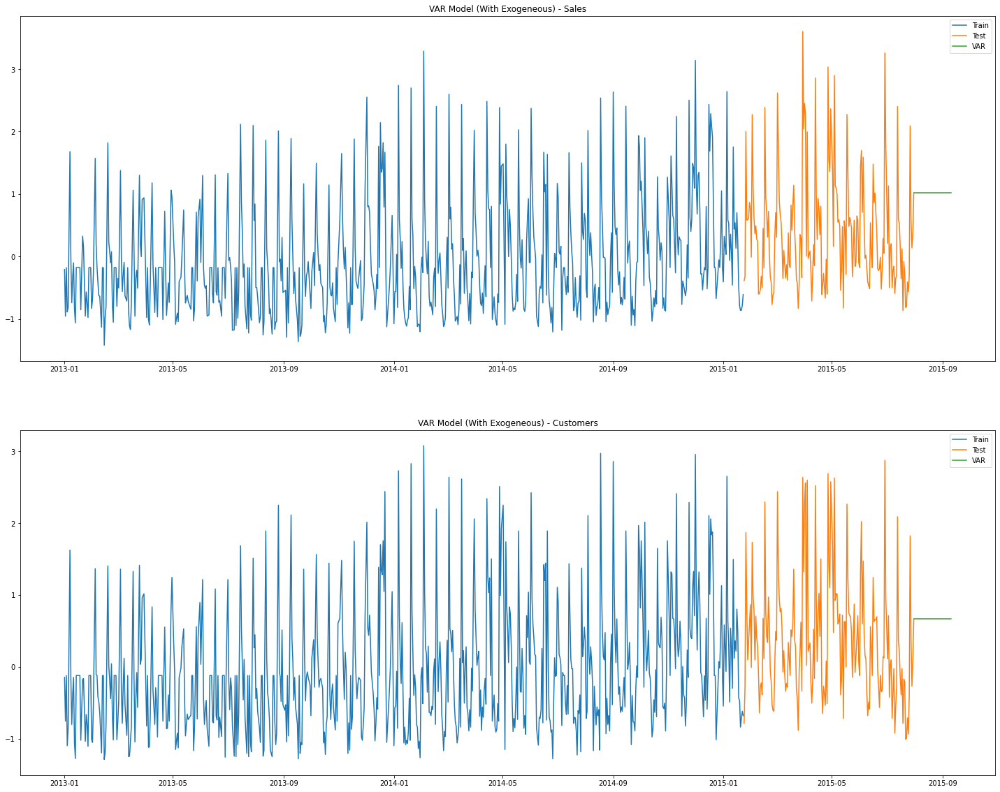

In [136]:
store_29_next_six_weeks = pd.date_range(store_id_29_test.index.max(), periods=42)
store_29_next_six_weeks_prediction = store_id_29_without_exog_model.fit().predict(start=store_29_next_six_weeks.min(), end=store_29_next_six_weeks.max())
store_29_next_six_weeks_prediction = add_prediction_values_future(store_29_next_six_weeks_prediction , store_29_next_six_weeks , store_id_29_test , (188,10),(188,11))
plot_graph(store_id_29_train , store_id_29_test , store_29_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [137]:
joh_model_store_29_var = coint_johansen(store_id_29_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_29_var)

   max_eig_stat  trace_stat
0    293.615011  407.798575
1    114.183564  114.183564 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



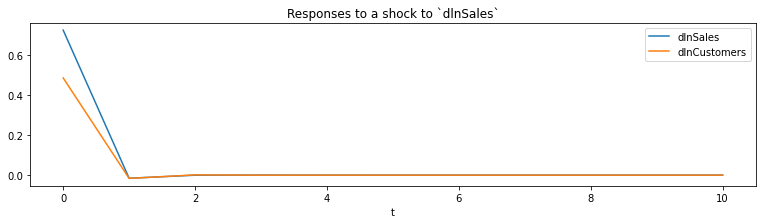

In [138]:
ax = store_id_29_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 29

### Now lets prepare using VARMAX model

In [139]:
store_id_29_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,-0.031658,-0.007160
Sales,0.210372,0.177190
Customers,0.212396,0.190387
Promo,-0.013842,-0.008446
SchoolHoliday,0.012520,-0.010443
Year,-0.055394,-0.087057
Month,0.053225,0.022655
Day,0.096268,0.068032
WeekOfYear,0.039235,0.013765
lnSales,0.439052,0.273497


In [140]:
store_id_29_train['Promo'] = store_id_29_train['Promo'].replace(np.nan , 0)
store_id_29_test['Promo'] = store_id_29_test['Promo'].replace(np.nan , 0)
store_id_29_train['Day'] = store_id_29_train.index.day
store_id_29_test['Day'] = store_id_29_test.index.day
store_id_29_train['SchoolHoliday'] = store_id_29_train['SchoolHoliday'].replace(np.nan , 0)
store_id_29_test['SchoolHoliday'] = store_id_29_test['SchoolHoliday'].replace(np.nan , 0)

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1362.889
Date:                          Sun, 18 Apr 2021   AIC                           2751.778
Time:                                  13:39:38   BIC                           2811.891
Sample:                              01-01-2013   HQIC                          2774.936
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.49, 0.01   Jarque-Bera (JB):     7003.23, 8034.01
Prob(Q):                        0.48, 0.91   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         2.54, 1.67   Skew:                      1.08, -0.42
Prob(H) (two-sided):            0.00

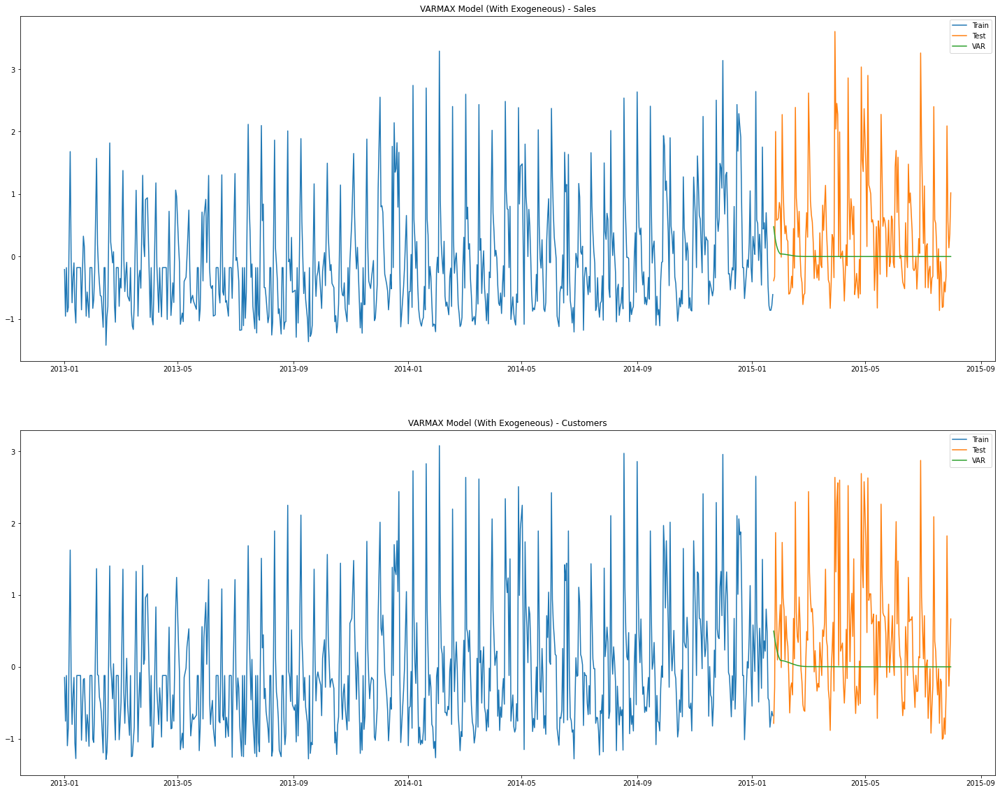

In [141]:
store_id_29_varmax_model , store_id_29_varmax_res , store_id_29_varmax_pred  = varmax_model(store_id_29_train , store_id_29_test  , ['dlnSales','dlnCustomers'],['Day'],'n')
store_id_29_varmax_pred = add_prediction_values(store_id_29_varmax_pred,store_id_29_train , store_id_29_test,(752,10),(752,11))
plot_graph(store_id_29_train , store_id_29_test , store_id_29_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [142]:
store_id_29_performace_matrix = map_performace_matrix(store_id_29_test , store_id_29_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 29")
display(store_id_29_performace_matrix)
store_model_dict['Store_29_VARMAX_With_Exog'] = StoreModel(store_id_29_varmax_model , store_id_29_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.98,
  'mape': 16.33,
  'store_id': 'Store 29'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 0.93,
  'mape': 16.87,
  'store_id': 'Store 29'}]

In [143]:
joh_model_store_29_var = coint_johansen(store_id_29_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_29_var)

   max_eig_stat  trace_stat
0    293.615011  407.798575
1    114.183564  114.183564 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



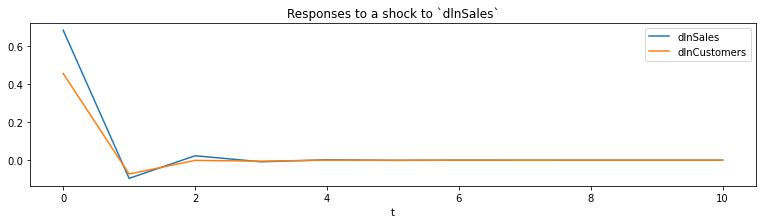

In [144]:
ax = store_id_29_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 31

In [145]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [146]:
store_id_31 = store_df_dict.get(31)
store_id_31 = reset_index(store_id_31)
store_id_31_train , store_id_31_test , store_id_31_train_index , store_id_31_test_index   = get_train_test_data(store_id_31,80)

In [147]:
print("store_id_31_train : ",store_id_31_train.shape)
print("store_id_31_test : ",store_id_31_test.shape)
print("Column List : ",store_id_31_train.columns)

store_id_31_train :  (753, 14)
store_id_31_test :  (189, 14)
Column List :  Index(['DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo', 'SchoolHoliday',
       'Year', 'Month', 'Day', 'WeekOfYear', 'lnSales', 'lnCustomers',
       'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1619.339
Date:                          Sun, 18 Apr 2021   AIC                           3252.679
Time:                                  13:39:45   BIC                           3285.047
Sample:                              01-01-2013   HQIC                          3265.149
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.44, 0.65   Jarque-Bera (JB):     3589.25, 5665.86
Prob(Q):                        0.51, 0.42   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):         0.72, 1.56   Skew:                      0.52, -0.98
Prob(H) (two-sided):            0.01

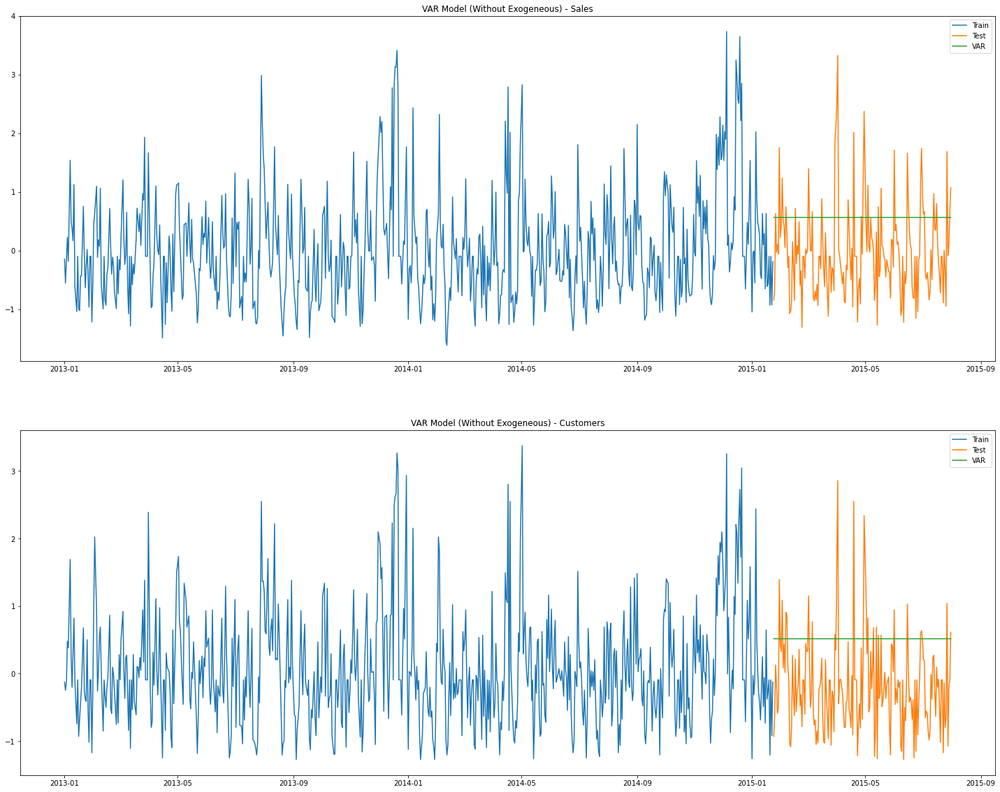

In [148]:
store_id_31_without_exog_model , store_id_31_without_exog_res , store_id_31_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_31_train , store_id_31_test  , ['dlnSales','dlnCustomers'],'n')
store_id_31_without_exog_pred = add_prediction_values(store_id_31_without_exog_pred,store_id_31_train , store_id_31_test,(752,10),(752,11))
plot_graph(store_id_31_train , store_id_31_test , store_id_31_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [149]:
store_id_31_var_model_performace_matrix = map_performace_matrix(store_id_31_test , store_id_31_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 31")
display(store_id_31_var_model_performace_matrix)
store_model_dict['Store_31_VAR_Without_Exog'] = StoreModel(store_id_31_without_exog_model , store_id_31_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.96,
  'mape': 41.67,
  'store_id': 'Store 31'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 0.97,
  'mape': -157.92,
  'store_id': 'Store 31'}]

### Now lets predict sales for next six weeks 

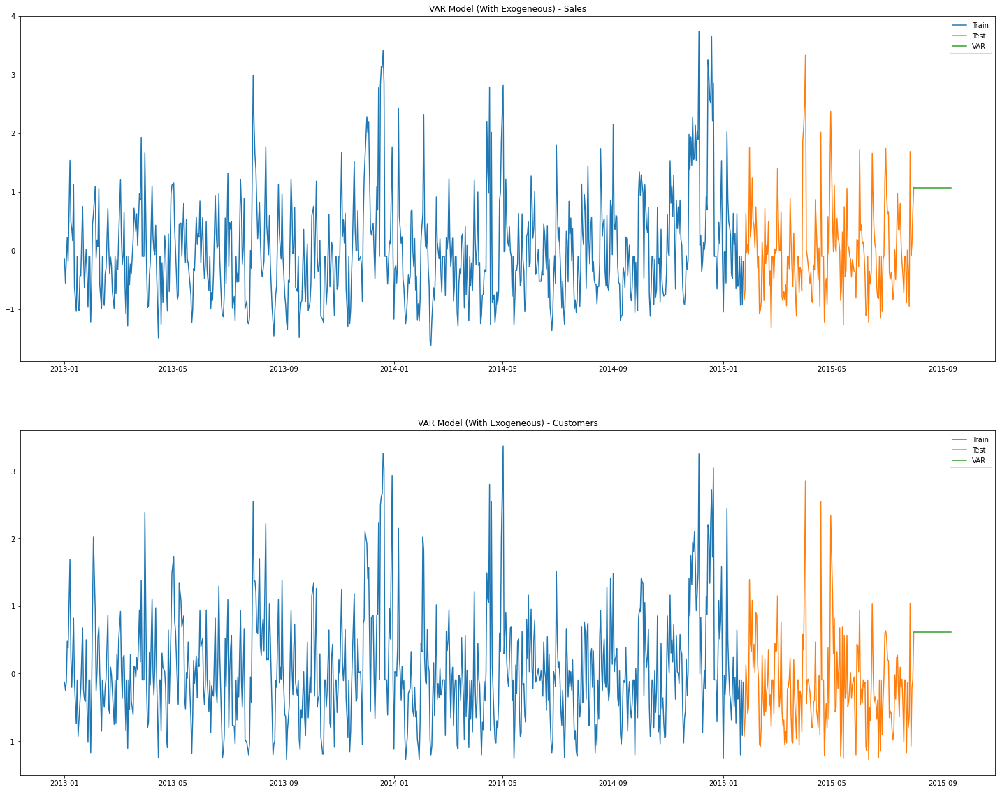

In [150]:
store_31_next_six_weeks = pd.date_range(store_id_31_test.index.max(), periods=42)
store_31_next_six_weeks_prediction = store_id_31_without_exog_model.fit().predict(start=store_31_next_six_weeks.min(), end=store_31_next_six_weeks.max())
store_31_next_six_weeks_prediction = add_prediction_values_future(store_31_next_six_weeks_prediction , store_31_next_six_weeks , store_id_31_test , (188,10),(188,11))
plot_graph(store_id_31_train , store_id_31_test , store_31_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [151]:
joh_model_store_31_var = coint_johansen(store_id_31_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_31_var)

   max_eig_stat  trace_stat
0    270.963823  343.000498
1     72.036675   72.036675 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



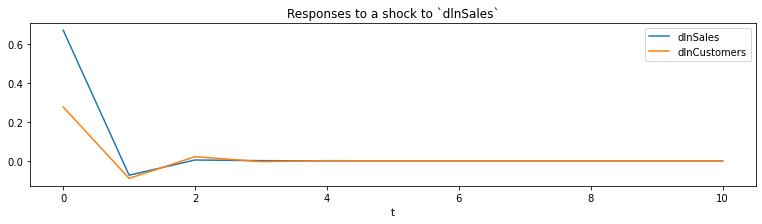

In [152]:
ax = store_id_31_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 31

### Now lets prepare using VARMAX model

In [153]:
store_id_31_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,0.041171,-0.009453
Sales,0.211804,0.139254
Customers,0.245803,0.170078
Promo,0.011224,0.034422
SchoolHoliday,0.058729,0.070760
Year,-0.055806,-0.054851
Month,0.030579,0.021731
Day,0.039532,0.063269
WeekOfYear,0.008395,0.017216
lnSales,0.472364,0.139002


In [154]:
store_id_31_train['Promo'] = store_id_31_train['Promo'].replace(np.nan , 0)
store_id_31_test['Promo'] = store_id_31_test['Promo'].replace(np.nan , 0)
store_id_31_train['Day'] = store_id_31_train.index.day
store_id_31_test['Day'] = store_id_31_test.index.day
store_id_31_train['SchoolHoliday'] = store_id_31_train['SchoolHoliday'].replace(np.nan , 0)
store_id_31_test['SchoolHoliday'] = store_id_31_test['SchoolHoliday'].replace(np.nan , 0)

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1598.449
                                    + intercept   AIC                           3230.898
Date:                          Sun, 18 Apr 2021   BIC                           3309.507
Time:                                  13:40:15   HQIC                          3261.182
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.05, 0.00   Jarque-Bera (JB):     3460.62, 5458.44
Prob(Q):                        0.82, 0.99   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

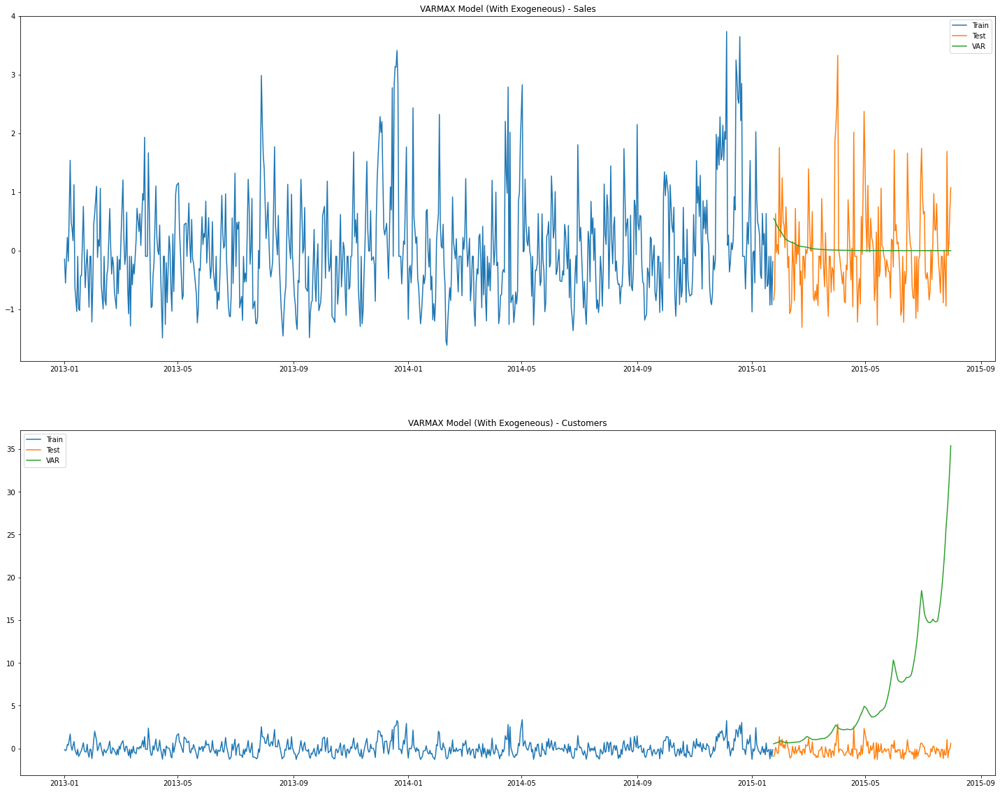

In [155]:
store_id_31_varmax_model , store_id_31_varmax_res , store_id_31_varmax_pred  = varmax_model(store_id_31_train , store_id_31_test  , ['dlnSales','dlnCustomers'],['Day','Promo'],'c')
store_id_31_varmax_pred = add_prediction_values(store_id_31_varmax_pred,store_id_31_train , store_id_31_test,(752,10),(752,11))
plot_graph(store_id_31_train , store_id_31_test , store_id_31_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [156]:
store_id_31_performace_matrix = map_performace_matrix(store_id_31_test , store_id_31_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 31")
display(store_id_31_performace_matrix)
store_model_dict['Store_31_VARMAX_With_Exog'] = StoreModel(store_id_31_varmax_model , store_id_31_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.78,
  'mape': -29.97,
  'store_id': 'Store 31'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 9.65,
  'mape': -1620.31,
  'store_id': 'Store 31'}]

In [157]:
joh_model_store_31_var = coint_johansen(store_id_31_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_31_var)

   max_eig_stat  trace_stat
0    270.963823  343.000498
1     72.036675   72.036675 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



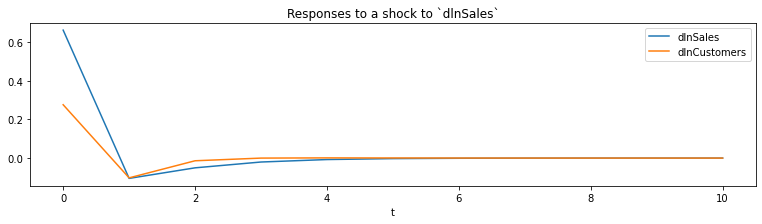

In [158]:
ax = store_id_31_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

###  Create Model For Store 46

In [159]:
print("Store Target Variable : ",stores_target_variables)
print("Store Id : ",store_df_dict.keys())

Store Target Variable :  ['Sales', 'Customers', 'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers']
Store Id :  dict_keys([1, 3, 8, 9, 13, 25, 29, 31, 46])


In [160]:
store_id_46 = store_df_dict.get(46)
store_id_46 = reset_index(store_id_46)
store_id_46_train , store_id_46_test , store_id_46_train_index , store_id_46_test_index   = get_train_test_data(store_id_46,80)

In [161]:
print("store_id_31_train : ",store_id_46_train.shape)
print("store_id_31_test : ",store_id_46_test.shape)
print("Column List : ",store_id_46_train.columns)

store_id_31_train :  (753, 16)
store_id_31_test :  (189, 16)
Column List :  Index(['PromoInterval', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Promo',
       'SchoolHoliday', 'Year', 'Month', 'Day', 'WeekOfYear', 'Is_Promo_Month',
       'lnSales', 'lnCustomers', 'dlnSales', 'dlnCustomers'],
      dtype='object')


                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                                   VAR(1)   Log Likelihood               -1720.848
                                    + intercept   AIC                           3459.696
Date:                          Sun, 18 Apr 2021   BIC                           3501.313
Time:                                  13:40:23   HQIC                          3475.729
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.60, 0.09   Jarque-Bera (JB):     5758.49, 3033.43
Prob(Q):                        0.44, 0.76   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

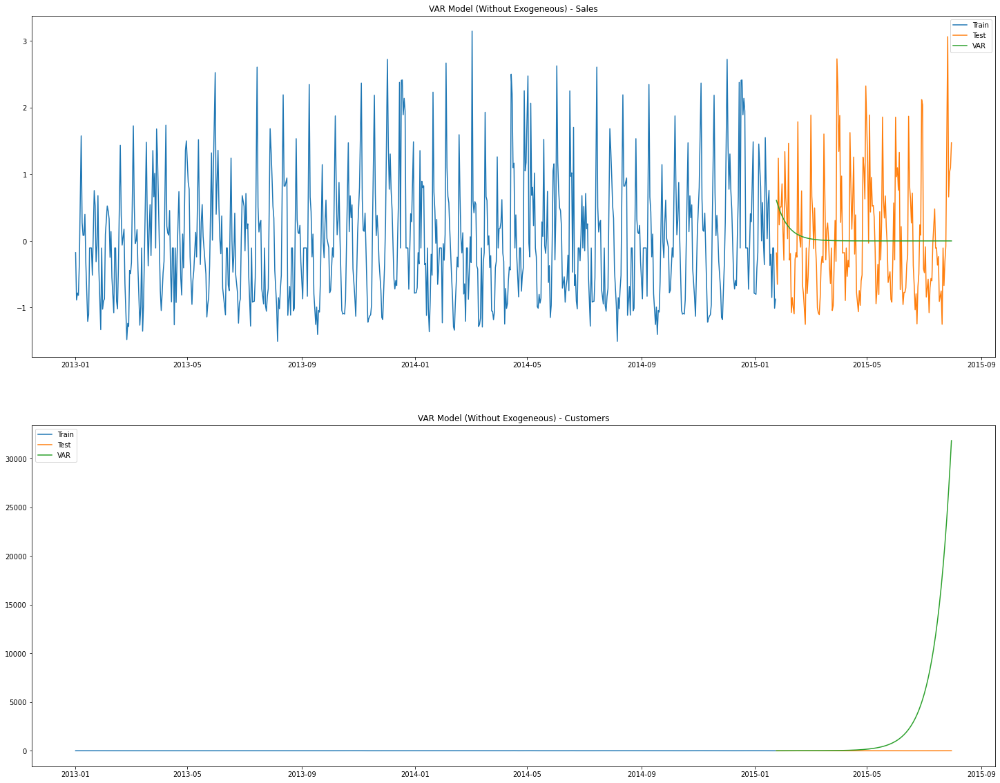

In [162]:
store_id_46_without_exog_model , store_id_46_without_exog_res , store_id_46_without_exog_pred  = declare_var_model_without_exogeneous_variable(store_id_46_train , store_id_46_test  , ['dlnSales','dlnCustomers'],'c')
store_id_46_without_exog_pred = add_prediction_values(store_id_46_without_exog_pred,store_id_46_train , store_id_46_test,(752,12),(752,13))
plot_graph(store_id_46_train , store_id_46_test , store_id_46_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)')

In [163]:
store_id_46_var_model_performace_matrix = map_performace_matrix(store_id_46_test , store_id_46_without_exog_pred , ['Sales','Customers'] , 'VAR Model (Without Exogeneous)', "Store 46")
display(store_id_46_var_model_performace_matrix)
store_model_dict['Store_46_VAR_Without_Exog'] = StoreModel(store_id_46_without_exog_model , store_id_46_var_model_performace_matrix)

[{'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.89,
  'mape': -20.76,
  'store_id': 'Store 46'},
 {'model': 'VAR Model (Without Exogeneous)',
  'variable': 'Customers',
  'rmse': 6998.55,
  'mape': 492544.08,
  'store_id': 'Store 46'}]

### Now lets predict sales for next six weeks 

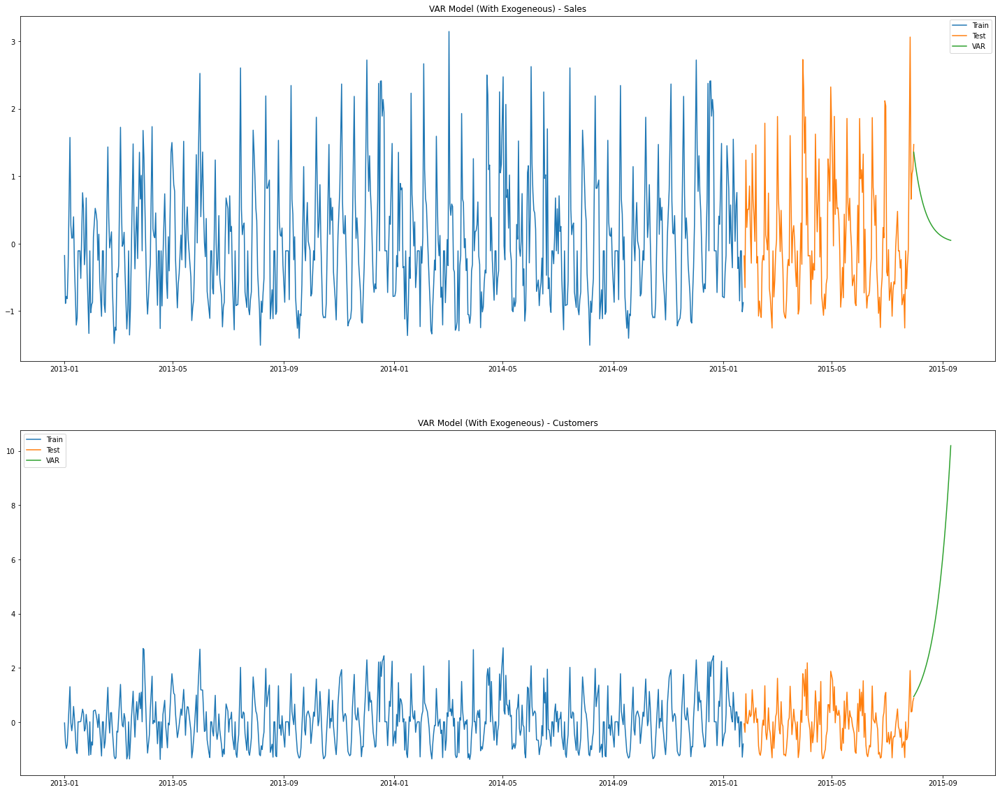

In [164]:
store_46_next_six_weeks = pd.date_range(store_id_46_test.index.max(), periods=42)
store_46_next_six_weeks_prediction = store_id_46_without_exog_model.fit().predict(start=store_46_next_six_weeks.min(), end=store_46_next_six_weeks.max())
store_46_next_six_weeks_prediction = add_prediction_values_future(store_46_next_six_weeks_prediction , store_46_next_six_weeks , store_id_46_test , (188,12),(188,13))
plot_graph(store_id_46_train , store_id_46_test , store_46_next_six_weeks_prediction , ['Sales','Customers'] , 'VAR Model (With Exogeneous)')

In [165]:
joh_model_store_46_var = coint_johansen(store_id_46_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_46_var)

   max_eig_stat  trace_stat
0    313.600518  410.040985
1     96.440467   96.440467 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



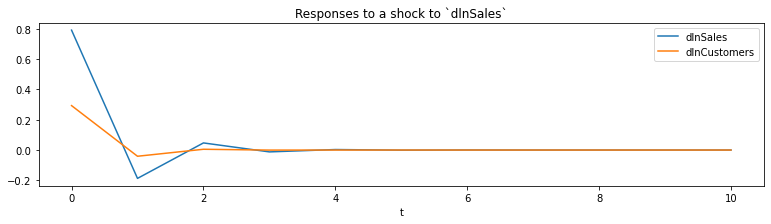

In [166]:
ax = store_id_46_without_exog_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

### We are done with VAR model for Sales and Customers for Store 46

### Now lets prepare using VARMAX model

In [167]:
store_id_46_train.corr()[['dlnSales','dlnCustomers']]

,dlnSales,dlnCustomers
DayOfWeek,0.005202,-0.010187
Sales,0.212961,0.203311
Customers,0.212400,0.209506
Promo,-0.027046,0.016520
SchoolHoliday,-0.007206,0.031100
Year,-0.008104,-0.022321
Month,0.039677,0.060968
Day,0.032670,0.097775
WeekOfYear,0.028434,0.059143
Is_Promo_Month,-0.038661,0.023880


In [168]:

store_id_46_train['Day'] = store_id_46_train.index.day
store_id_46_test['Day'] = store_id_46_test.index.day
store_id_46_train['DayOfWeek'] = store_id_46_train.index.dayofweek
store_id_46_test['DayOfWeek'] = store_id_46_test.index.dayofweek

                                Statespace Model Results                                
Dep. Variable:     ['dlnSales', 'dlnCustomers']   No. Observations:                  753
Model:                              VARMAX(1,1)   Log Likelihood               -1715.420
                                    + intercept   AIC                           3464.840
Date:                          Sun, 18 Apr 2021   BIC                           3543.449
Time:                                  13:40:30   HQIC                          3495.124
Sample:                              01-01-2013                                         
                                   - 01-23-2015                                         
Covariance Type:                            opg                                         
Ljung-Box (L1) (Q):             0.03, 0.00   Jarque-Bera (JB):     5551.75, 2829.47
Prob(Q):                        0.85, 0.96   Prob(JB):                   0.00, 0.00
Heteroskedasticity (H):        

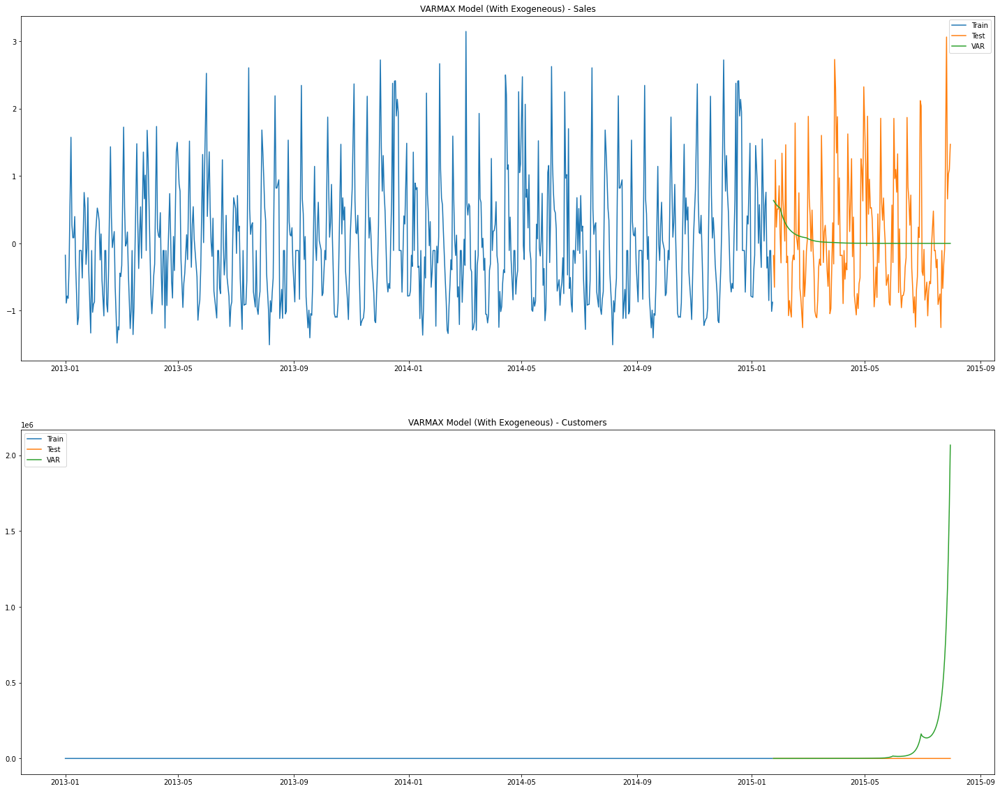

In [169]:
store_id_46_varmax_model , store_id_46_varmax_res , store_id_46_varmax_pred  = varmax_model(store_id_46_train , store_id_46_test  , ['dlnSales','dlnCustomers'],['Day'],'ct')
store_id_46_varmax_pred = add_prediction_values(store_id_46_varmax_pred,store_id_46_train , store_id_46_test,(752,12),(752,13))
plot_graph(store_id_46_train , store_id_46_test , store_id_46_varmax_pred , ['Sales','Customers'] , 'VARMAX Model (With Exogeneous)')

In [170]:
store_id_46_performace_matrix = map_performace_matrix(store_id_46_test , store_id_46_varmax_pred , ['Sales','Customers'] , 'VARMAX Model(With Exogeneous)', "Store 46")
display(store_id_46_performace_matrix)
store_model_dict['Store_46_VARMAX_With_Exog'] = StoreModel(store_id_46_varmax_model , store_id_46_performace_matrix)

[{'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Sales',
  'rmse': 0.89,
  'mape': -21.93,
  'store_id': 'Store 46'},
 {'model': 'VARMAX Model(With Exogeneous)',
  'variable': 'Customers',
  'rmse': 269856.76,
  'mape': 15553802.09,
  'store_id': 'Store 46'}]

In [171]:
joh_model_store_46_var = coint_johansen(store_id_46_train[['lnCustomers','lnSales']],-1,1) # k_ar_diff +1 = K
joh_output(joh_model_store_46_var)

   max_eig_stat  trace_stat
0    313.600518  410.040985
1     96.440467   96.440467 

Critical values(90%, 95%, 99%) of max_eig_stat
 [[ 9.4748 11.2246 15.0923]
 [ 2.9762  4.1296  6.9406]] 

Critical values(90%, 95%, 99%) of trace_stat
 [[10.4741 12.3212 16.364 ]
 [ 2.9762  4.1296  6.9406]] 



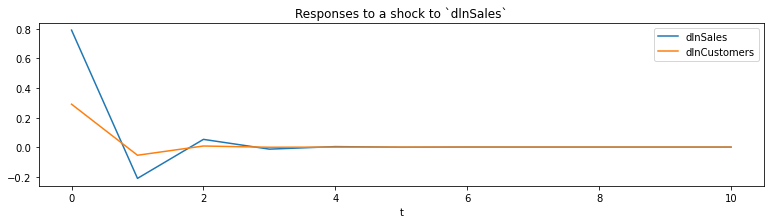

In [172]:
ax = store_id_46_varmax_res.impulse_responses(10, orthogonalized=True).plot(figsize=(13,3))
ax.set(xlabel='t', title='Responses to a shock to `dlnSales`');

In [173]:
performance_matrix = []
for i , j in store_model_dict.items():
    performance_matrix.extend(j.performace_matrix)
    
performance_matrix = pd.DataFrame(performance_matrix)
performance_matrix

,model,variable,rmse,mape,store_id
0,VAR Model (Without Exogeneous),Sales,1.00,-438.92,Store 1
1,VAR Model (Without Exogeneous),Customers,1.05,-256.96,Store 1
2,VARMAX Model(With Exogeneous),Sales,0.72,-139.91,Store 1
3,VARMAX Model(With Exogeneous),Customers,1.16,-318.20,Store 1
4,VAR Model (Without Exogeneous),Sales,1.13,-214.91,Store 3
5,VAR Model (Without Exogeneous),Customers,1.05,-72.85,Store 3
6,VARMAX Model(With Exogeneous),Sales,0.86,-16.74,Store 3
7,VARMAX Model(With Exogeneous),Customers,0.79,-5.30,Store 3
8,VAR Model (Without Exogeneous),Sales,1.06,16.43,Store 8
9,VAR Model (Without Exogeneous),Customers,1.05,35.49,Store 8
